A notebook for capturing geometric calibration data for the cameras of the OROCHI Simualtor of the Kameda Lab.

Third attempt, using positions that are not parallel with the image planes of the cameras, and taking more care to ensure more postiions are usable.

# Process Overview

The objective of this notebook is to capture iamges of a geometric calibration target with each camera of OROS, with the target held in multiple different poses, so that we can extract the intrinsic and extrinsic camera matrix from each.

This simply means taking images in each camera for the calibration target in various positions.

For this calibration, we will remove the spectral filters, and attempt in this scenario to measure the matrices without them. This means we won't be restricted to using the lamp, and we can instead use low power lighting.

# Camera Setup

Here we configure and setup the camera capture objects.

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import orochi_sim_ctrl as osc

ic = osc.start_ic()
camera_config = osc.load_camera_config()
cameras = osc.connect_cameras(ic, camera_config)
osc.configure_cameras(cameras) # updated bias to 4 DN

Device 0 (DMK 33GX249 10910288) succesfully connected.
Device 1 (DMK 33GX249 10910273) succesfully connected.
Device 2 (DMK 33GX249 10910289) succesfully connected.
Device 3 (DMK 33GX249 10910294) succesfully connected.
Device 4 (DMK 33GX249 10910291) succesfully connected.
Device 5 (DMK 33GX249 10910295) succesfully connected.
Device 7 (DMK 33GX249 23120778) succesfully connected.
Device 6 (DMK 33GX249 10910265) succesfully connected.
-----------------------------------
Device 0 (DMK 33GX249 10910288)
-----------------------------------
1
Video Format set to : Y16 (1920x1200)
1
Sink Format set to : "SinkFormats.Y16"
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Image size: 1920 x 1200 pixels
Image buffer size: 36864000 bytes
Bits per pixel: 2
Color Format: SinkFormats.Y16
Frame Rate: 33
Brightness current Value: 4
Contrast current Value: 0
Sharpness current Value: 0
Gamma current Value: 100
Gain current Value: 4.300000190734863
Gain current Auto: 0


# Set up

In [5]:
n_repeats = 5
date = '08092023'
n_positions = 36

# Image Capture

Here we will neglect dark frame subtraction and simply capture single images of the target for each of 5 calibration target positions.

In [4]:
chkbd_exposures = osc.find_channel_exposures(cameras, roi=False, target=0.8, n_hot = 100, tol=25)

-----------------------------------
Device 0
-----------------------------------
Initiating search:
Trial 0:
Imaging with Exposure: 0.02999899908900261 s
+Good exposure 0.02999899908900261 Image recieved
Quantile: 145.0, Target: 3275.2000000000003
Exposure current Value: 0.02999899908900261
Expected new quantile: 112.93793103448277 x 29.0 = 3275.2000000000003
Exposure set to 3.388024091720581 (err of 7.984967069774029e-07
Trial 1:
Imaging with Exposure: 3.388024091720581 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 3.388024091720581 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Quantile: 4094.0, Target: 3275.2000000000003
Exposure current Value: 3.388024091720581
Expected new quantile: 0.16 x 20470.0 = 3275.2000000000003
Exposure set to 0.5420830249786377 (err of 8.296966552689966e-07
Trial 2:
Imaging with Exposure: 0.5420830249786377 s
Setting Frame Rate to : 1.0 FPS
set frame rate

-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


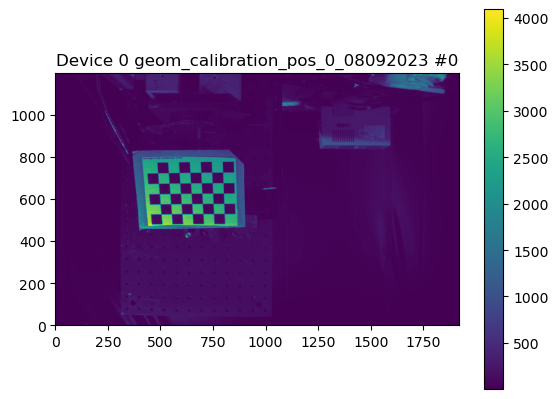

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


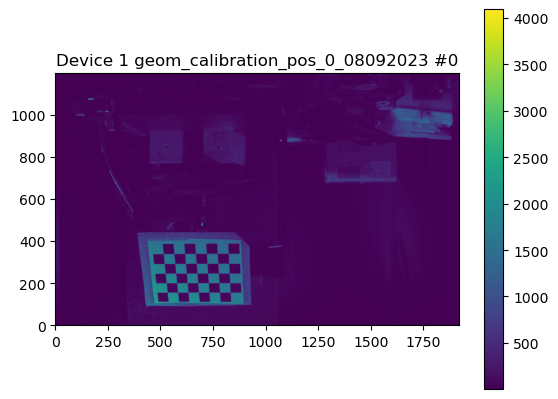

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


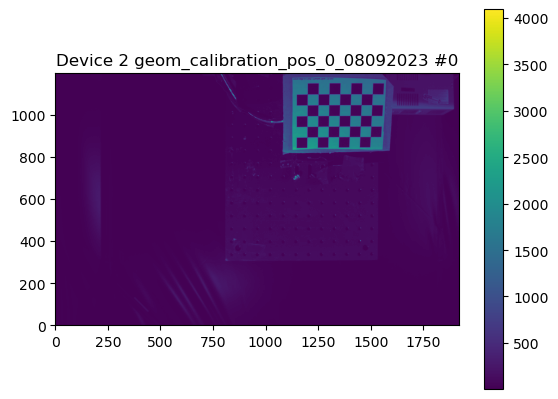

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


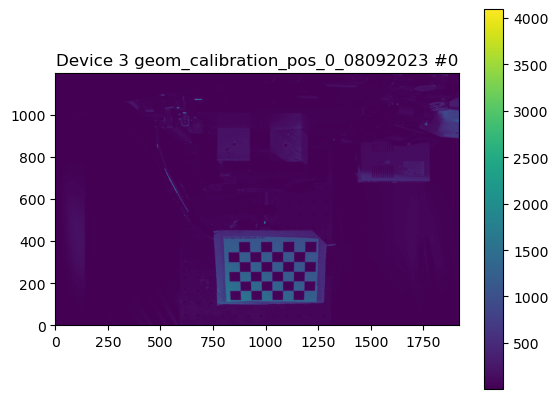

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


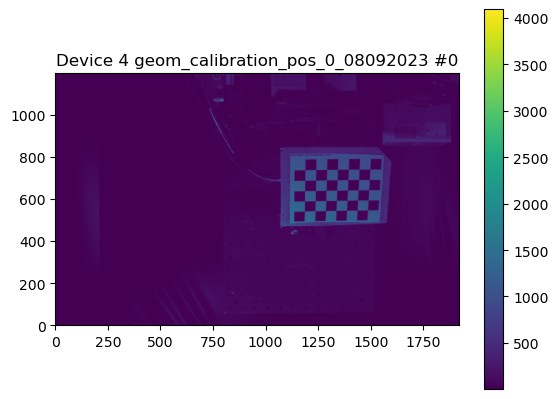

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


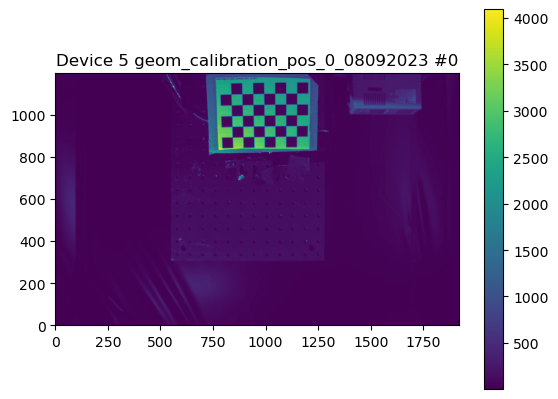

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


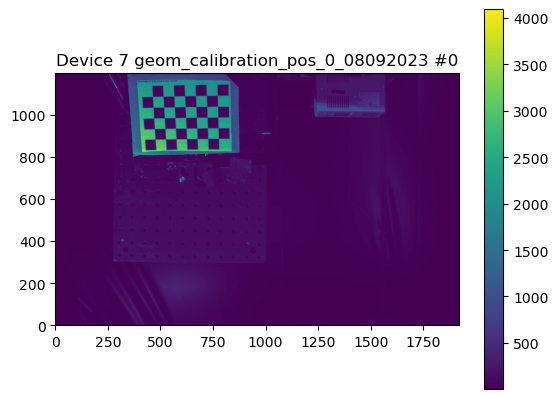

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


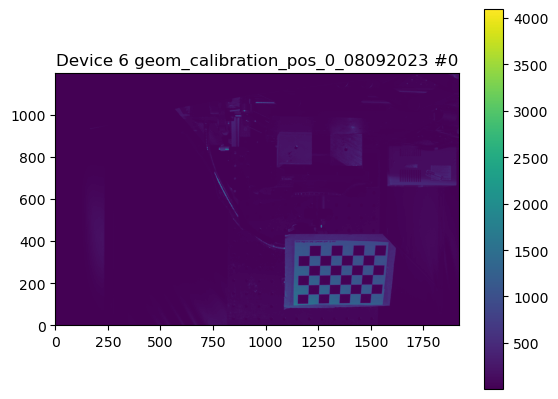

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_0_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_0_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS

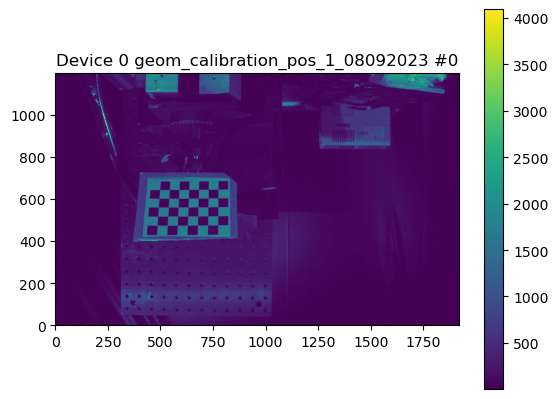

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


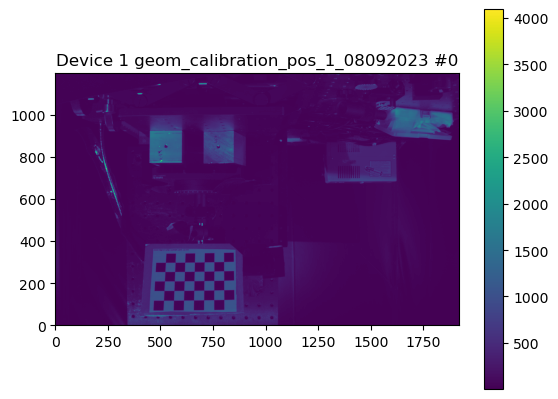

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


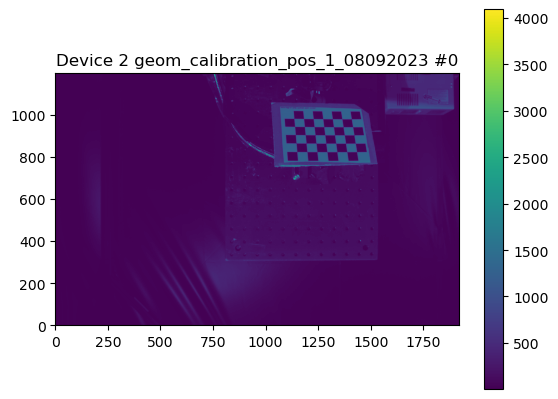

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


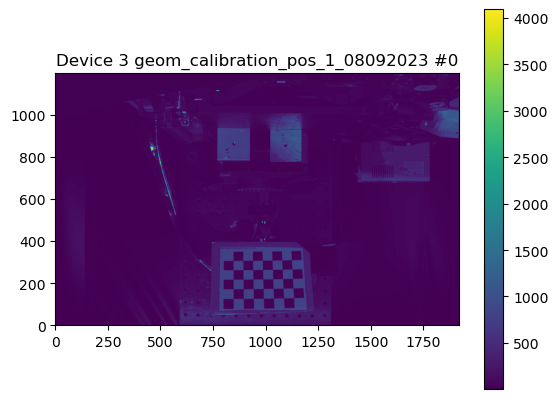

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


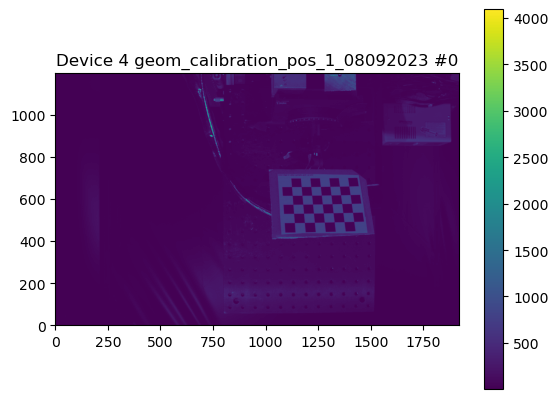

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


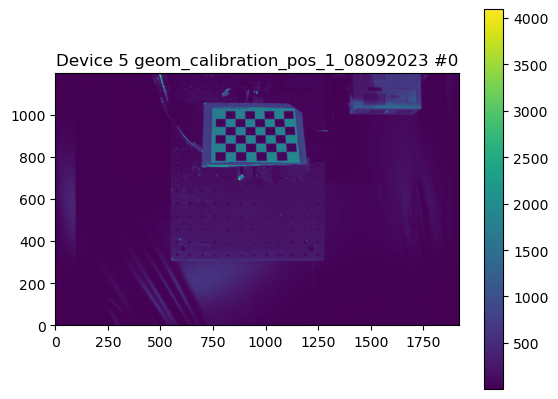

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


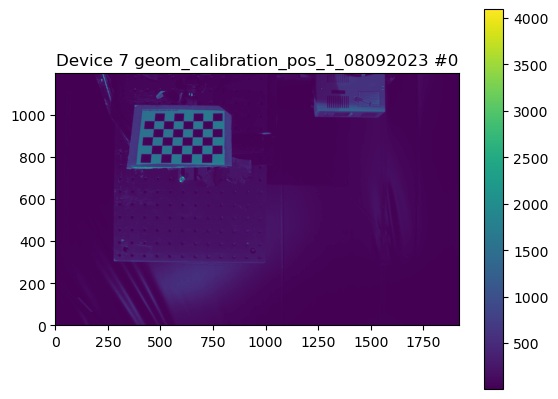

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


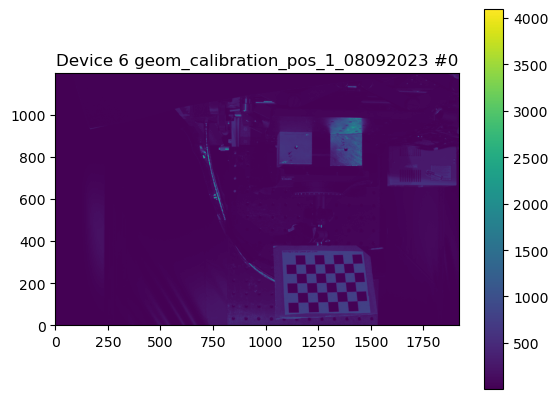

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_1_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_1_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS

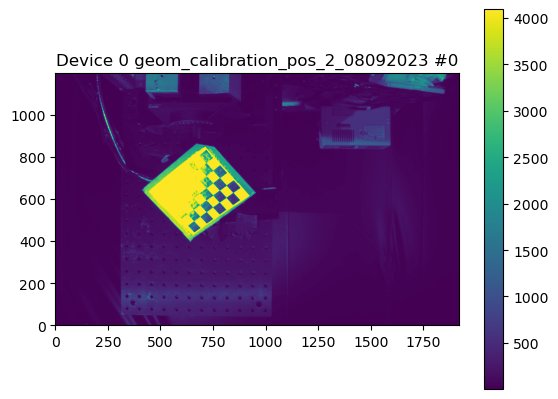

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


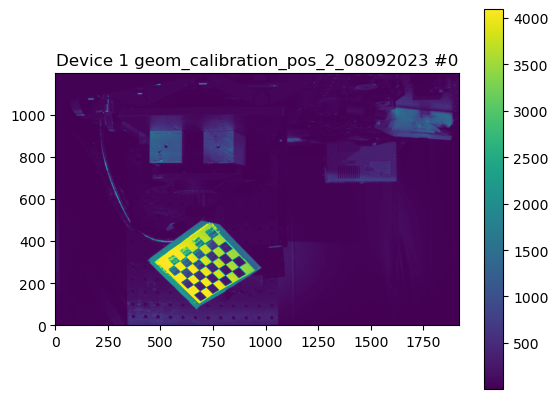

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


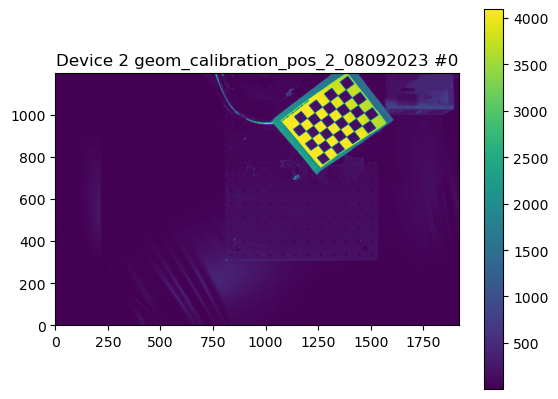

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


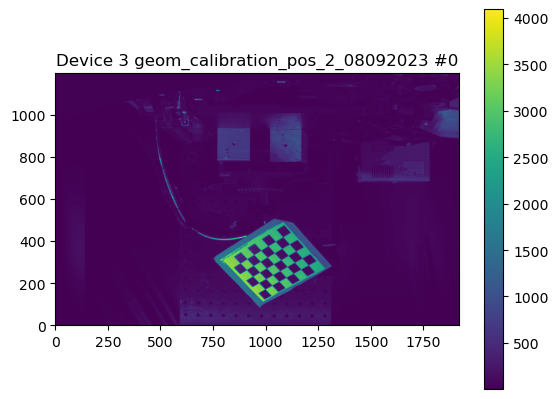

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


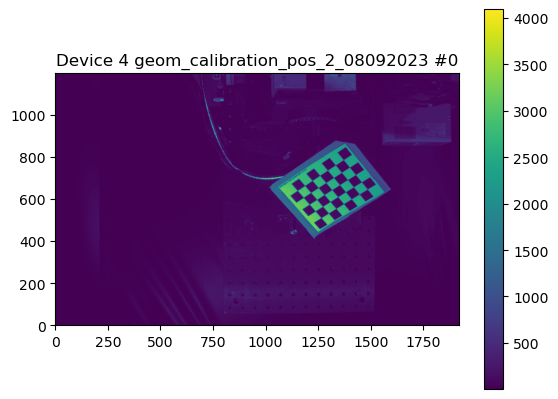

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


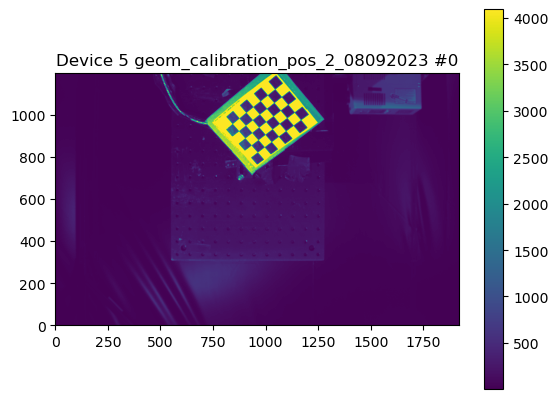

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


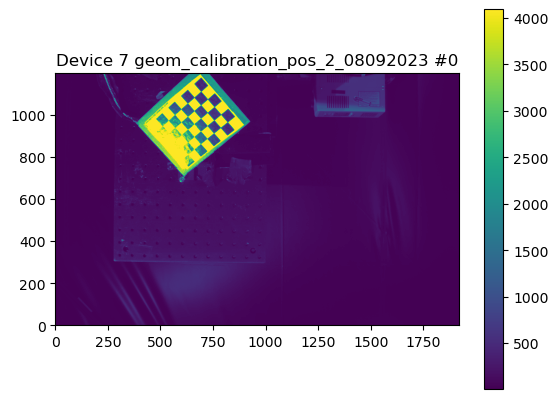

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


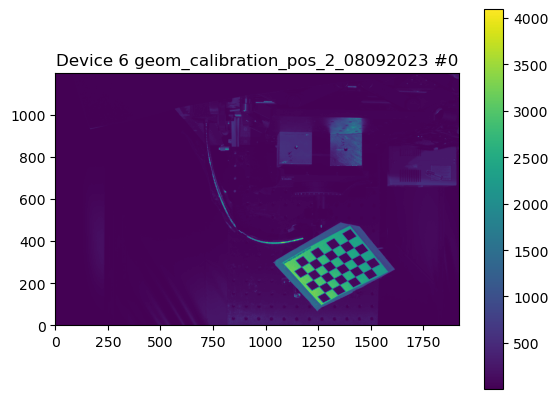

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_2_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_2_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS

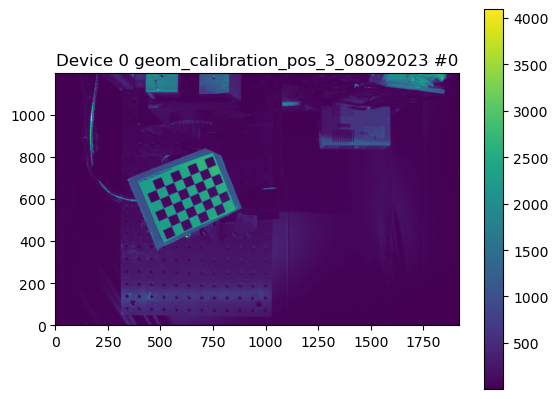

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


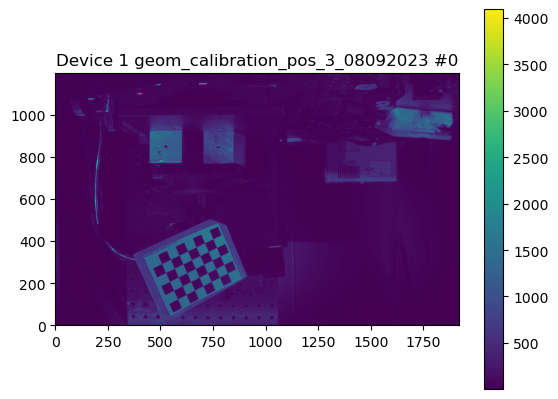

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


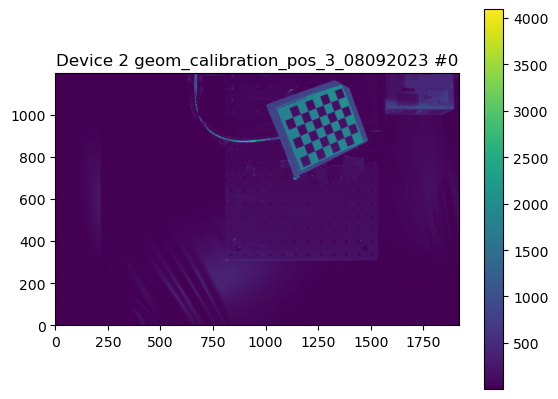

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


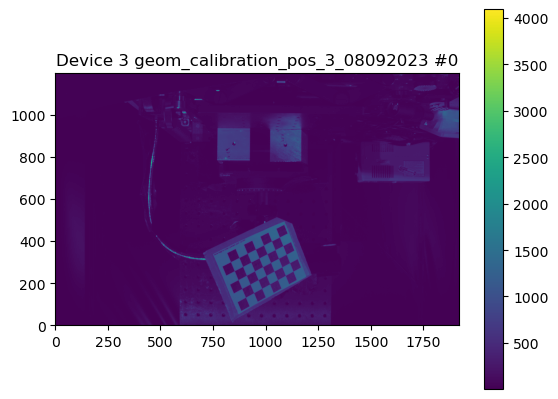

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


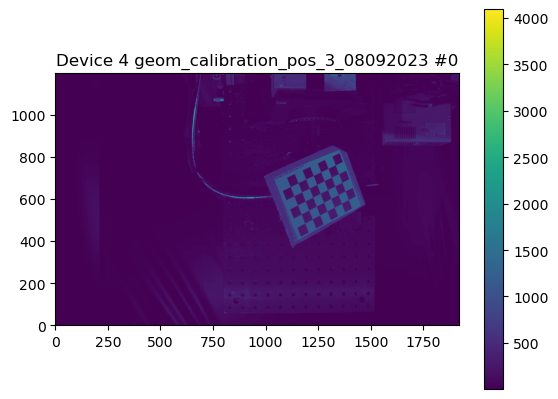

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


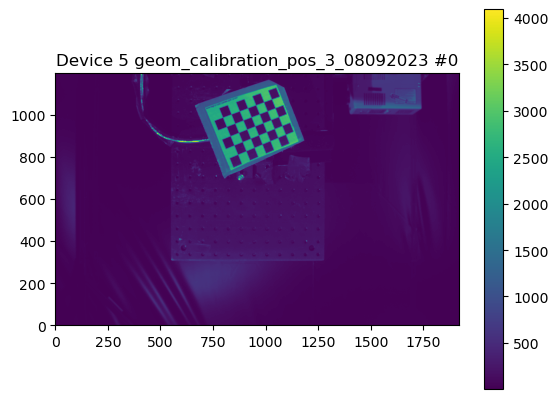

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


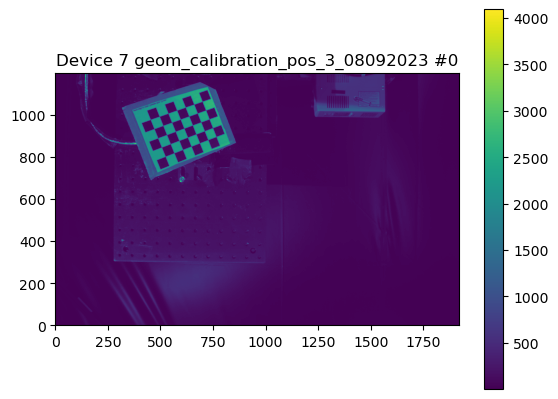

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


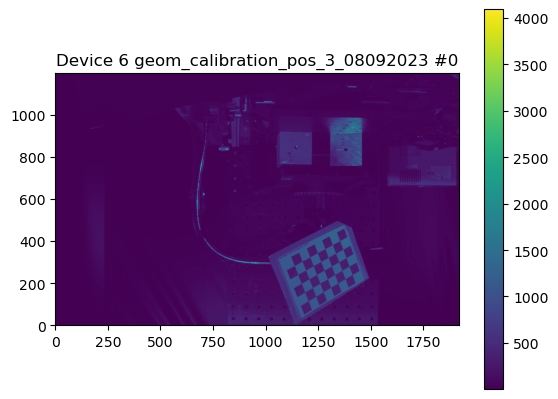

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_3_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_3_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS

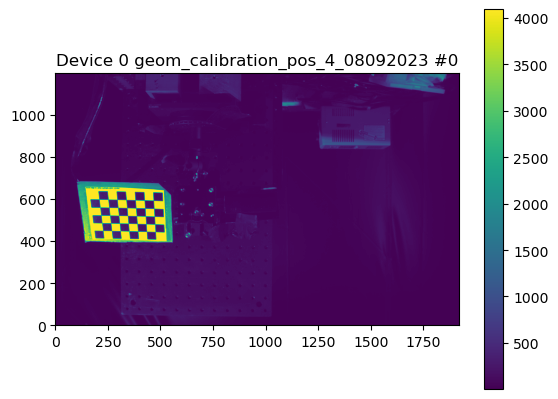

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


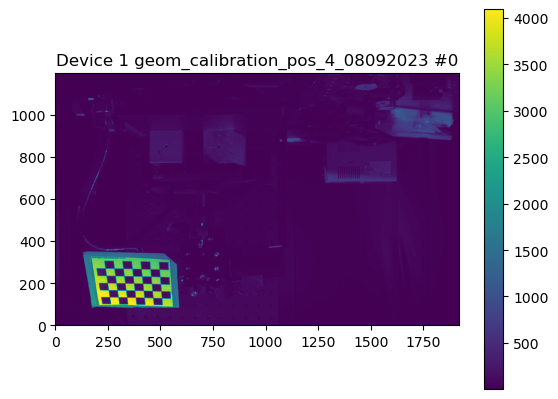

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


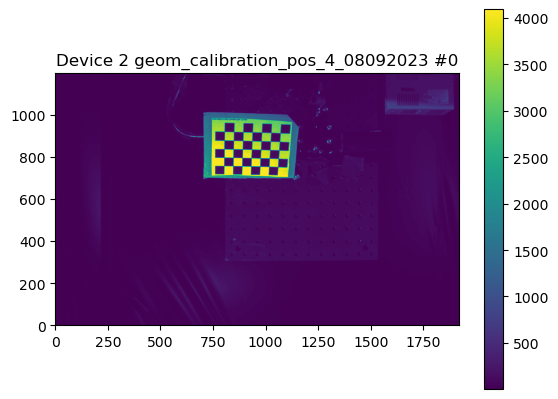

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


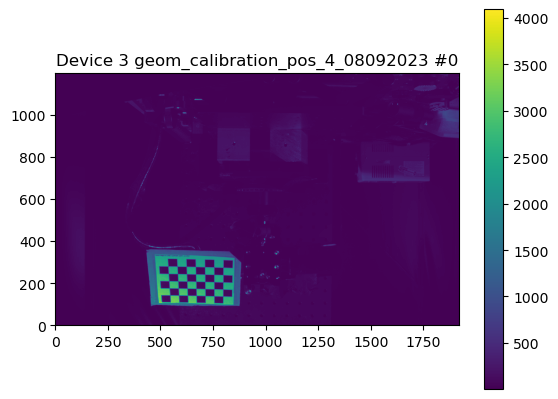

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


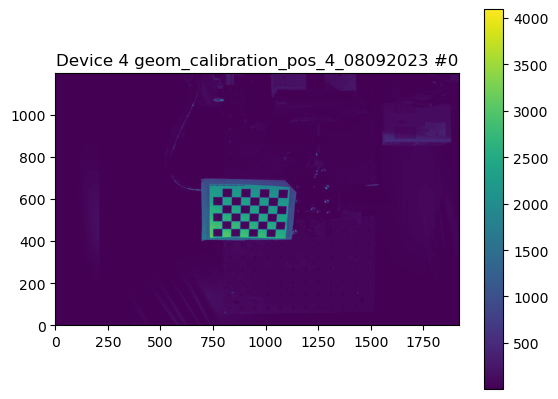

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


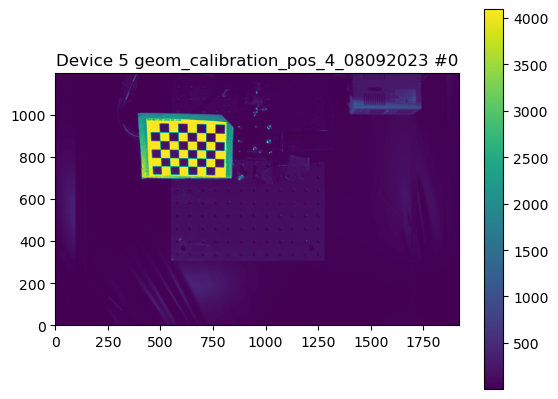

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


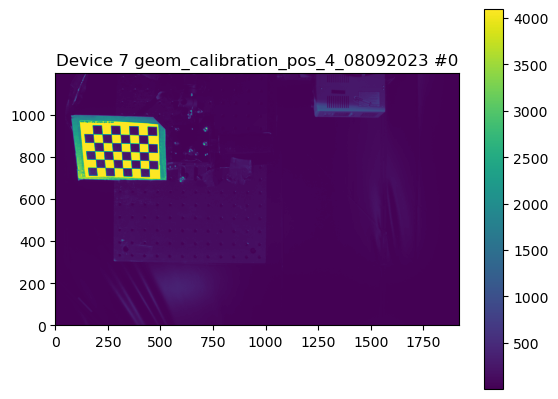

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


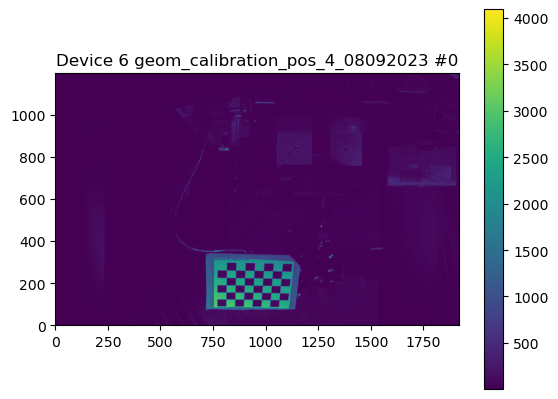

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_4_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_4_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS

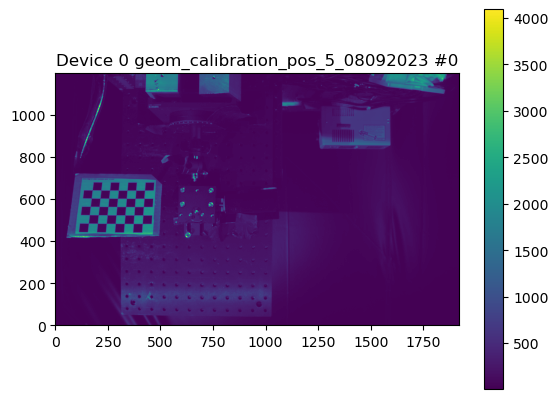

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


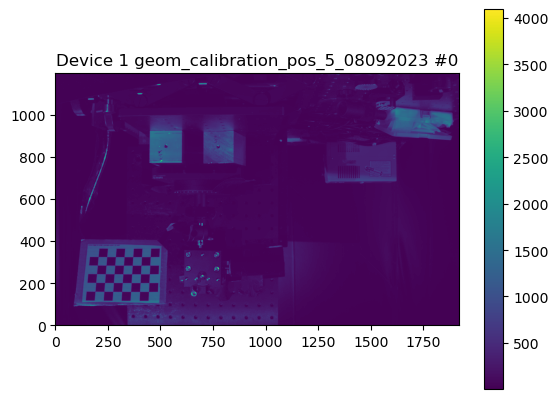

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


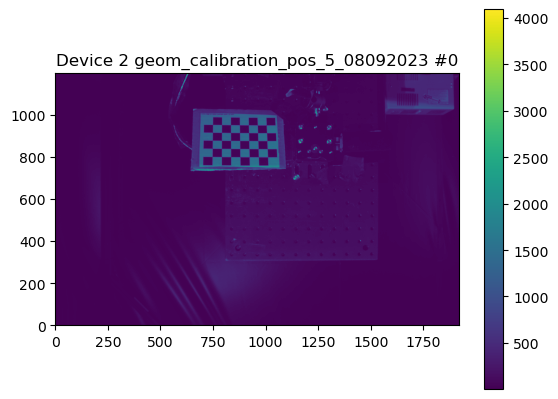

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


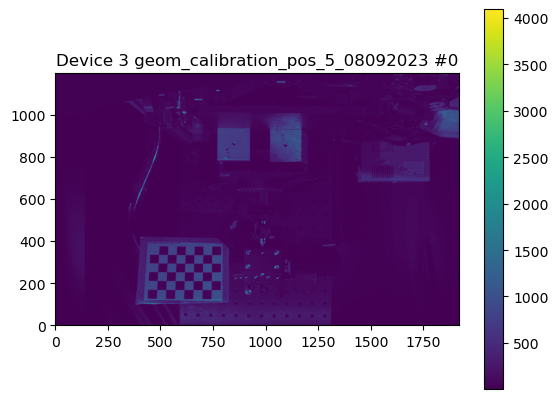

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


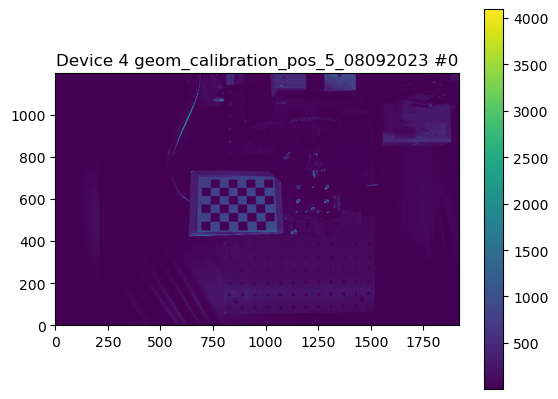

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


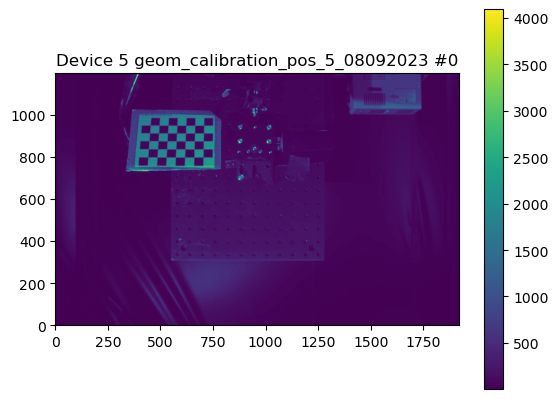

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


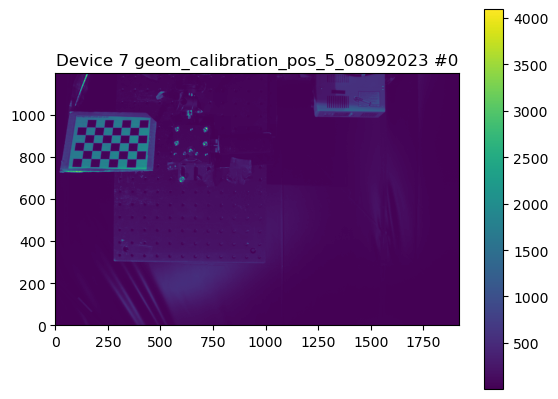

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


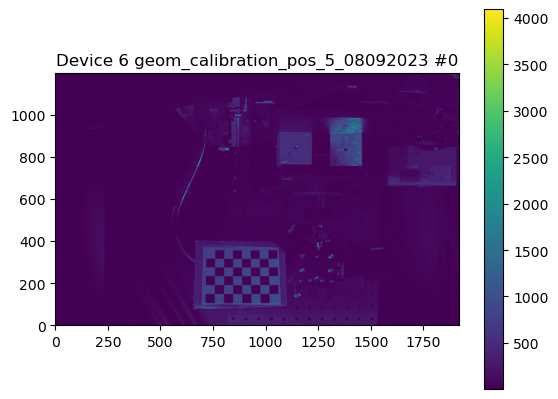

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_5_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_5_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS

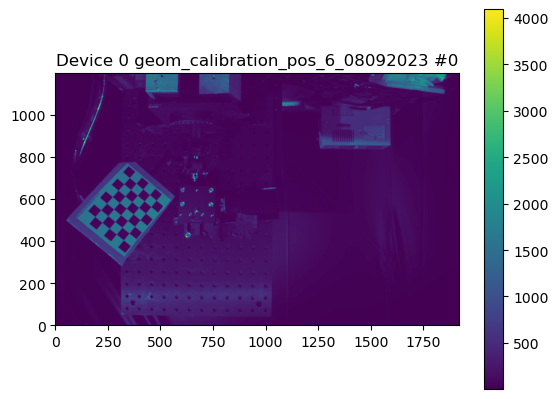

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


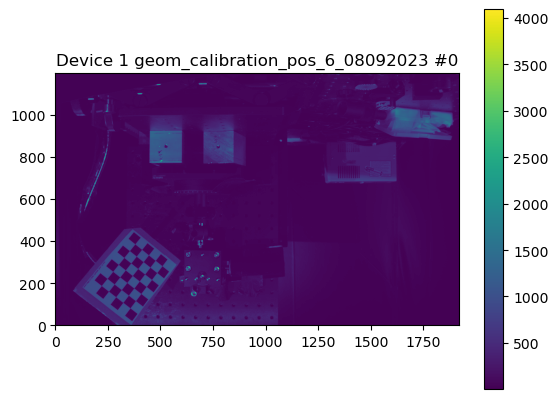

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


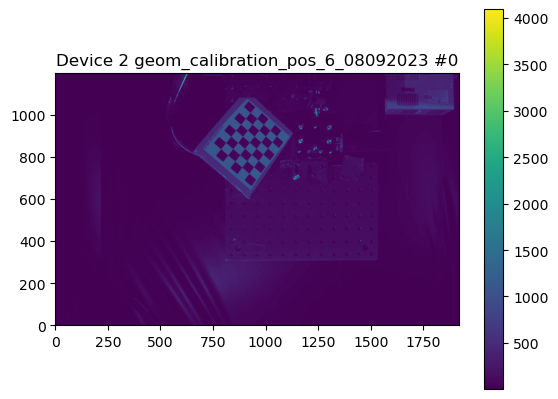

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


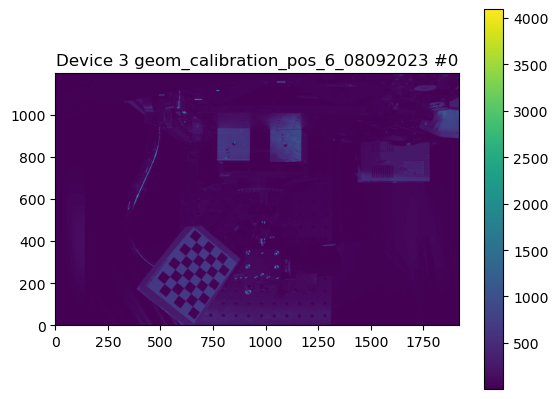

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


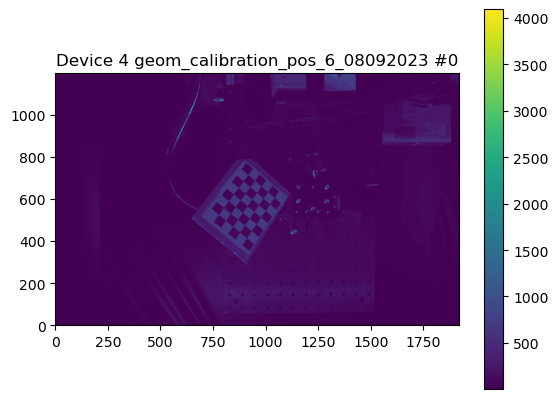

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


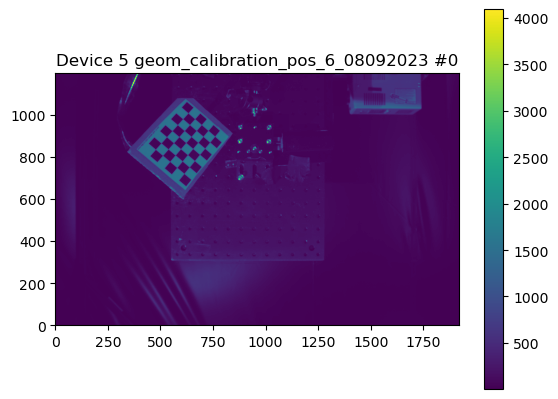

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


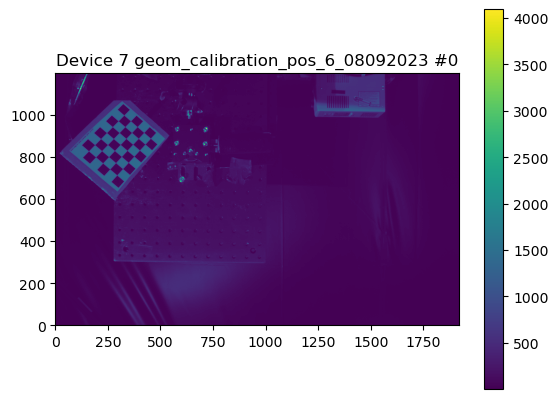

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


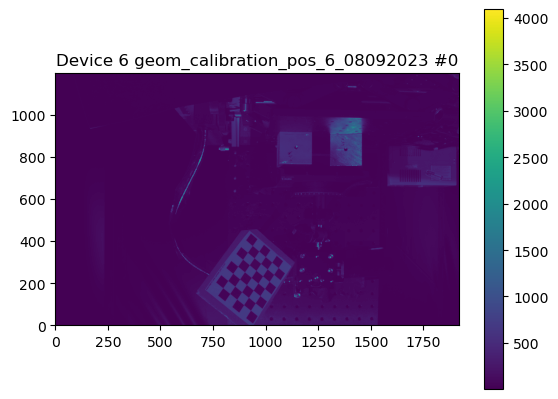

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_6_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_6_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS

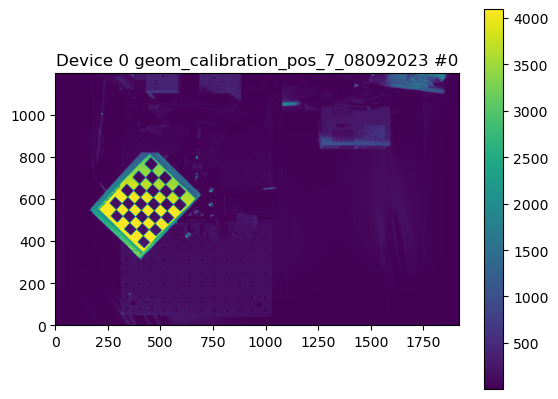

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


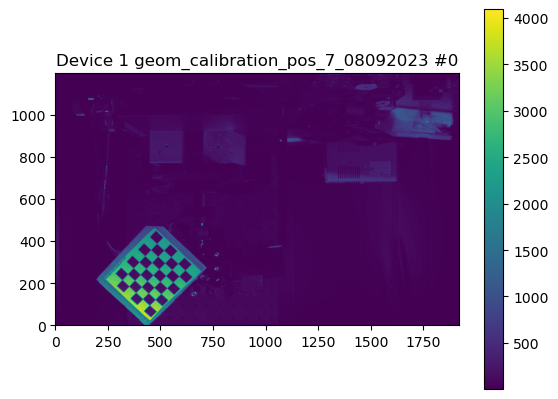

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


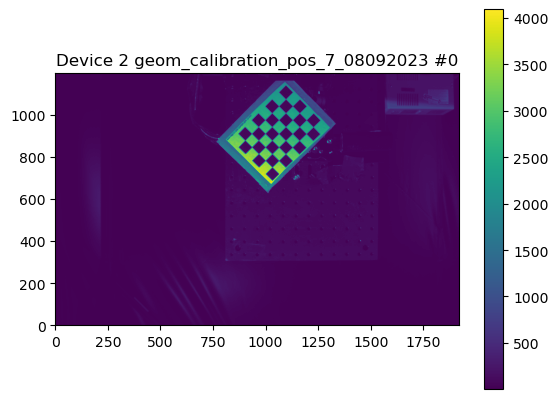

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


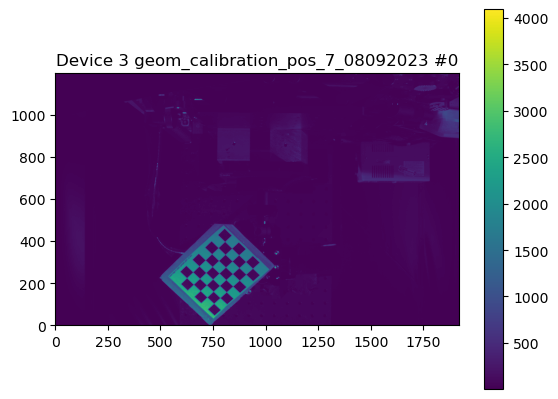

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


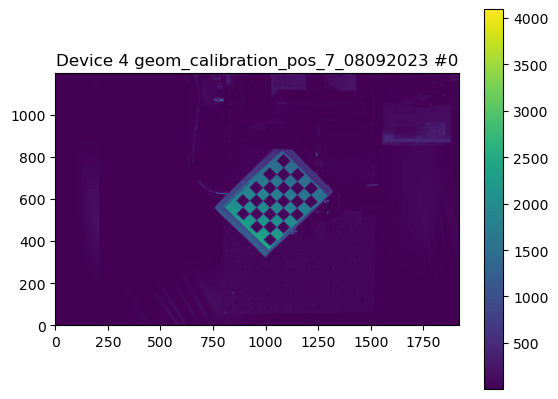

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


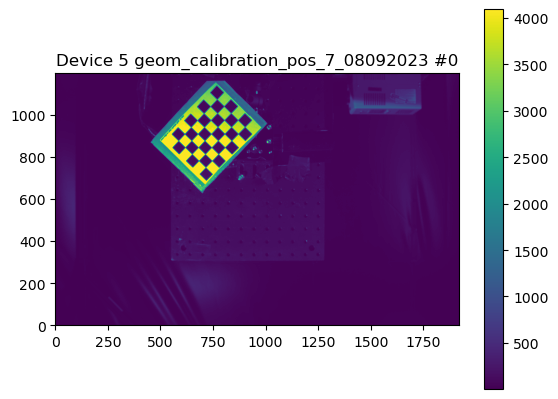

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


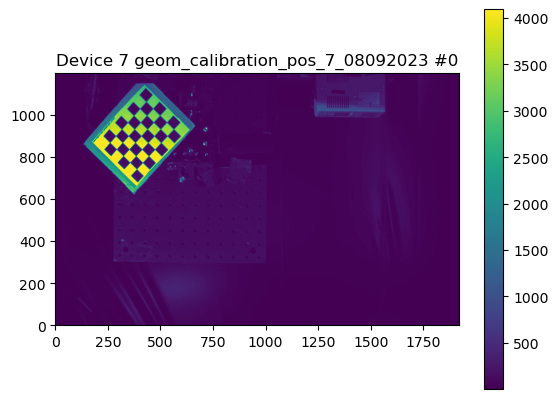

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


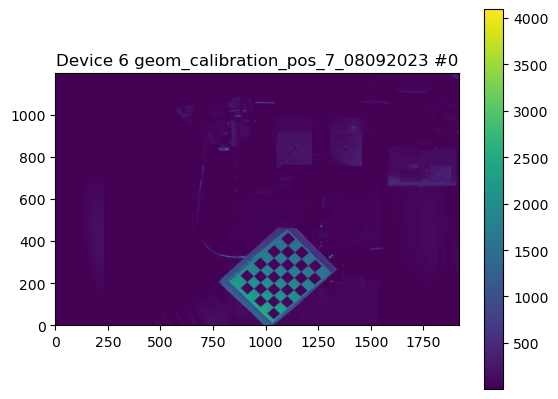

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_7_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_7_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS

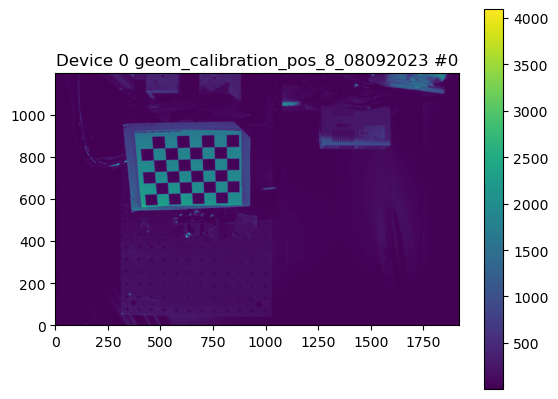

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


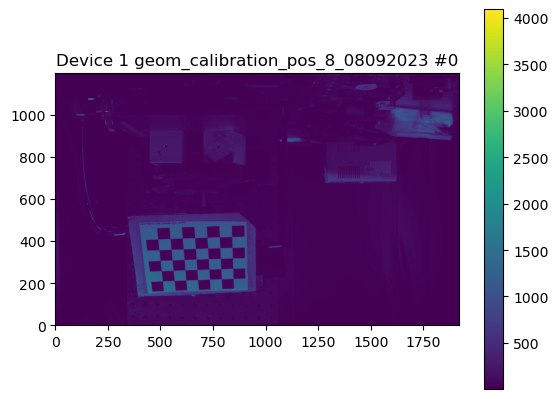

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


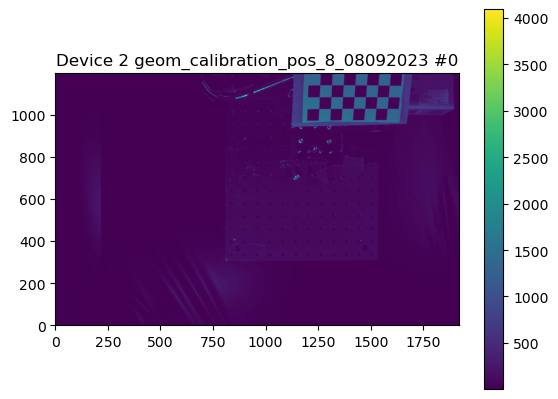

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


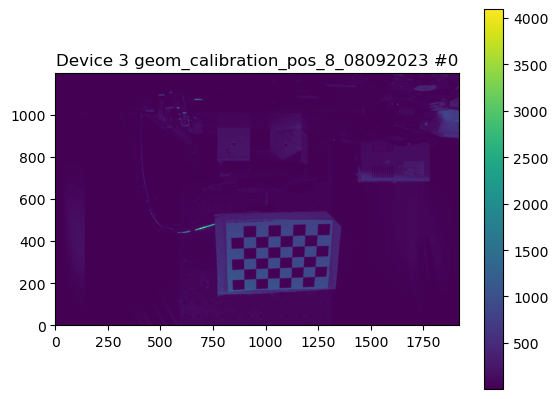

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


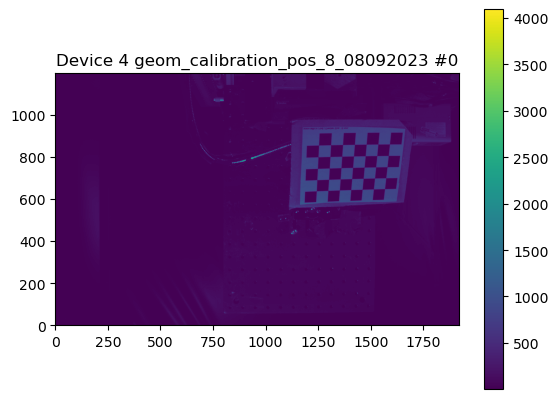

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


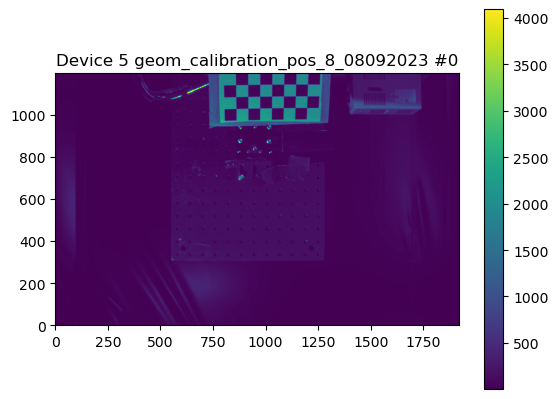

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


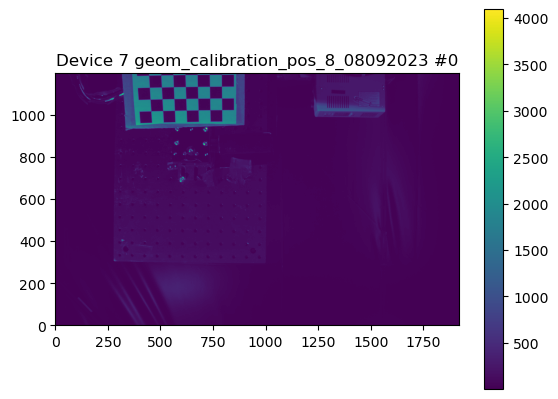

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


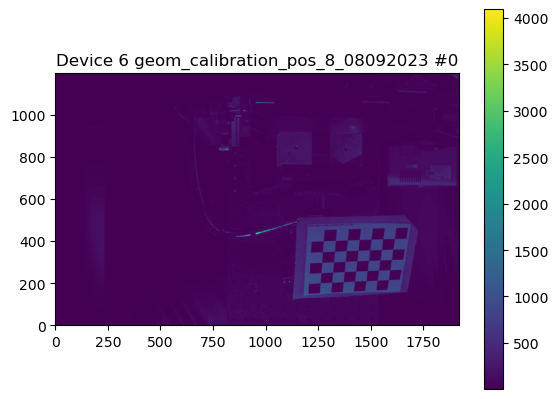

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_8_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_8_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS

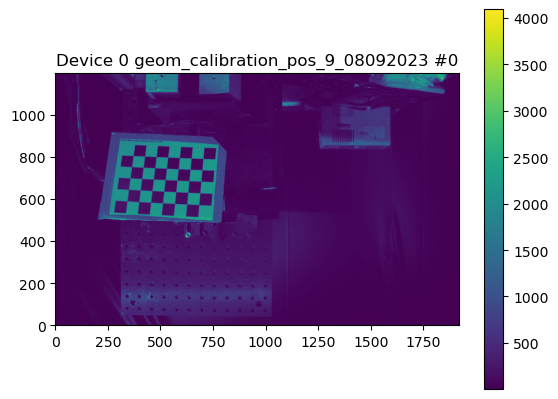

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


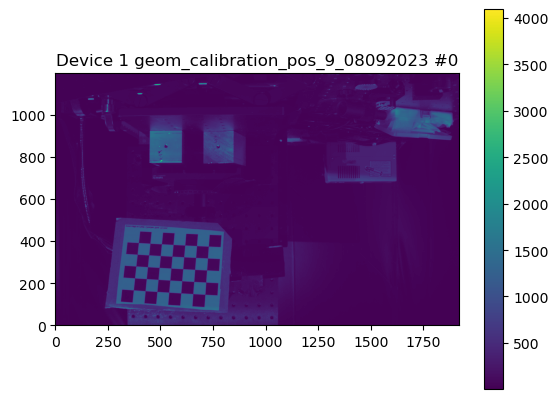

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


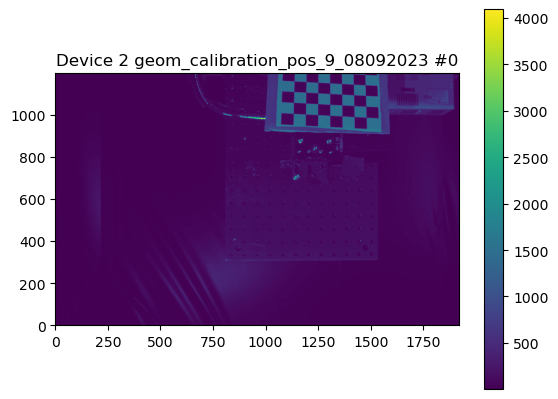

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


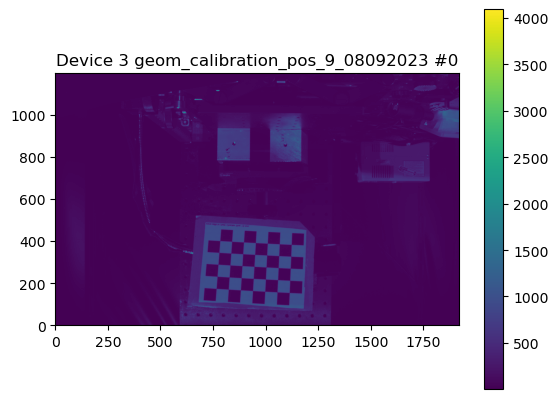

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


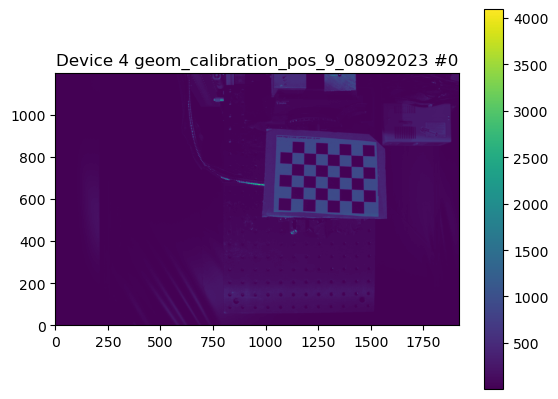

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


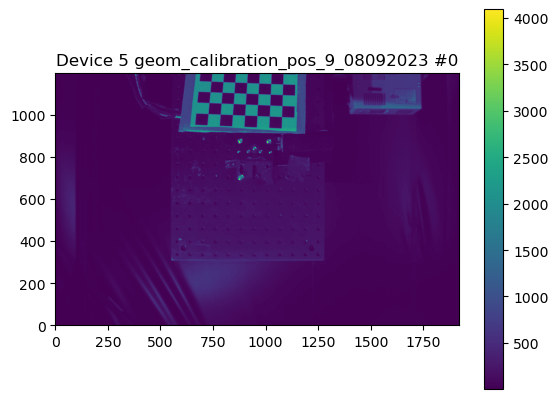

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


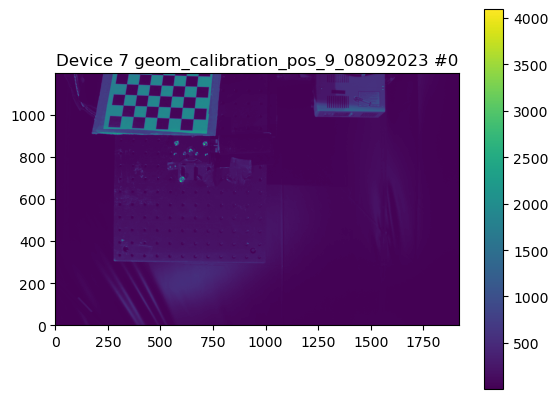

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


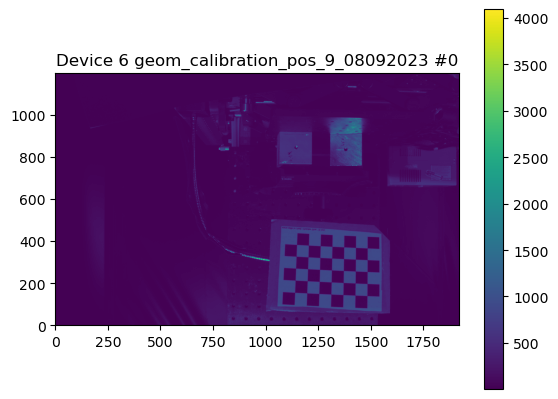

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_9_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_9_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS

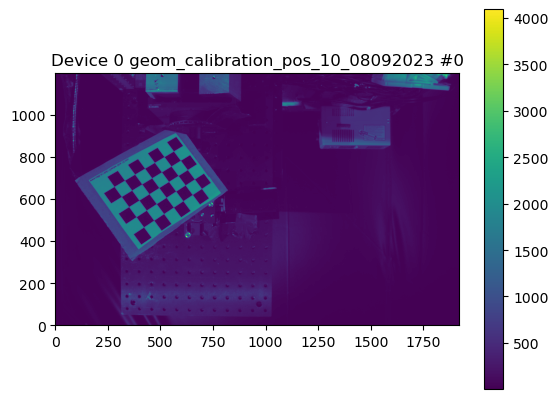

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


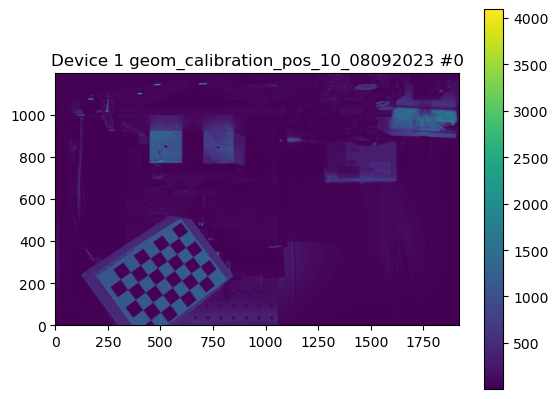

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


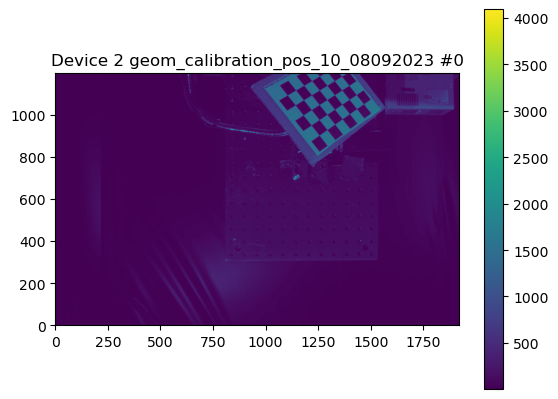

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


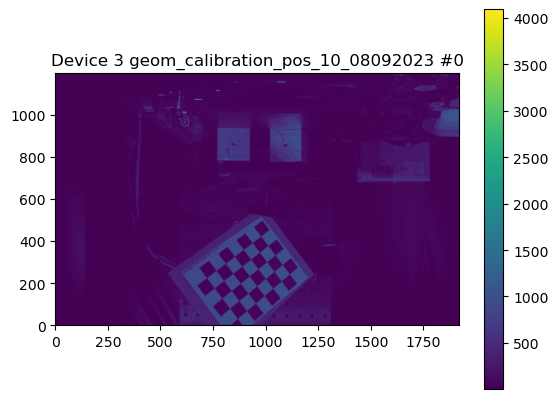

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


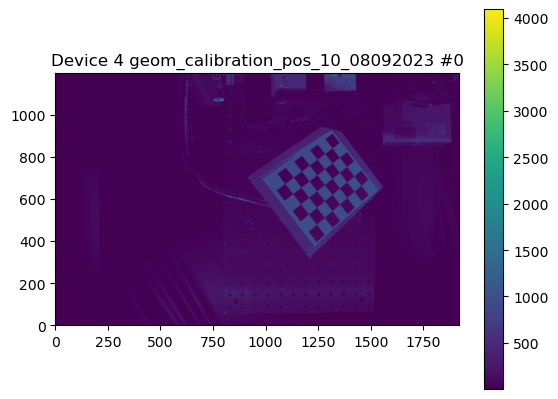

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


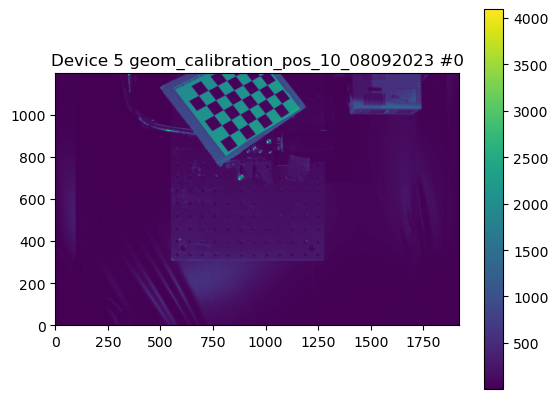

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


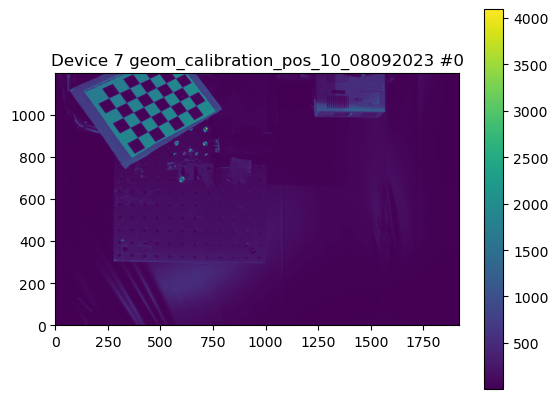

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


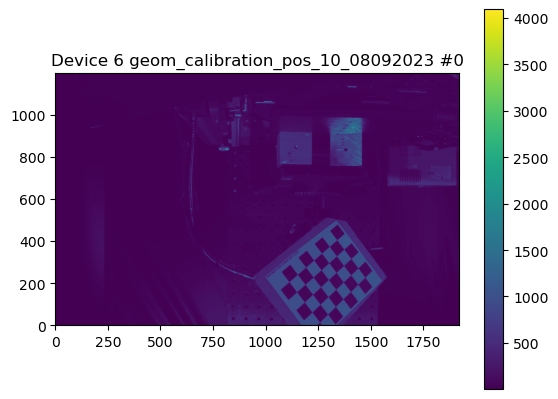

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_10_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_10_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

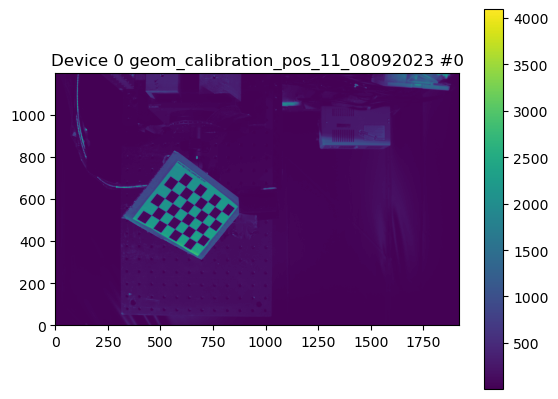

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


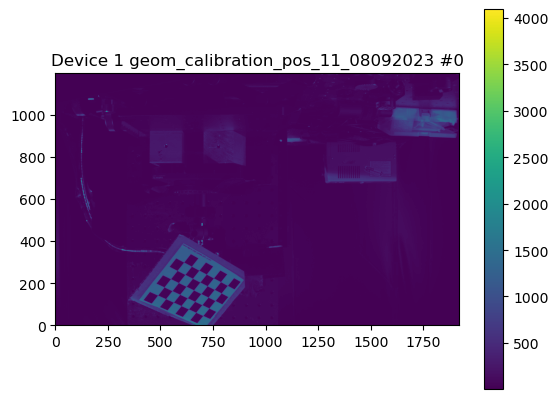

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


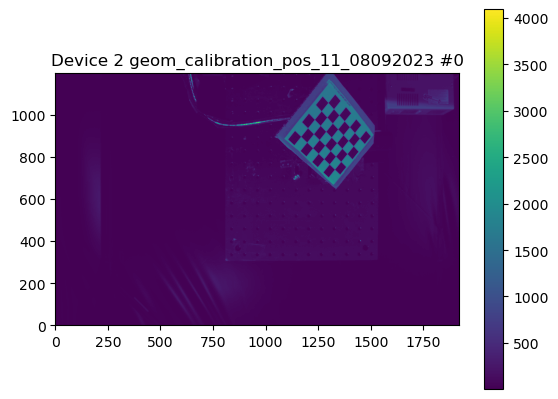

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


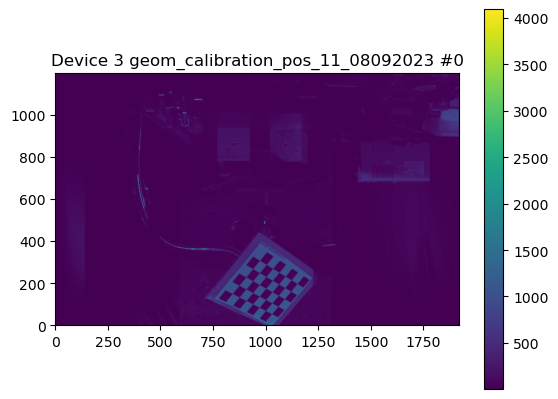

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


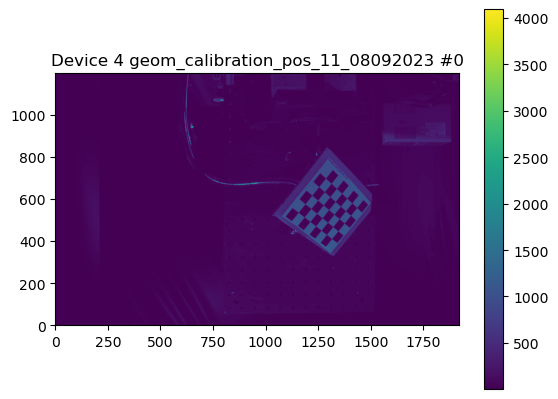

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


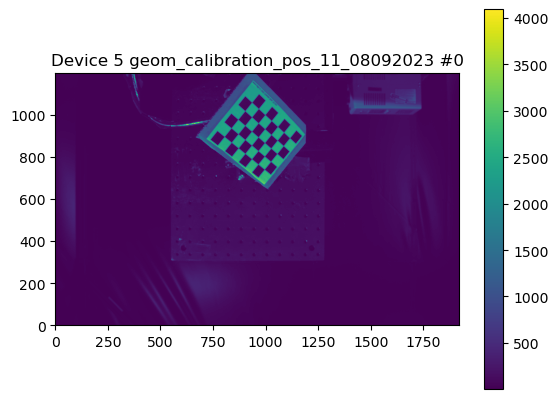

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


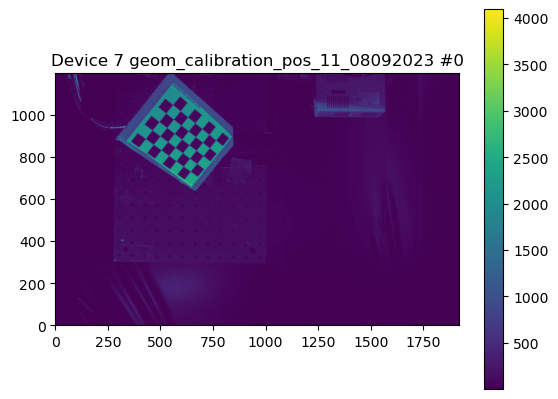

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


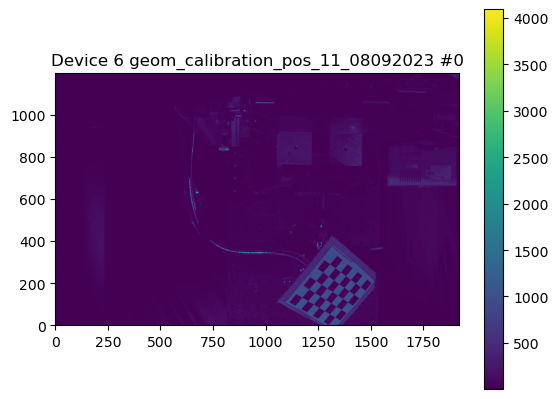

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_11_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_11_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

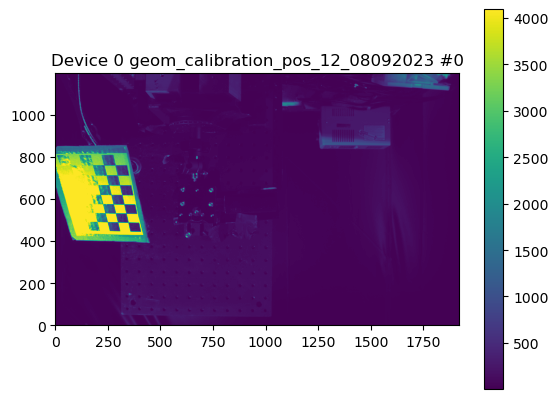

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


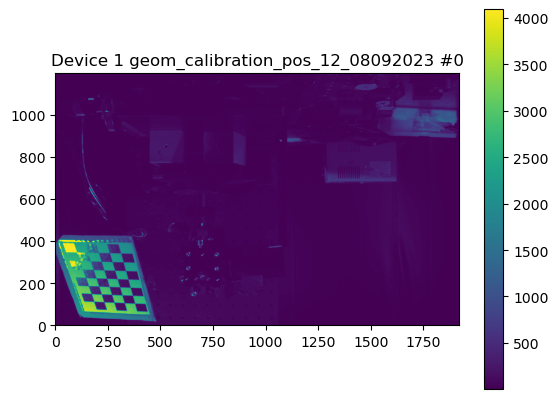

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


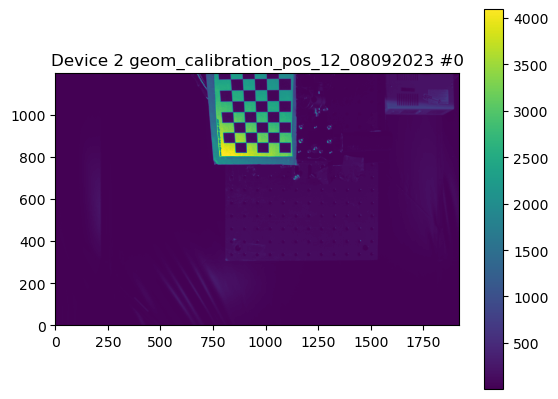

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


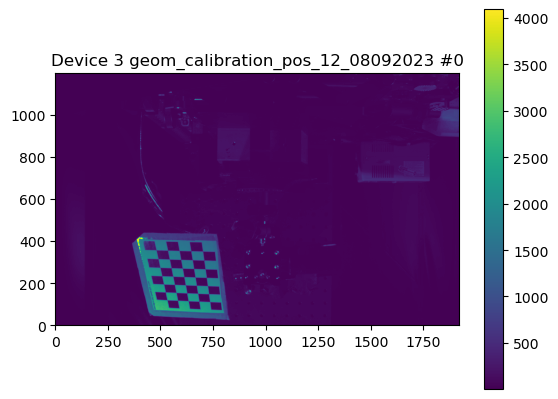

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


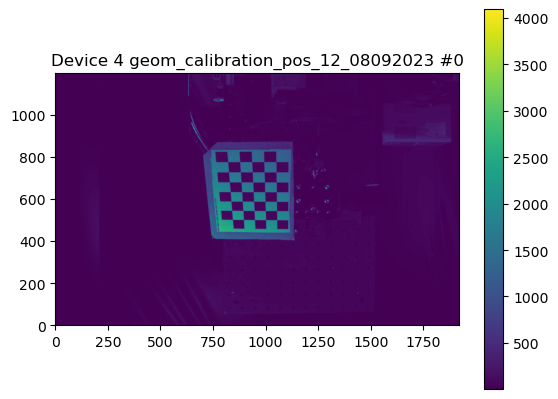

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


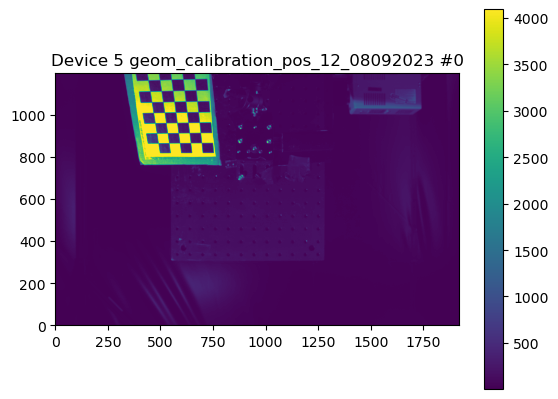

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


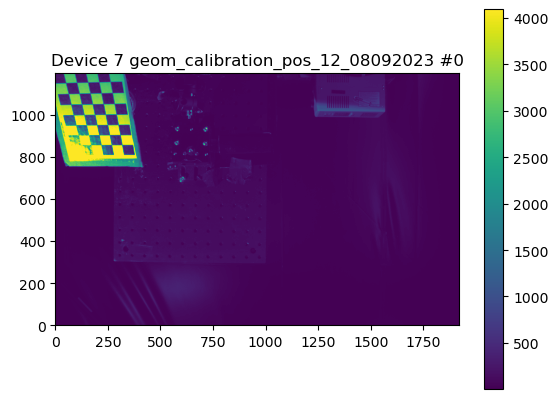

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


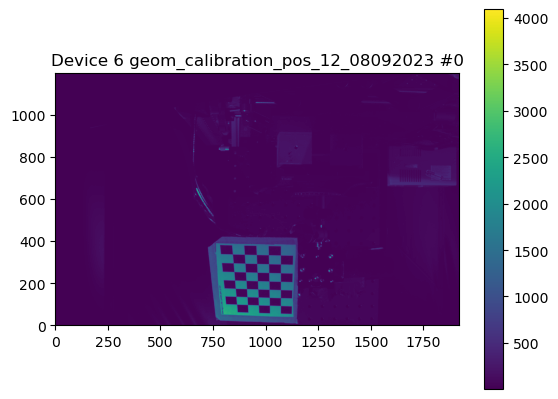

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_12_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_12_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

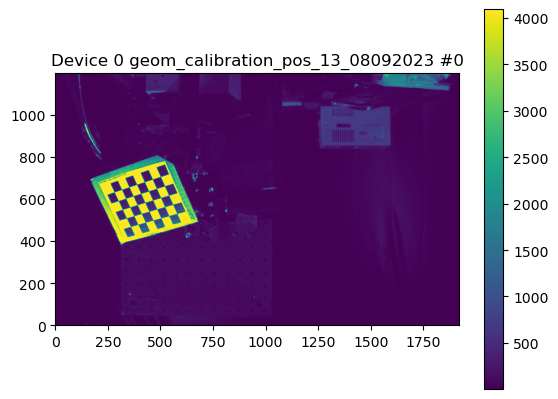

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


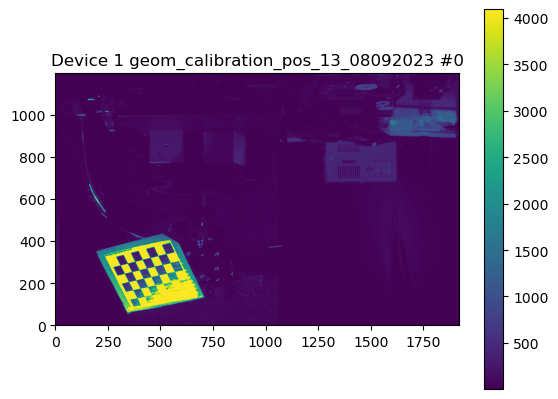

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


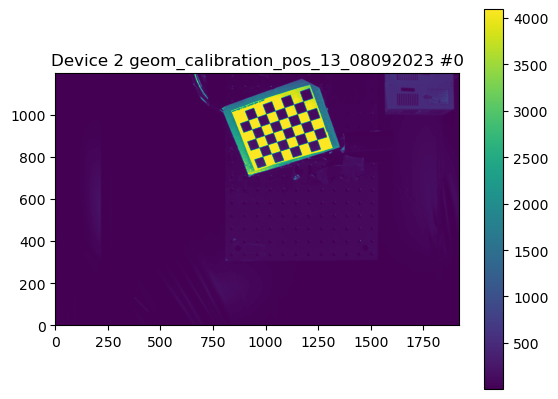

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


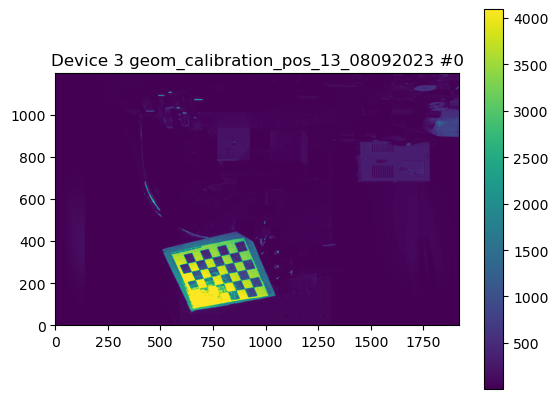

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


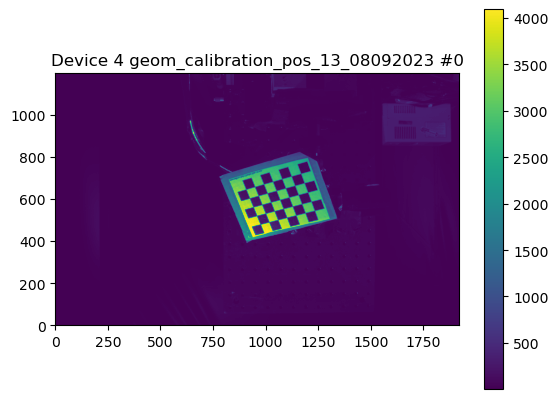

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


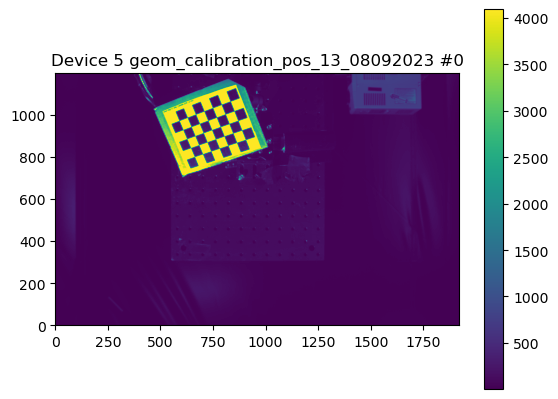

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


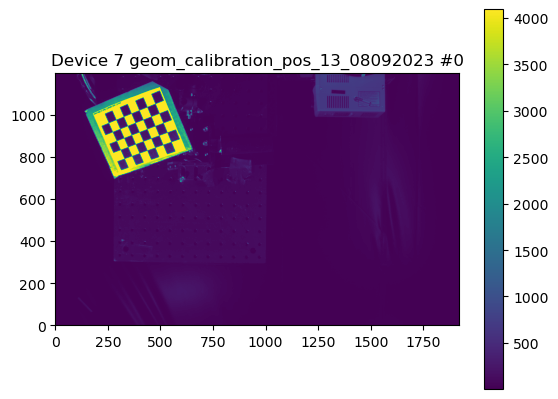

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


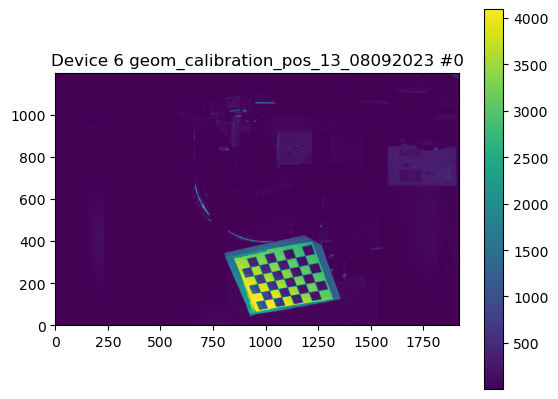

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_13_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_13_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

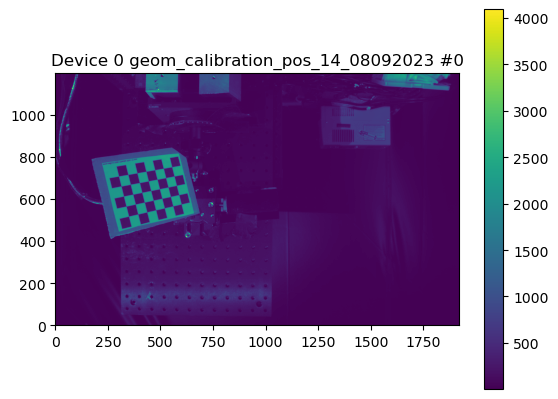

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


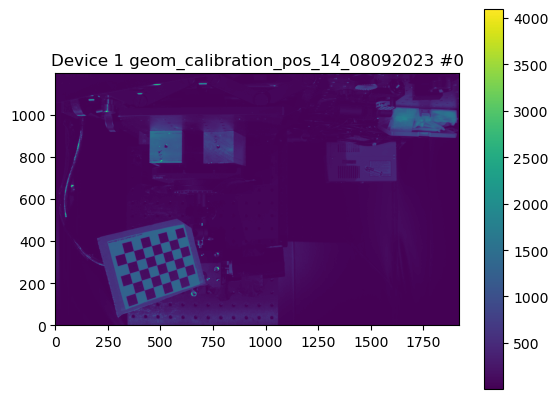

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


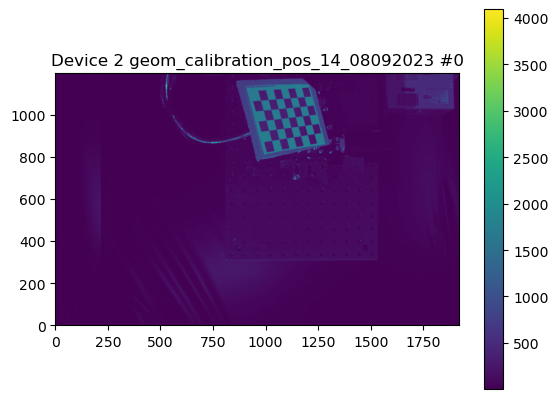

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


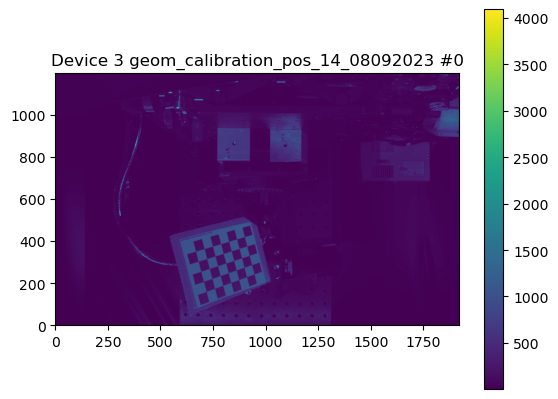

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


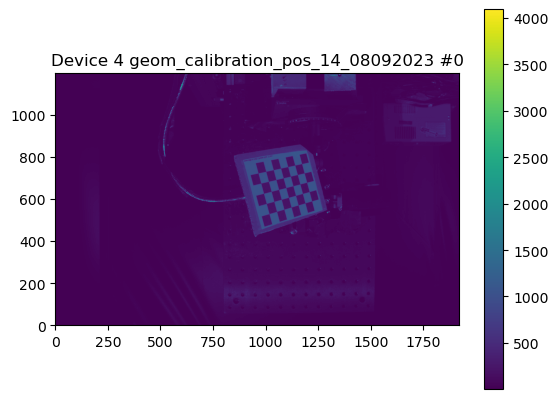

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


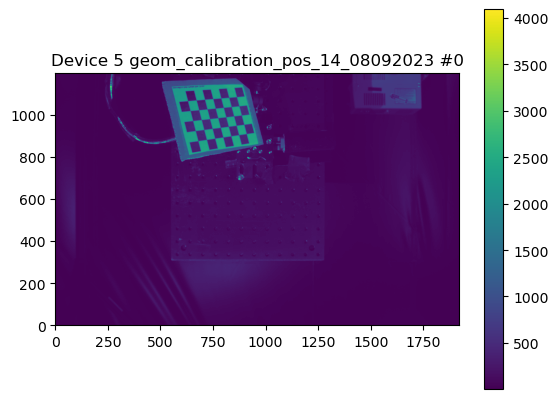

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


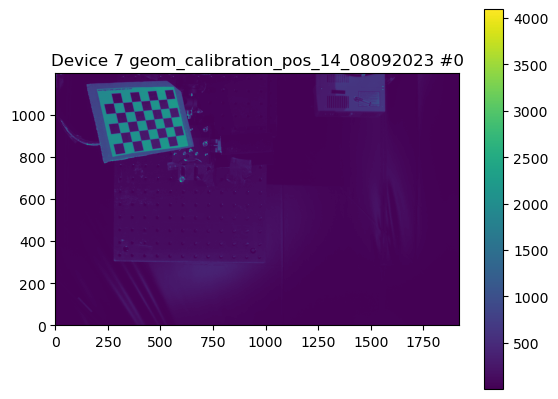

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


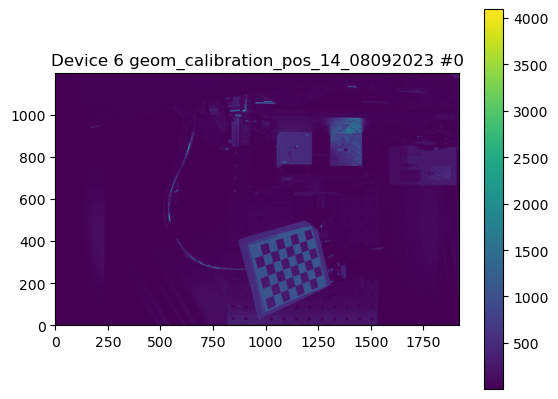

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_14_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_14_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

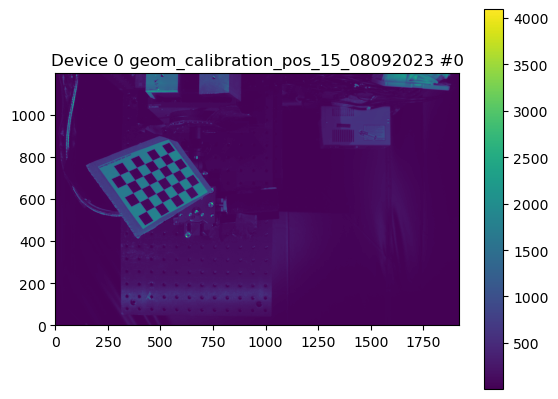

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


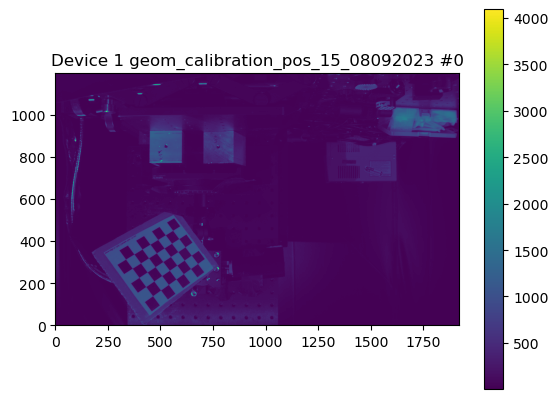

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


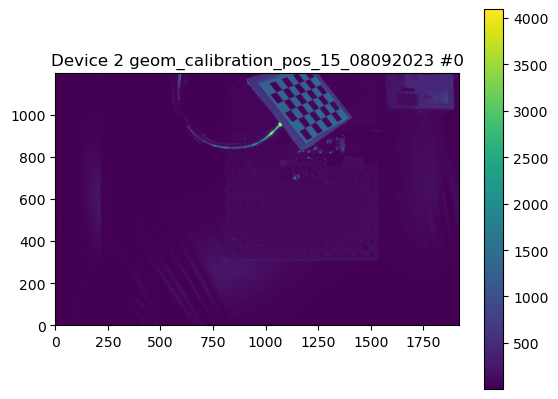

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


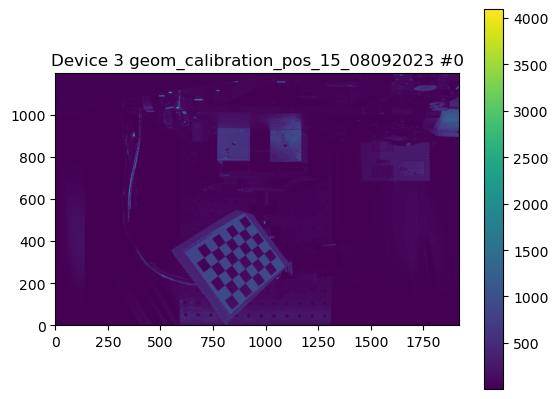

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


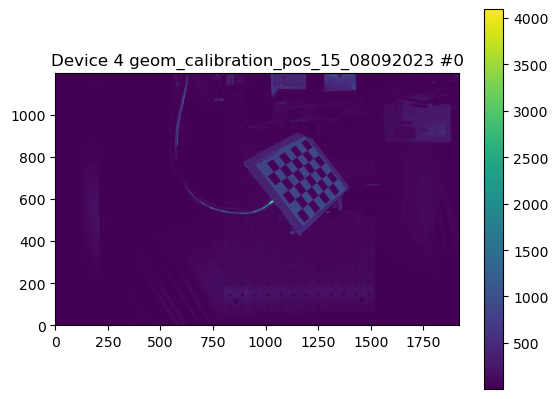

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


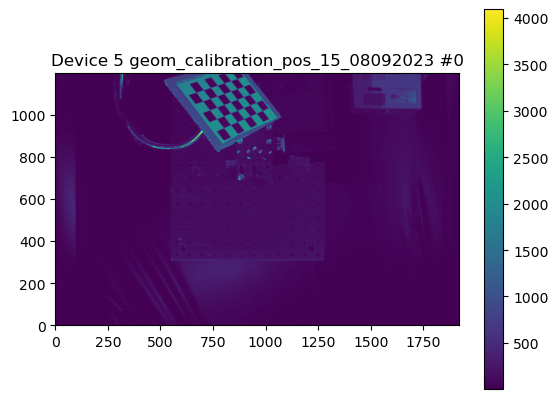

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


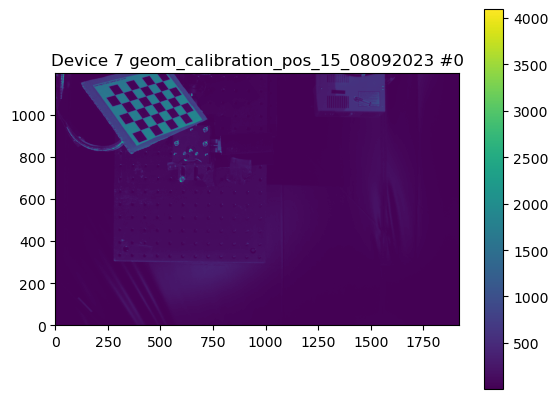

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


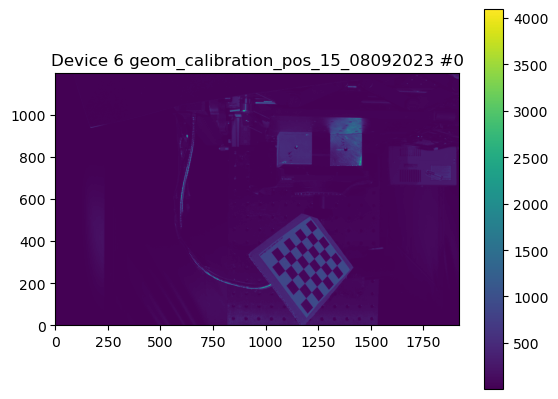

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_15_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_15_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

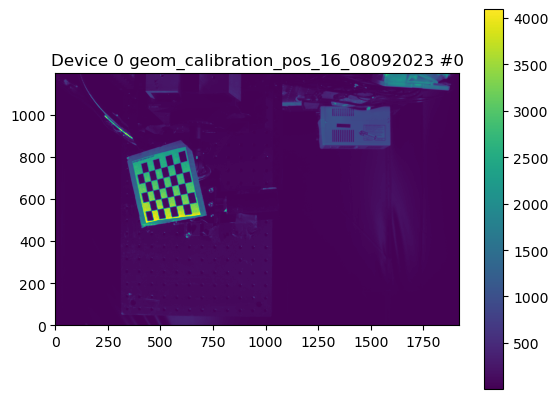

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


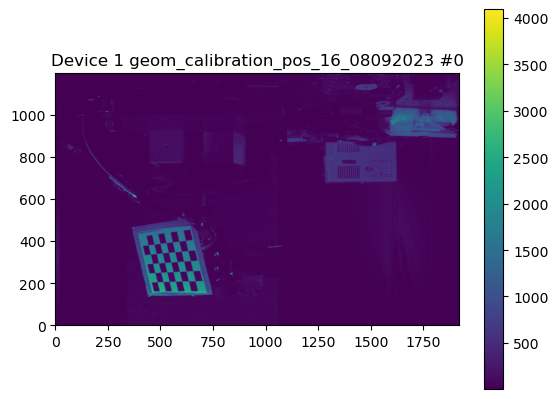

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


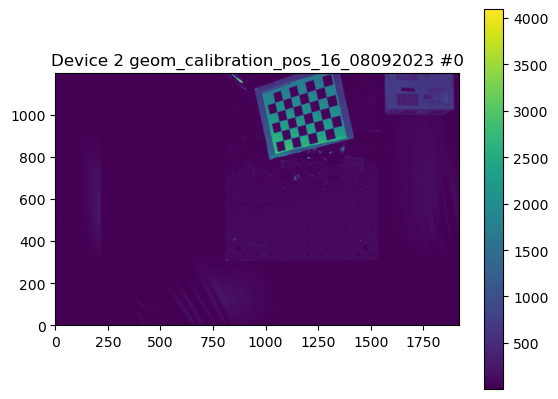

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


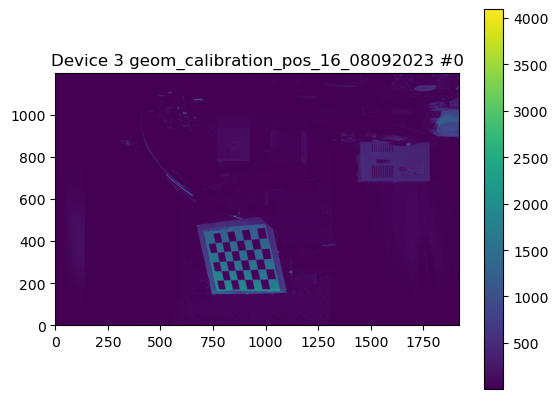

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


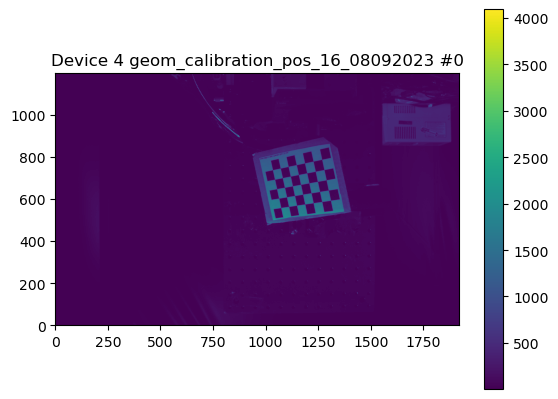

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


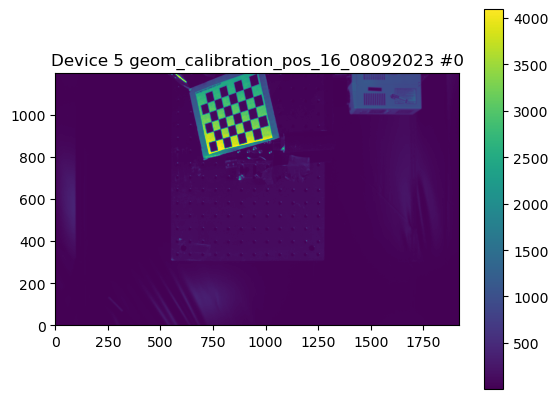

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


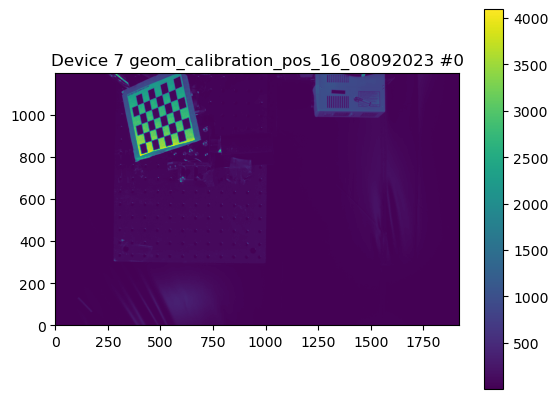

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


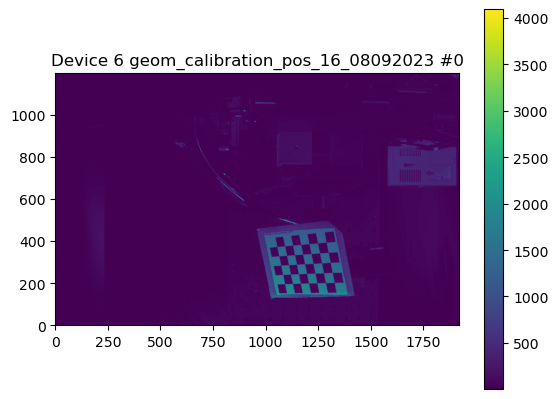

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_16_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_16_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

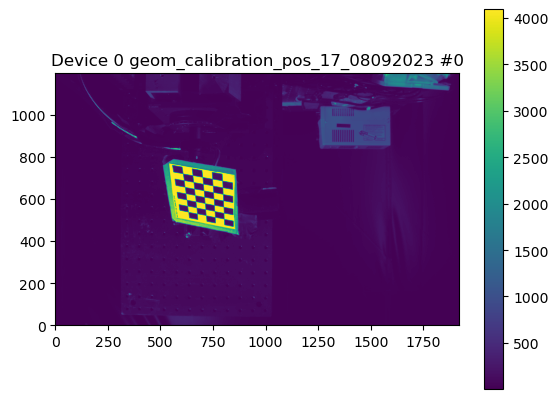

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


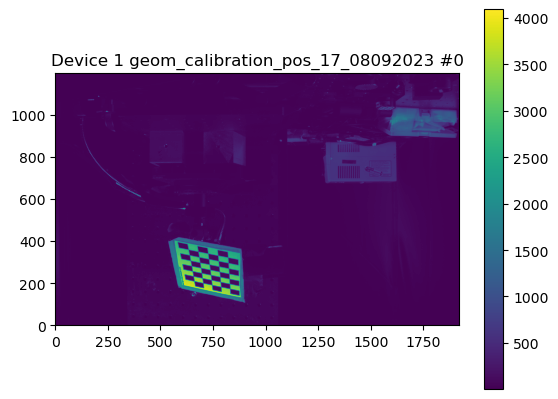

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


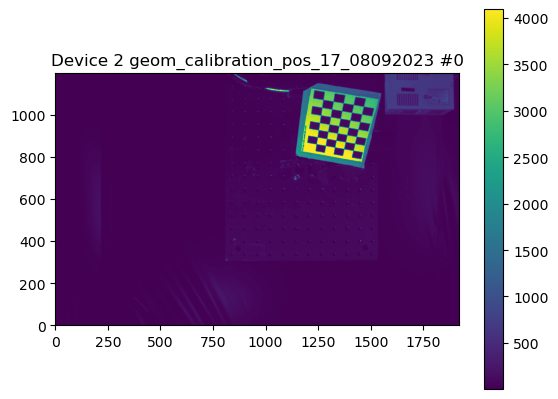

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


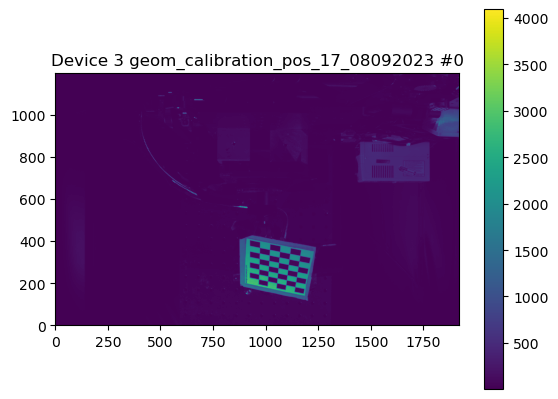

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


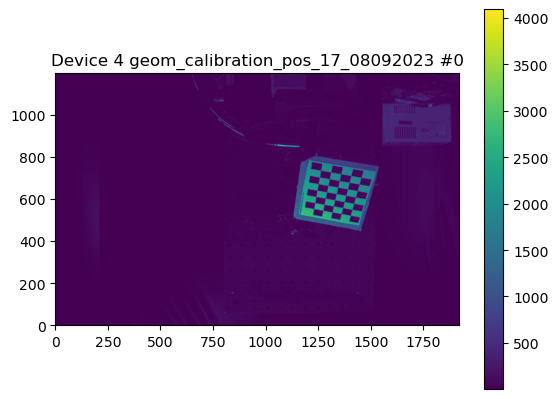

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


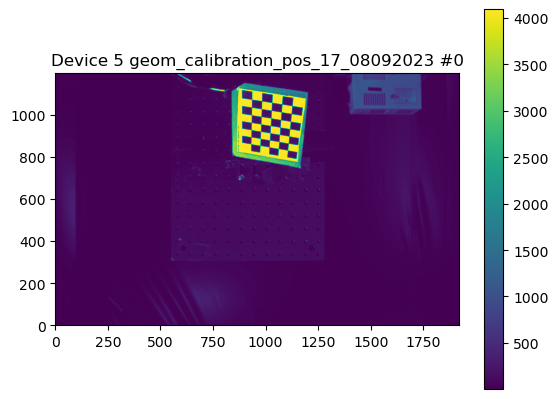

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


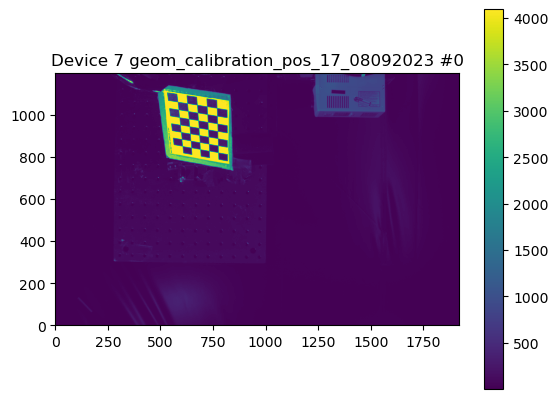

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


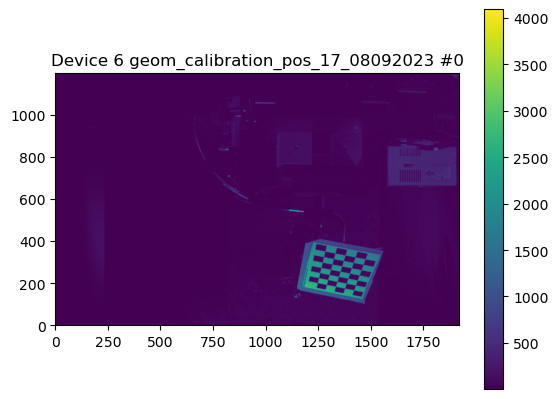

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_17_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_17_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

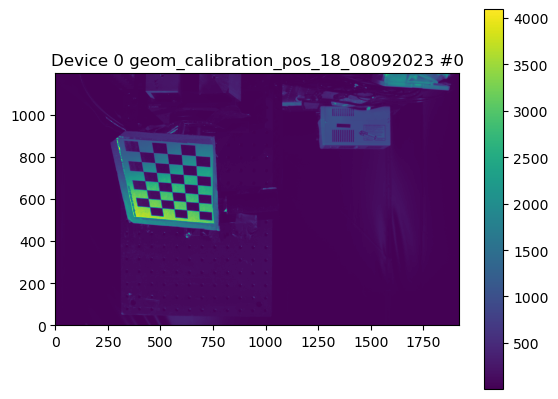

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


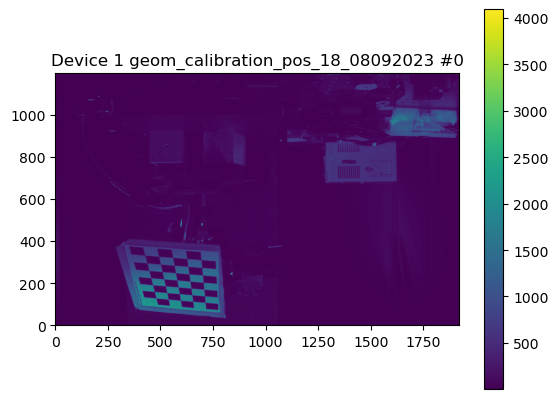

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


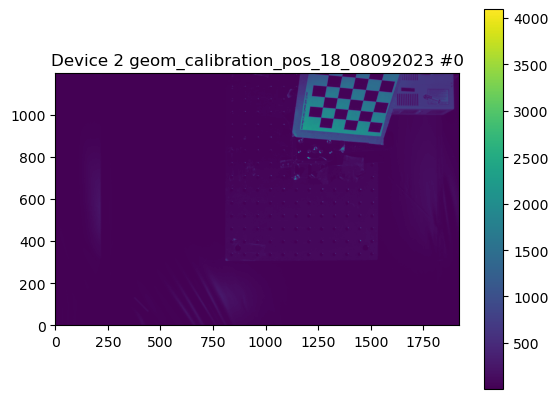

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


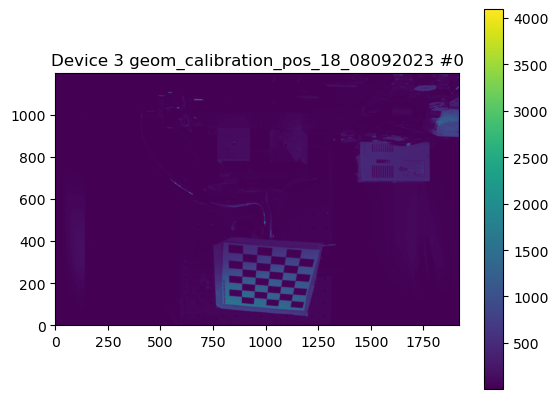

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


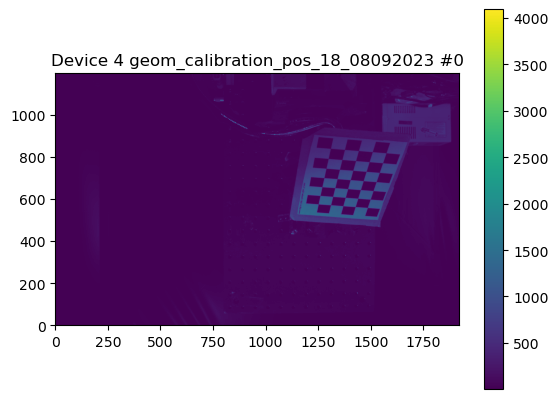

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


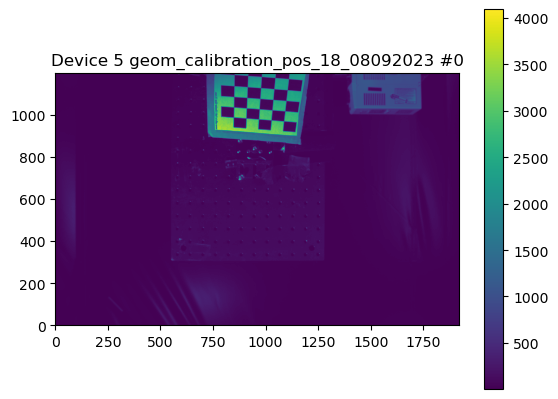

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


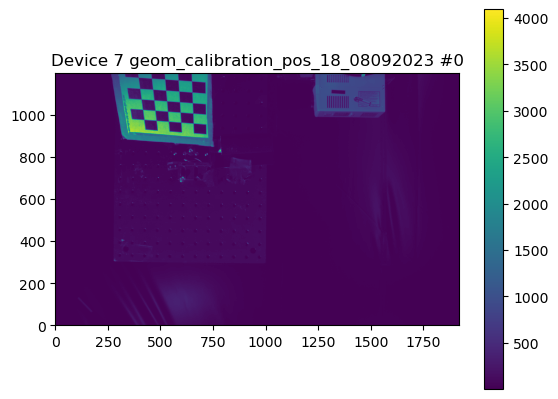

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


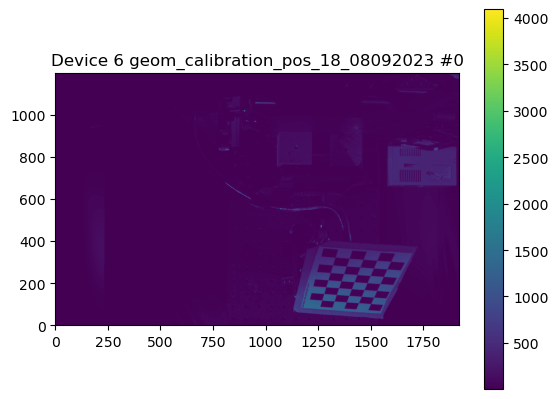

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_18_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_18_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

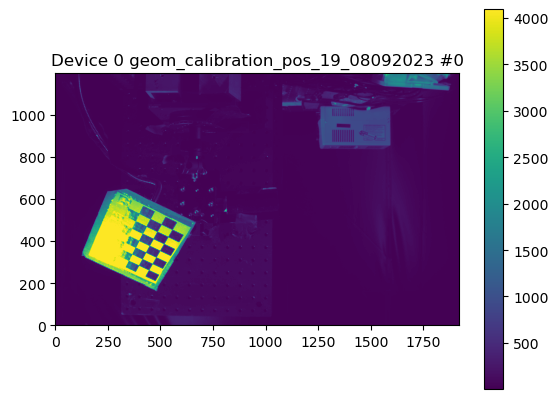

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


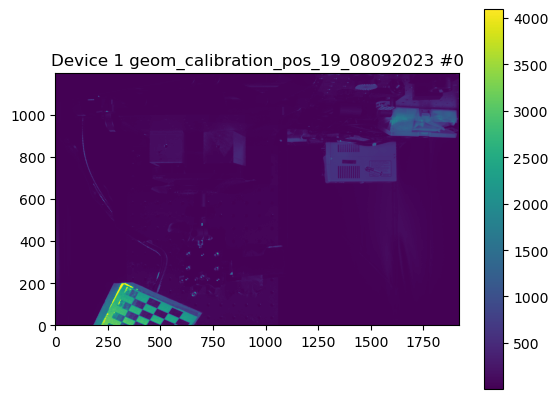

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


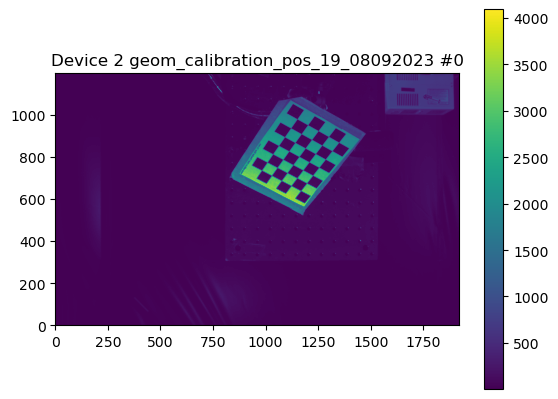

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


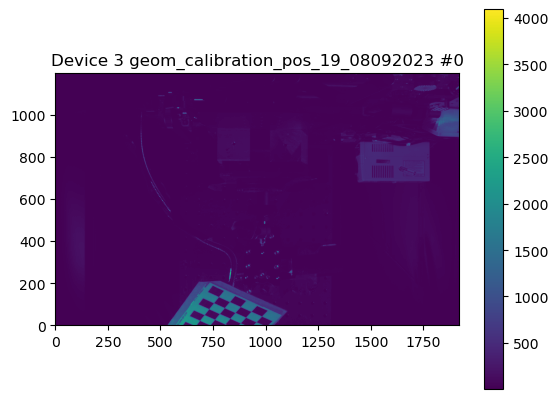

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


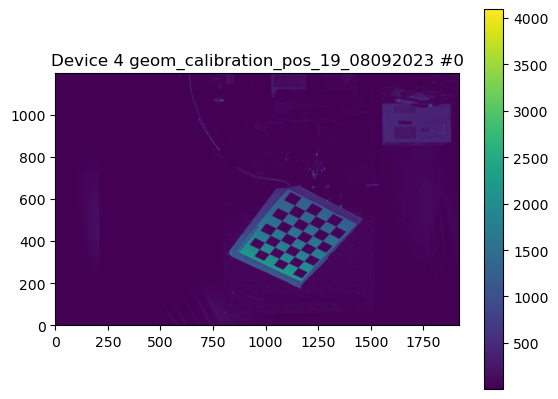

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


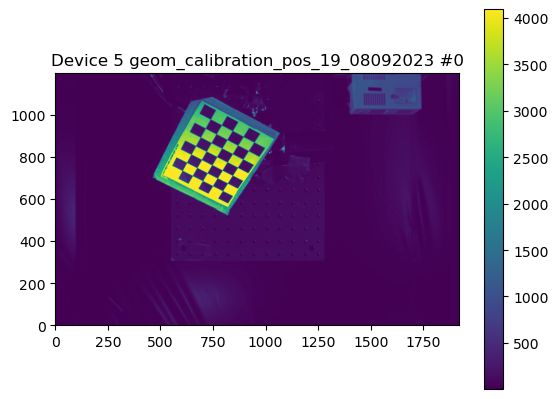

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


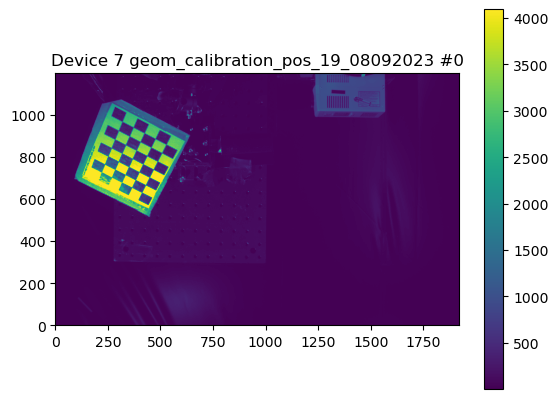

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


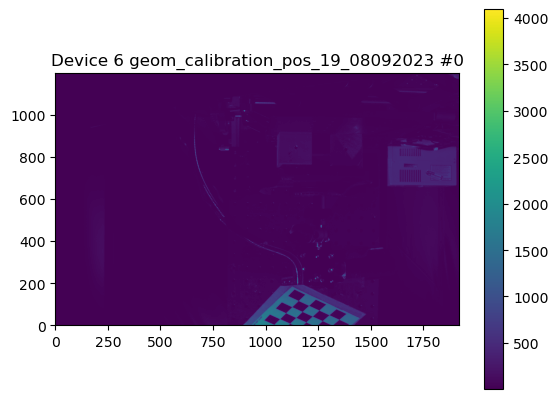

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_19_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_19_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

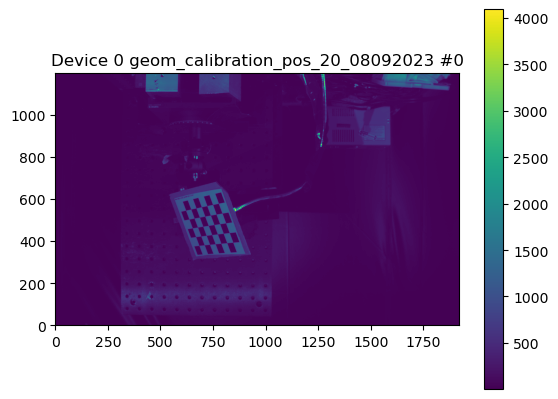

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


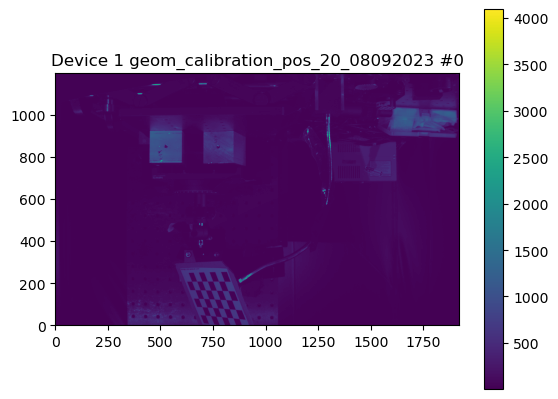

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


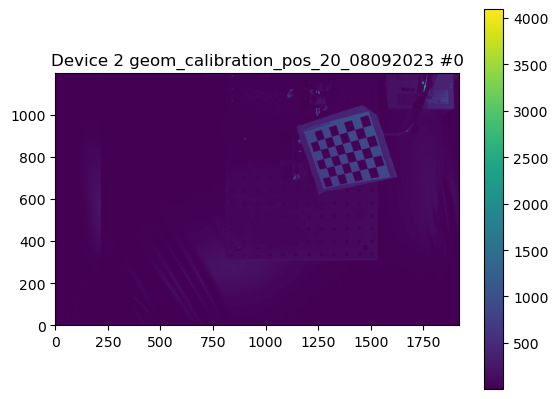

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


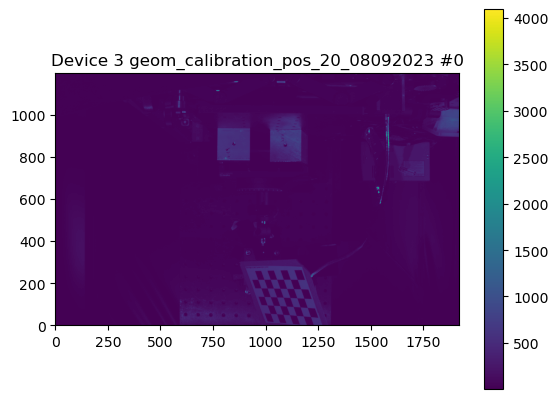

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


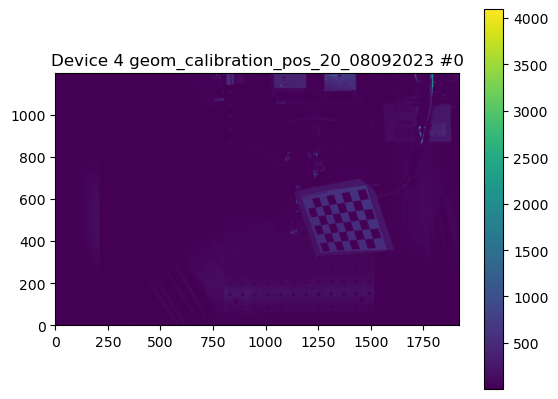

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


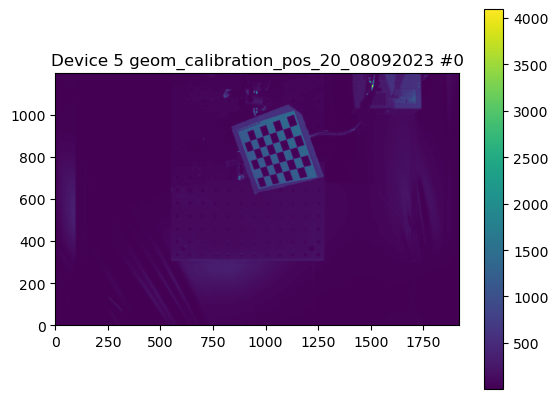

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


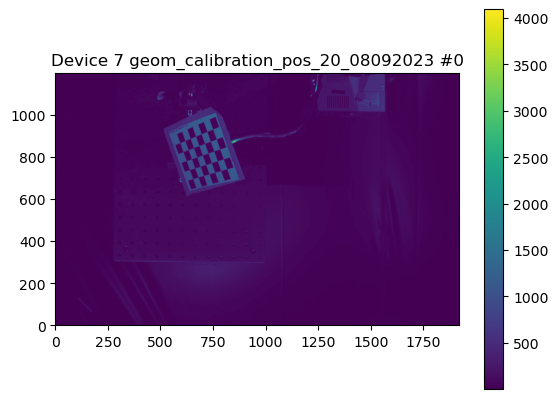

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


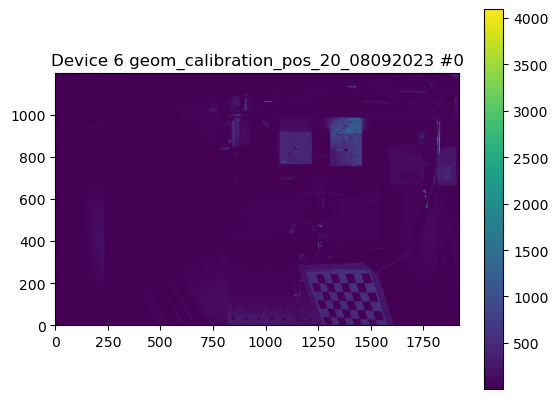

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_20_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_20_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

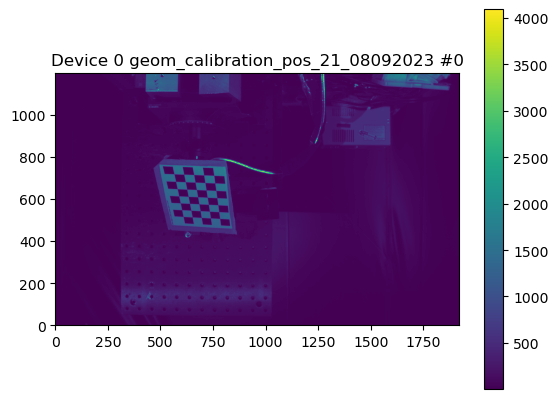

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


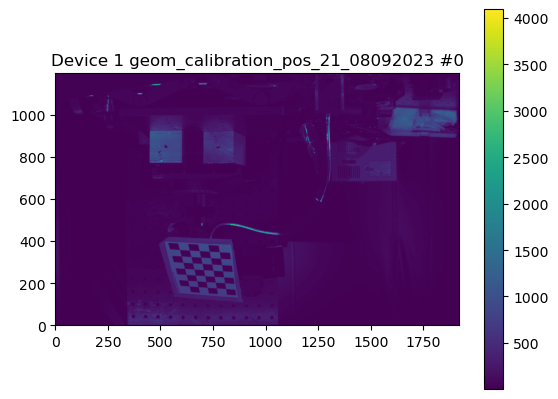

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


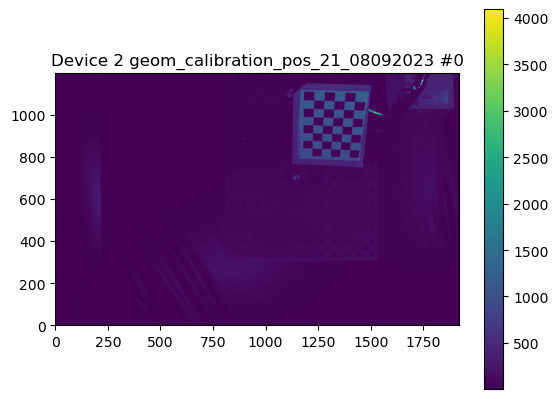

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


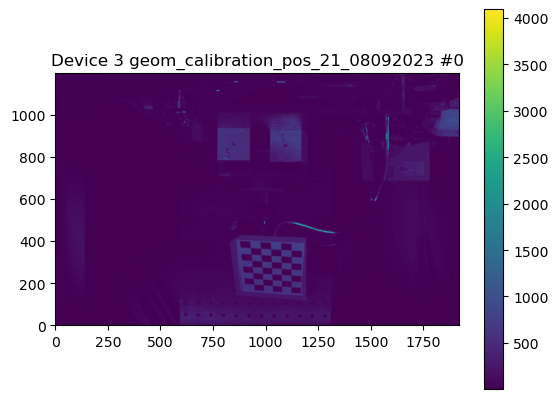

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


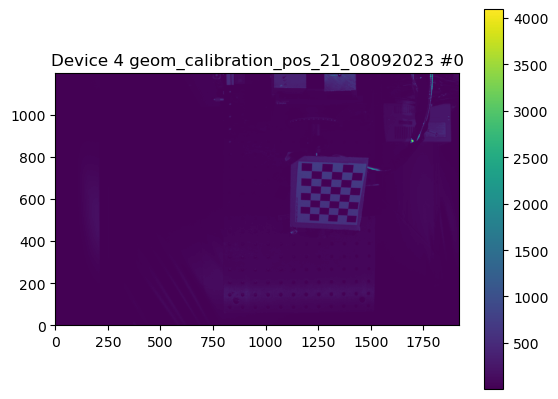

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


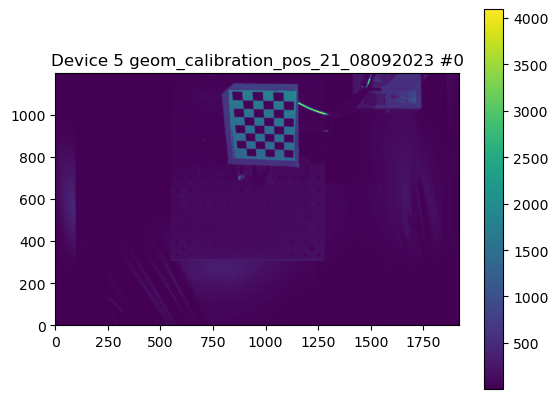

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


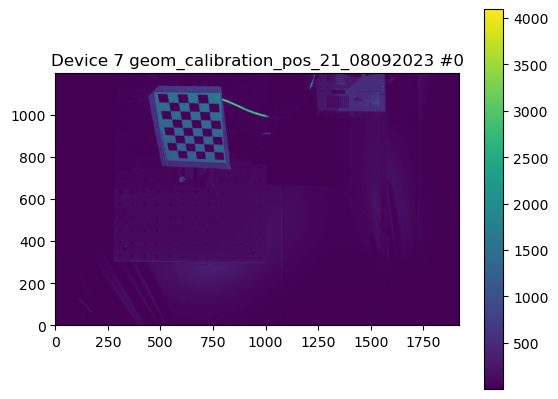

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


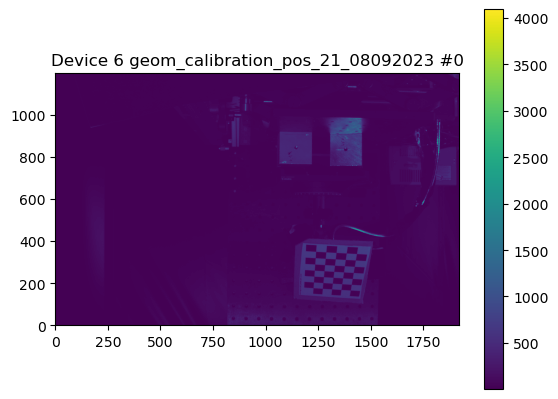

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_21_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_21_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

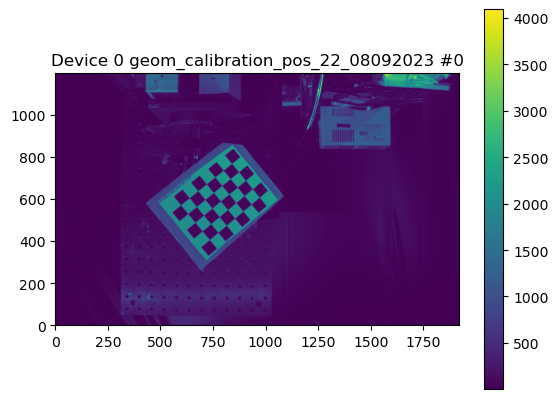

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


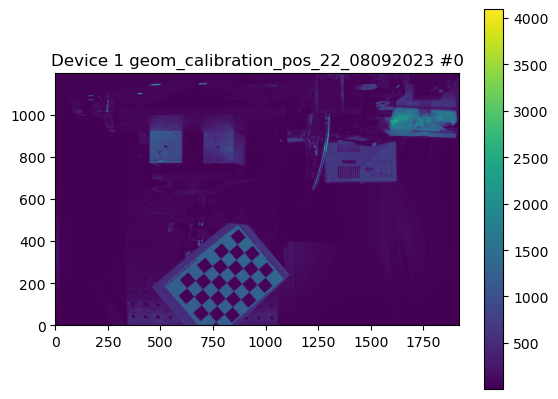

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


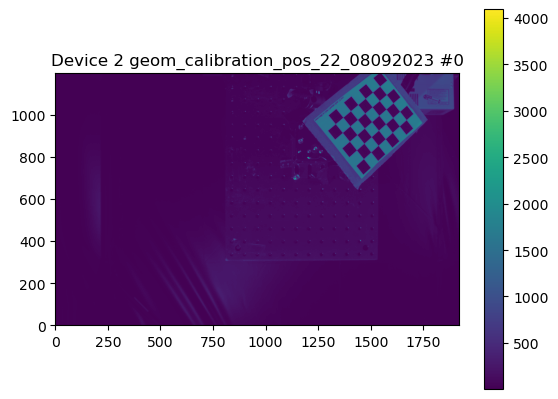

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


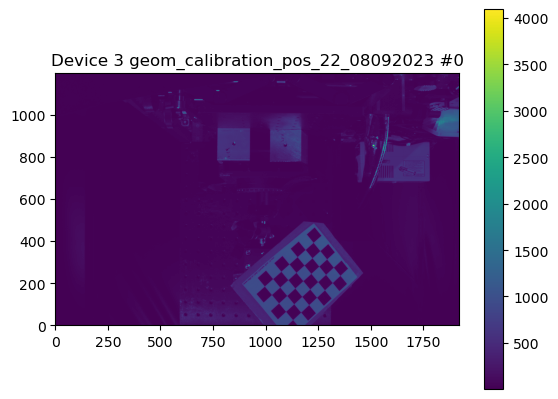

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


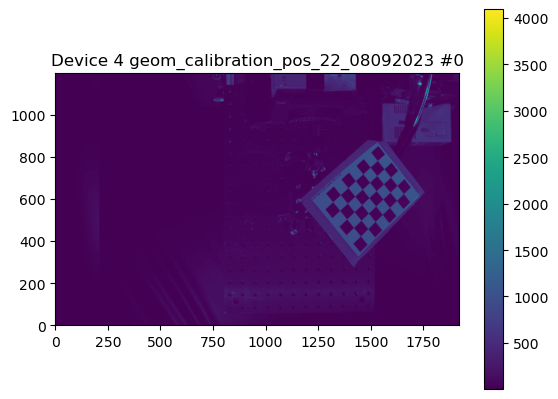

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


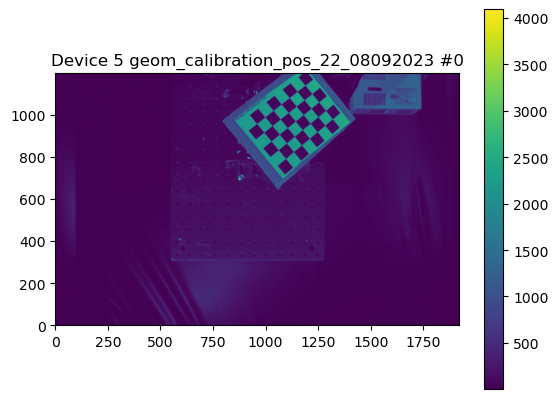

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


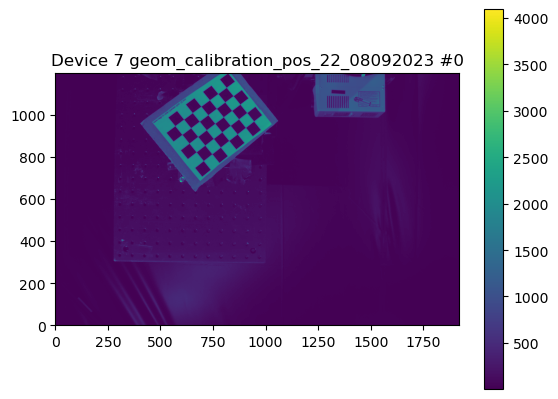

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


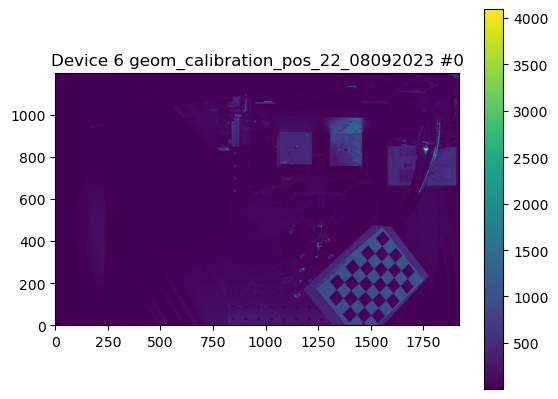

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_22_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_22_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

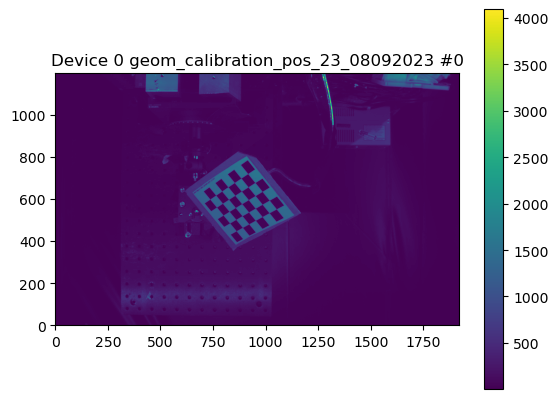

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


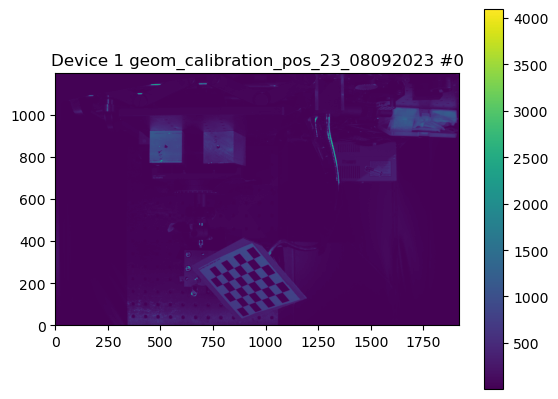

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


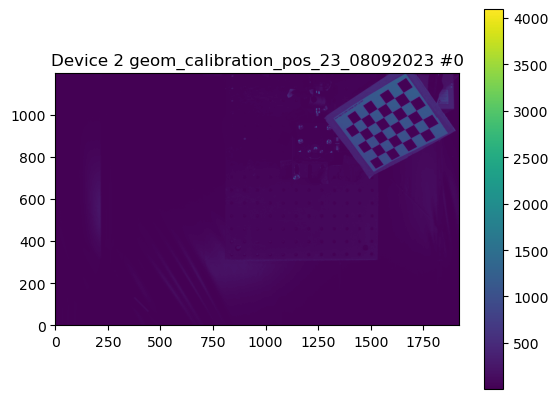

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


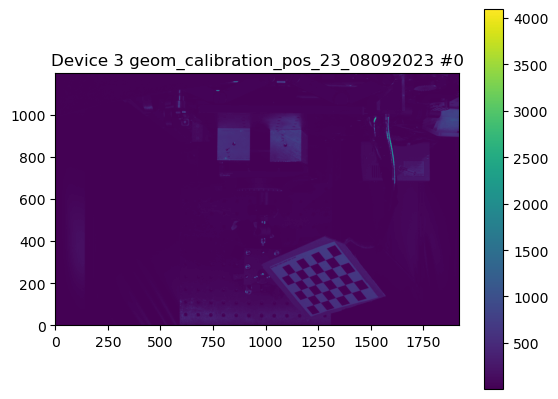

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


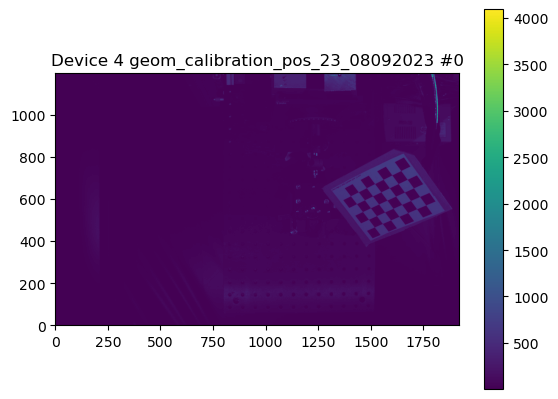

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


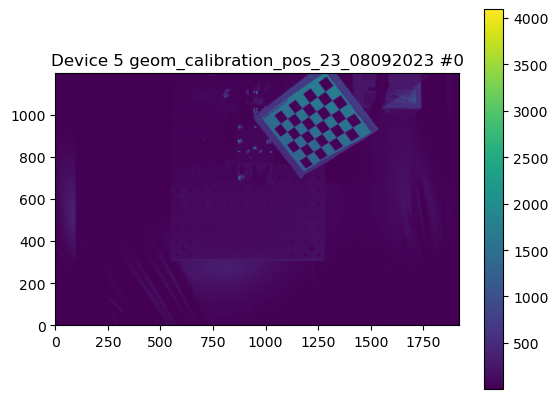

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


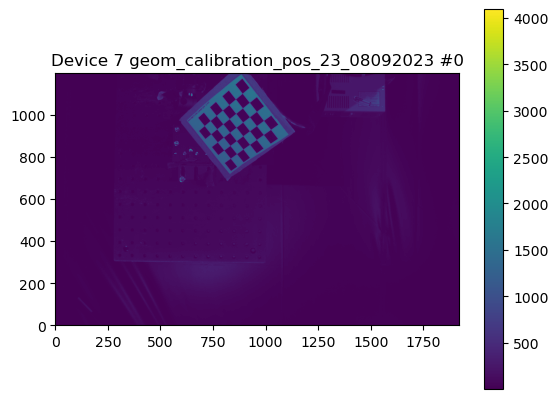

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


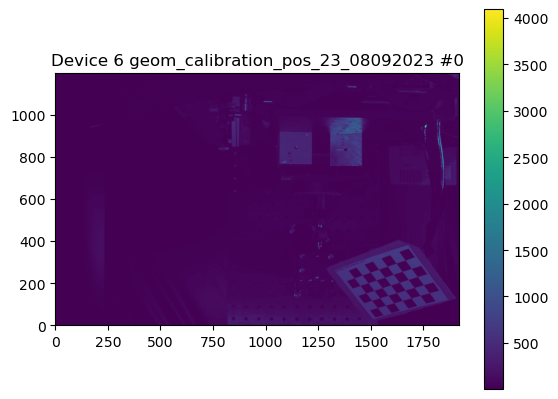

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_23_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_23_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

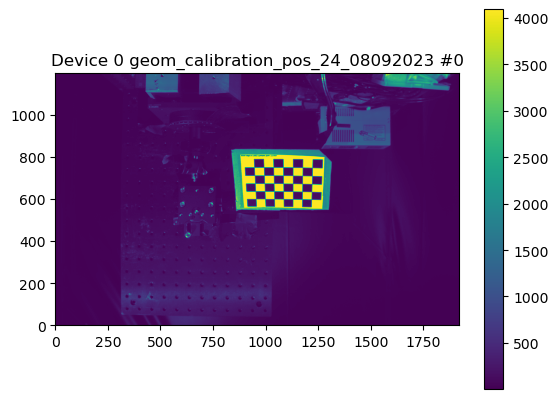

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


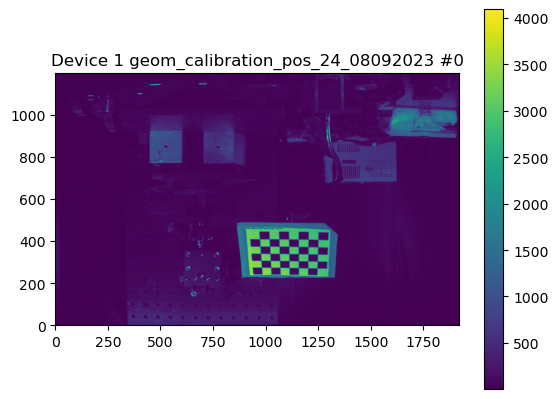

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


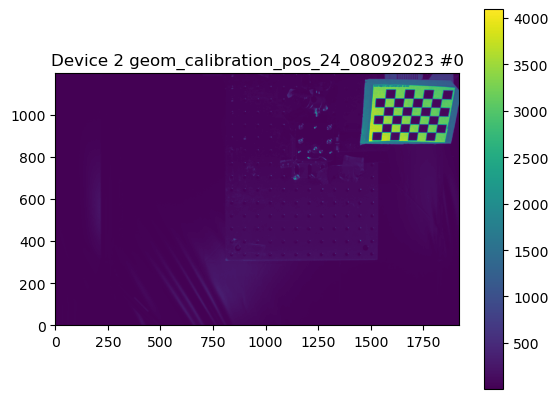

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


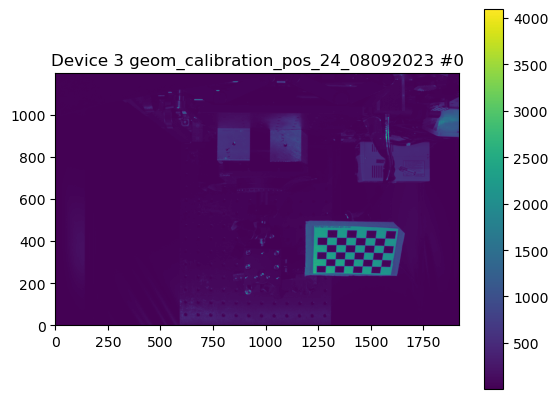

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


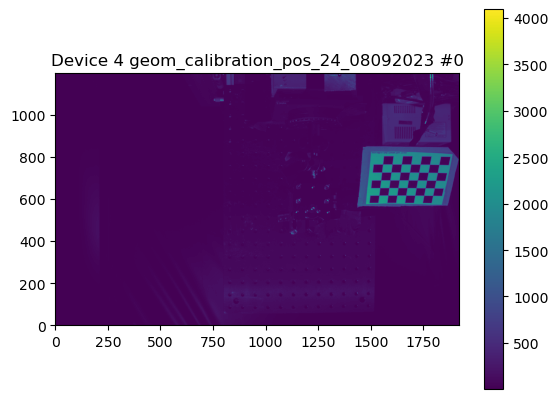

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


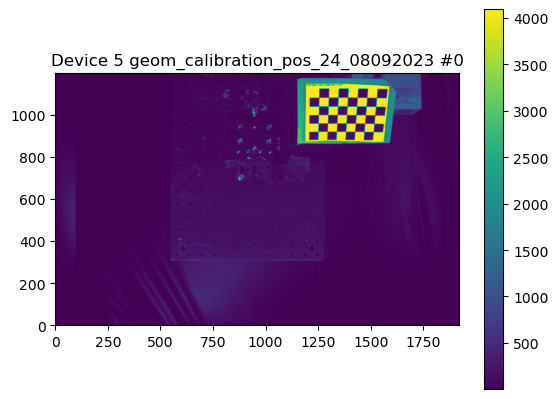

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


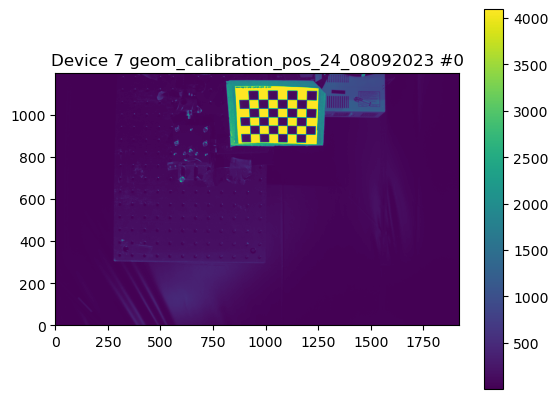

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


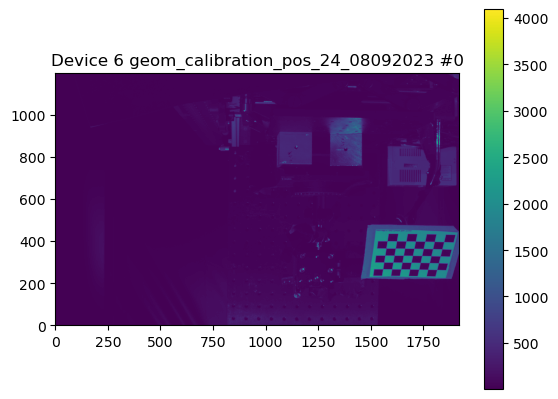

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_24_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_24_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

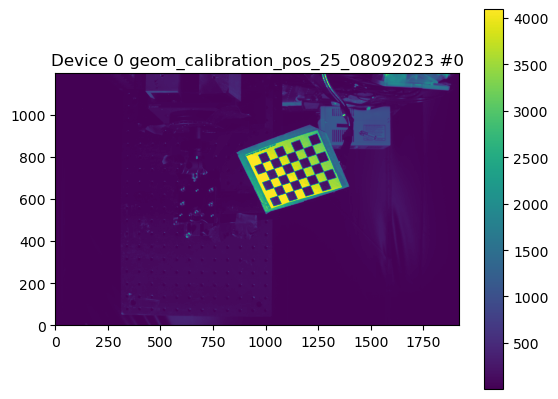

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


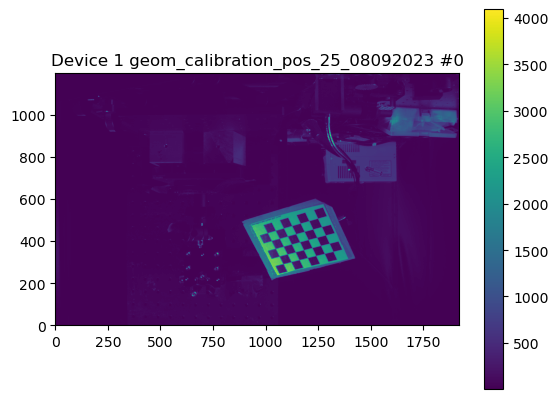

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


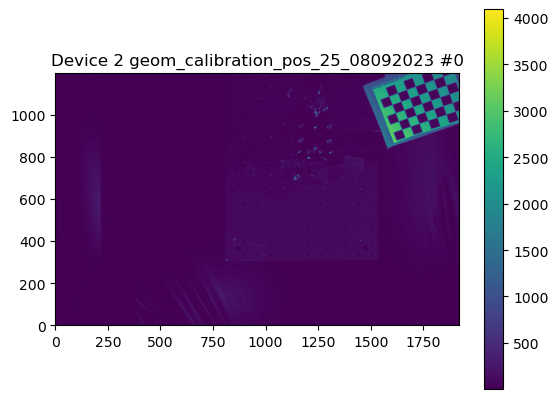

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


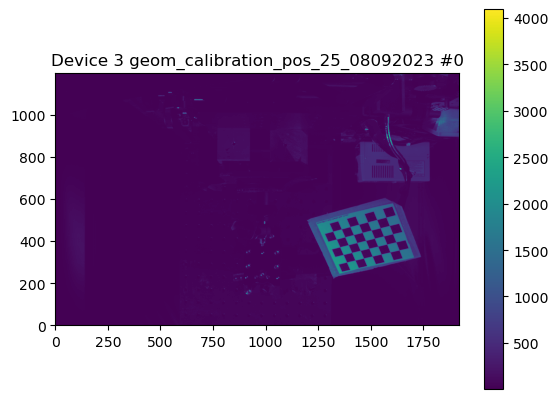

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


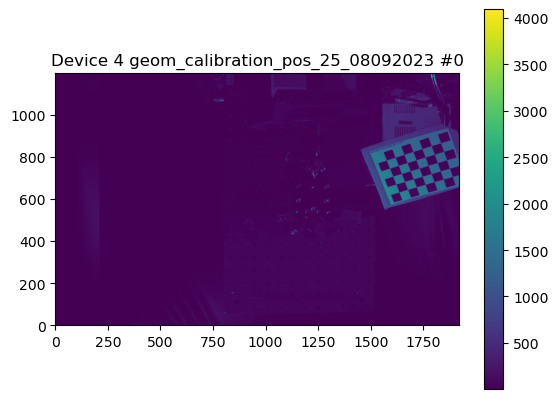

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


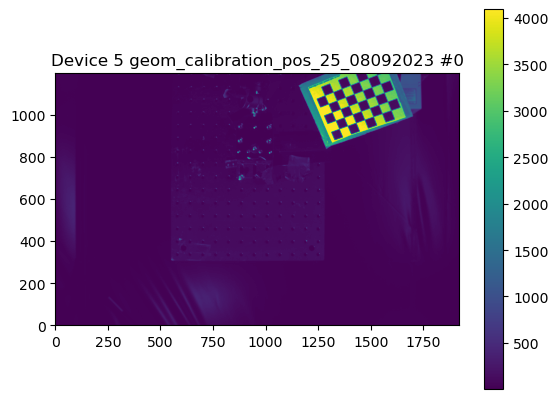

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


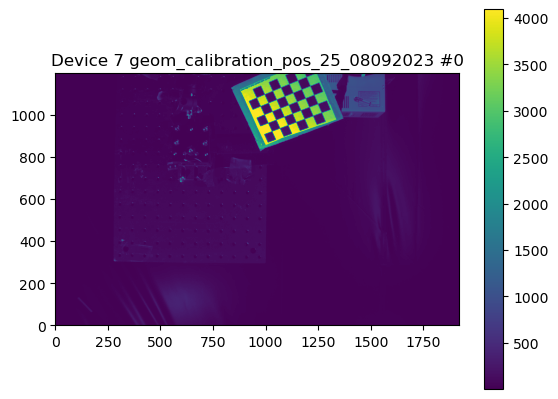

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


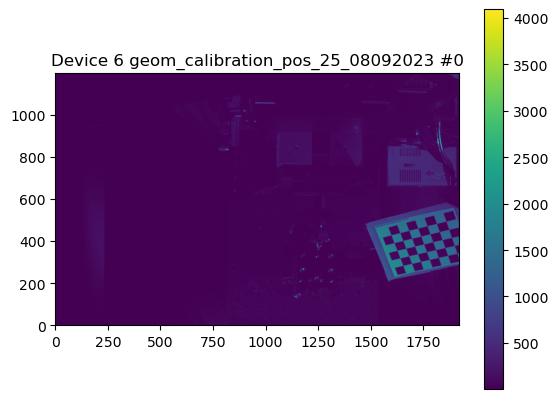

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_25_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_25_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

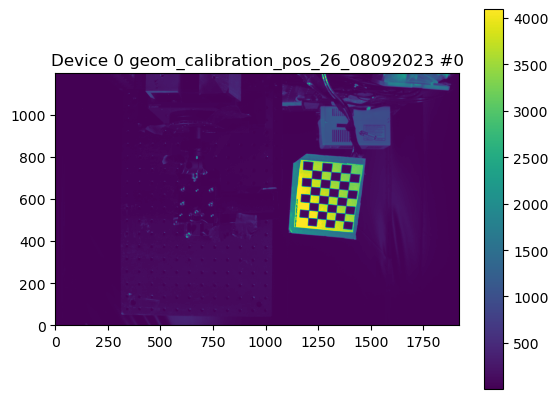

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


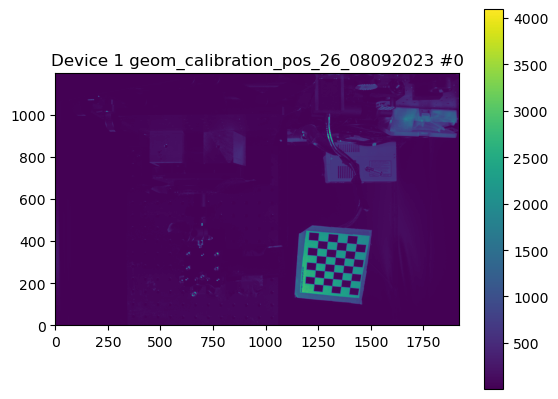

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


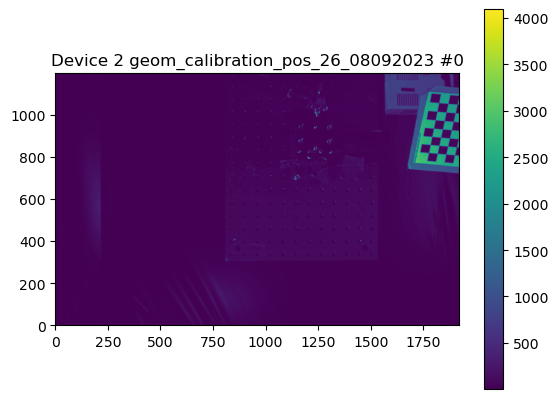

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


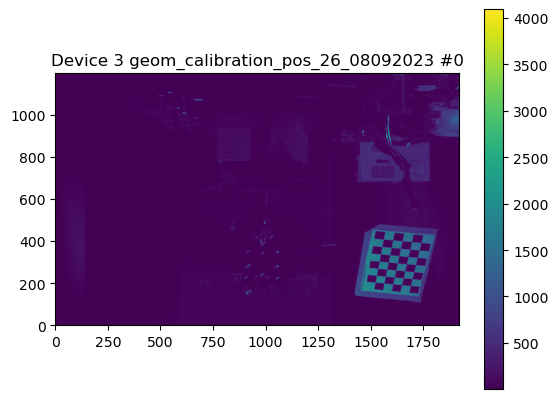

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


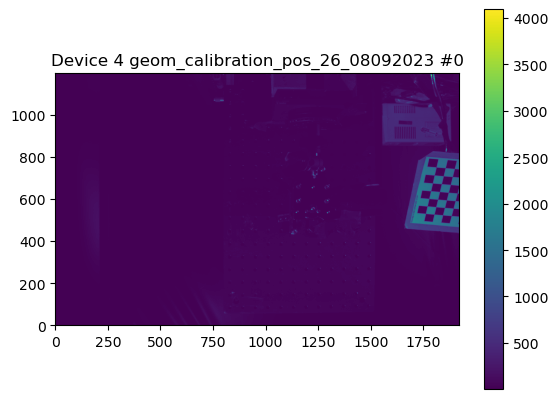

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


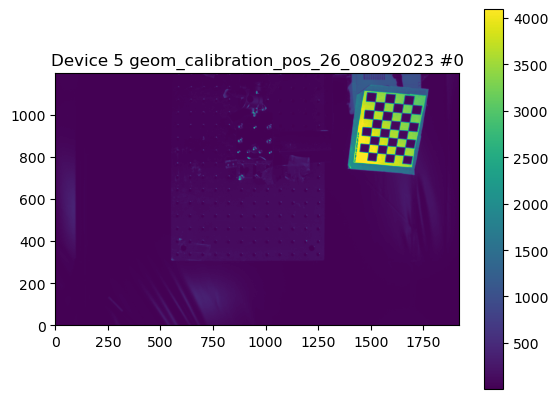

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


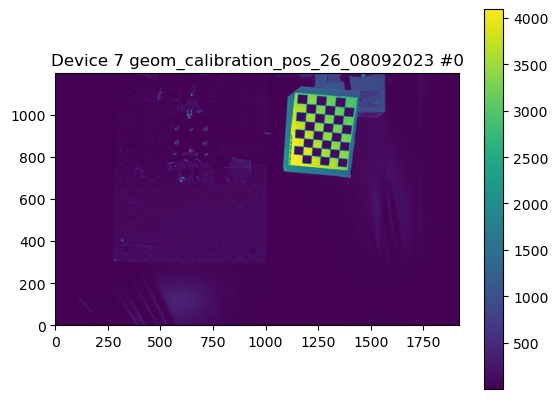

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


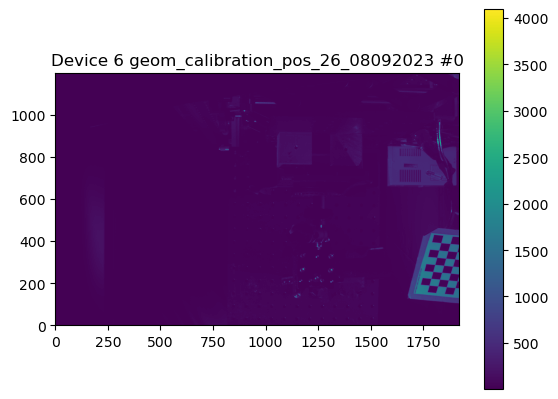

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_26_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_26_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

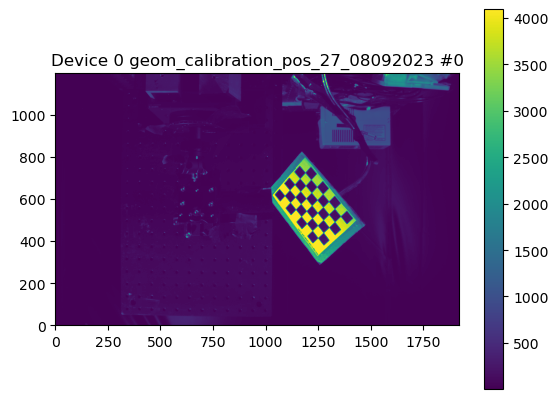

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


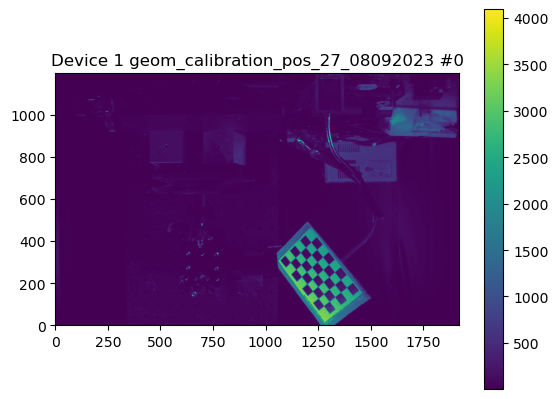

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


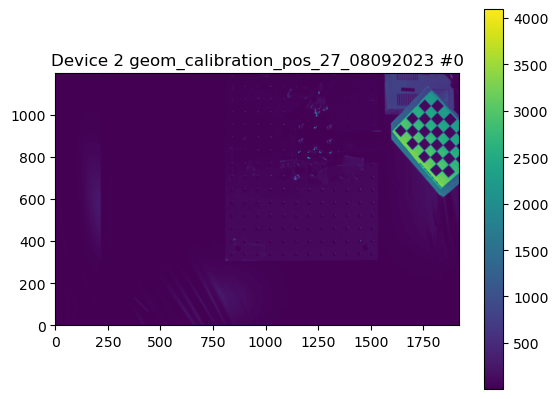

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


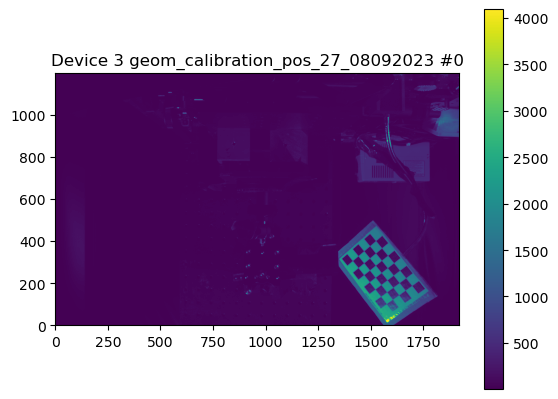

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


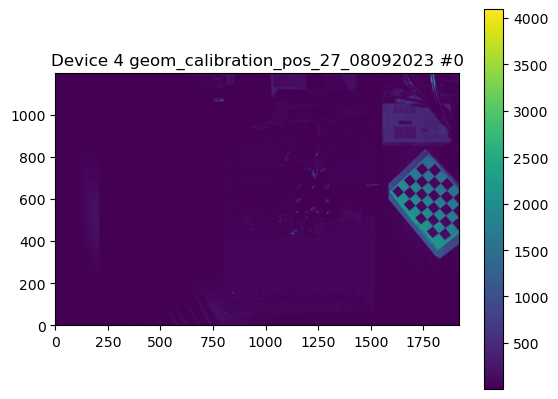

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


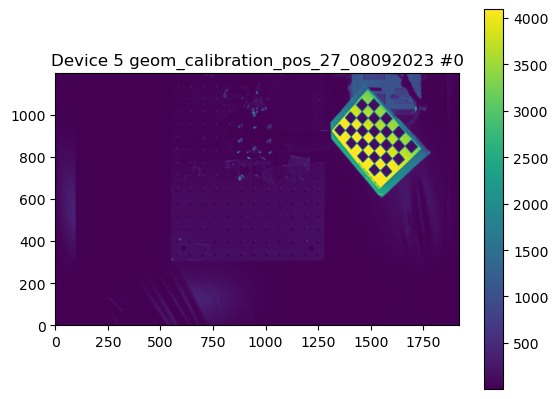

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


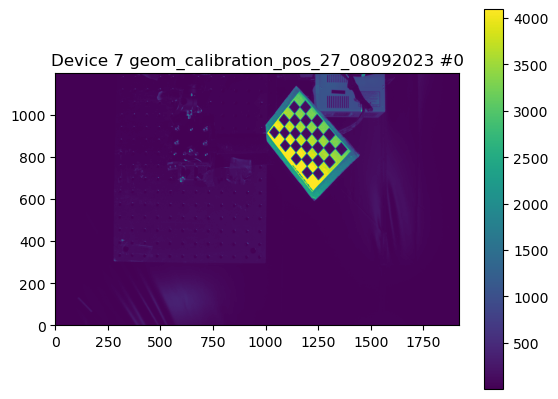

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


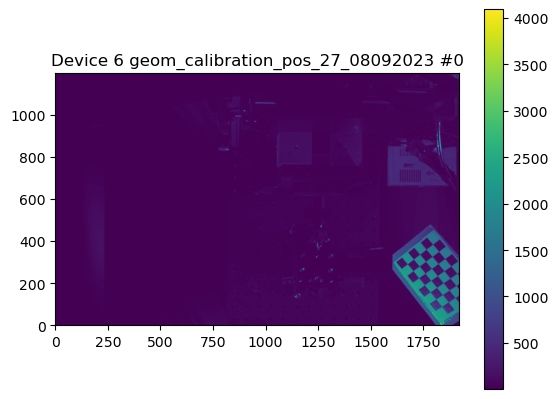

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_27_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_27_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

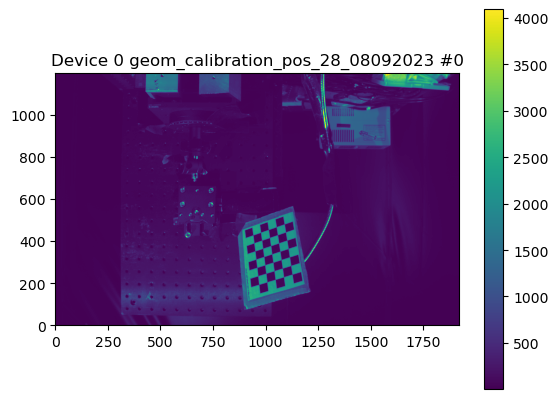

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


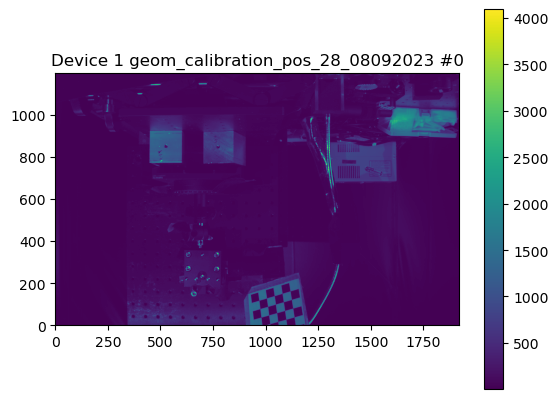

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


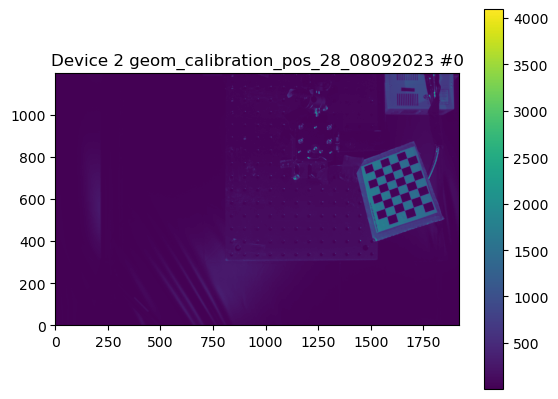

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


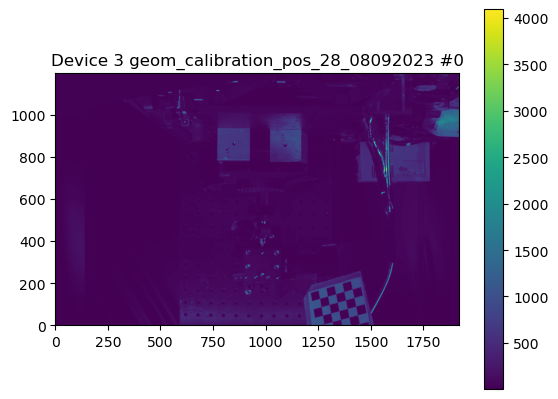

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


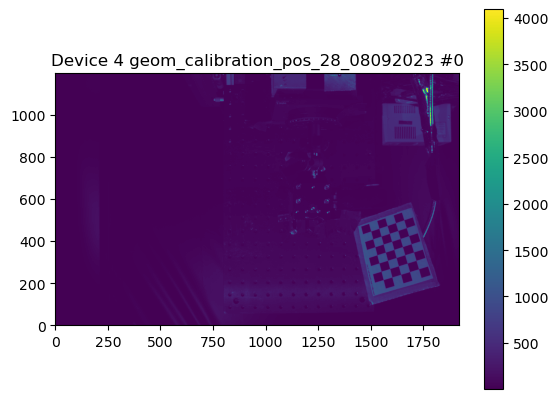

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


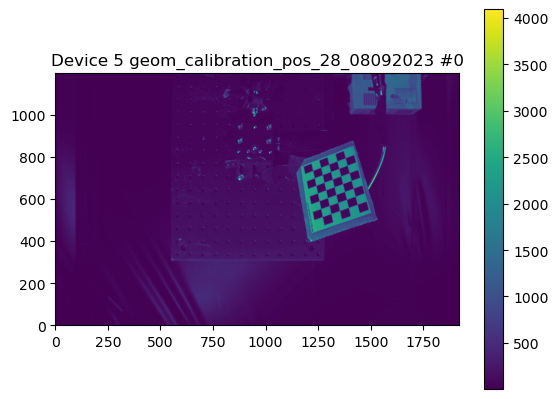

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


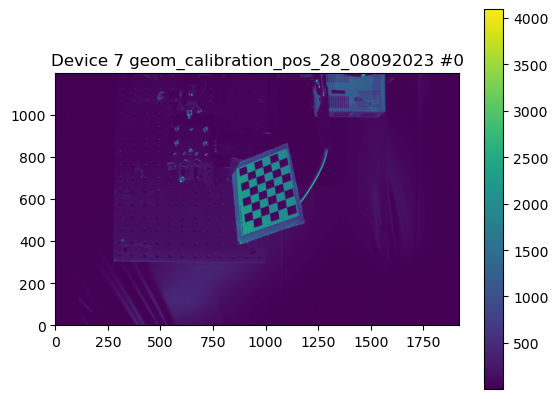

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


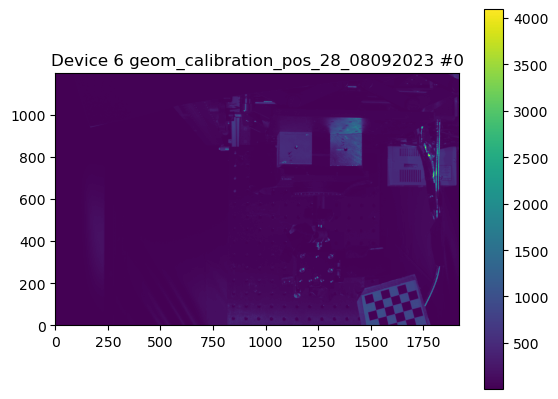

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_28_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_28_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

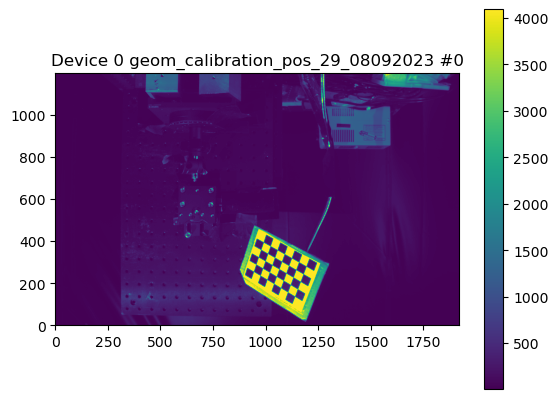

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


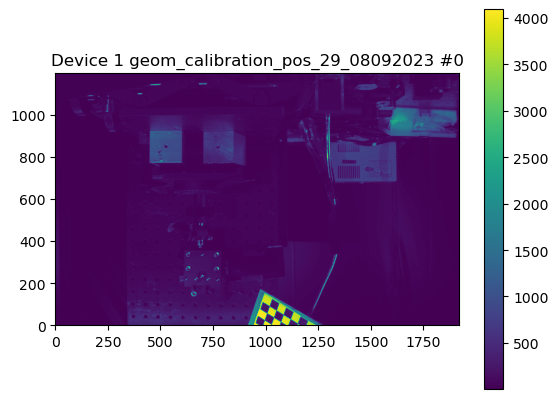

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


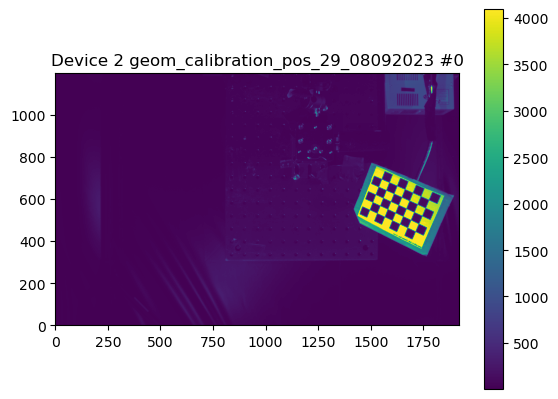

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


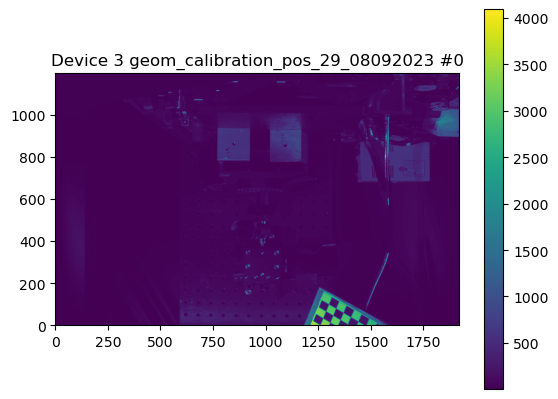

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


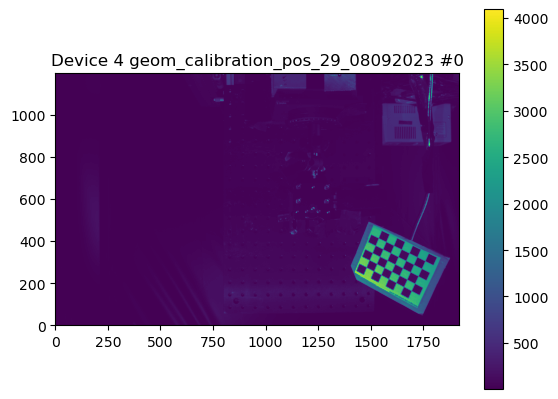

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


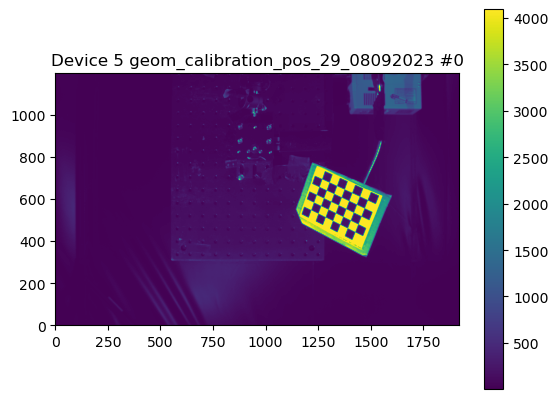

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


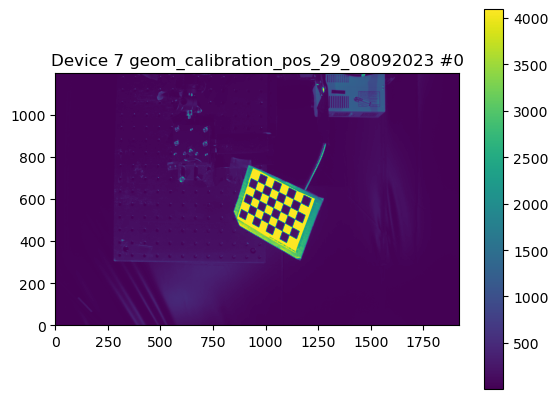

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


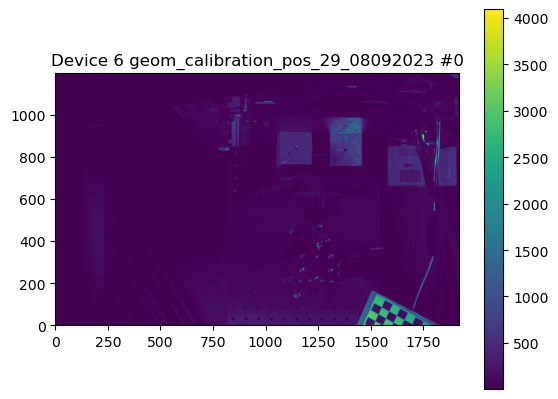

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_29_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_29_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

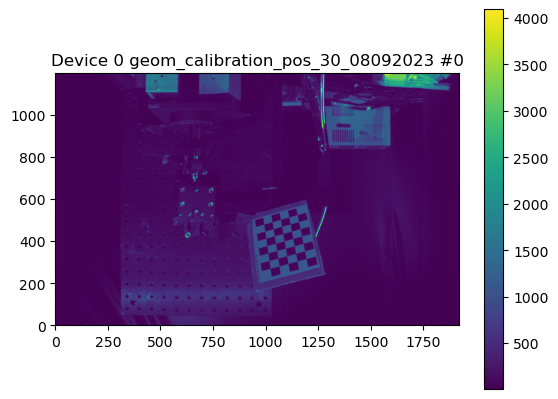

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


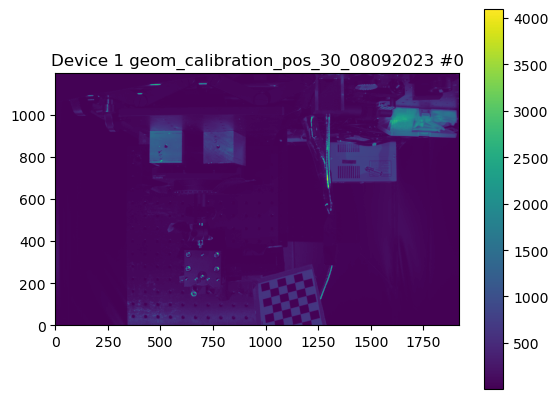

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


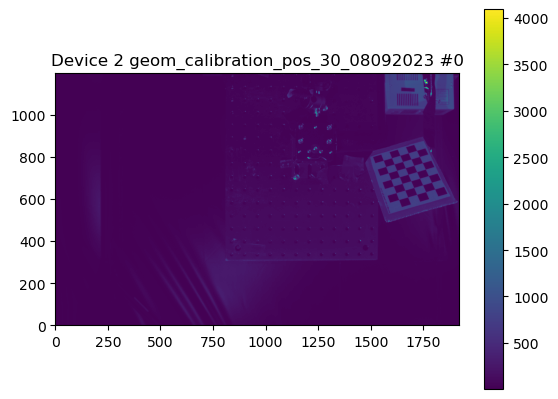

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


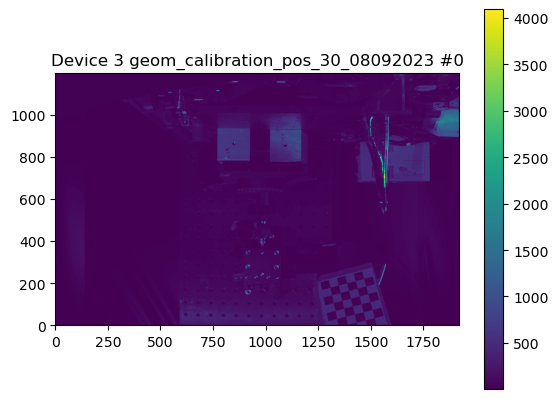

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


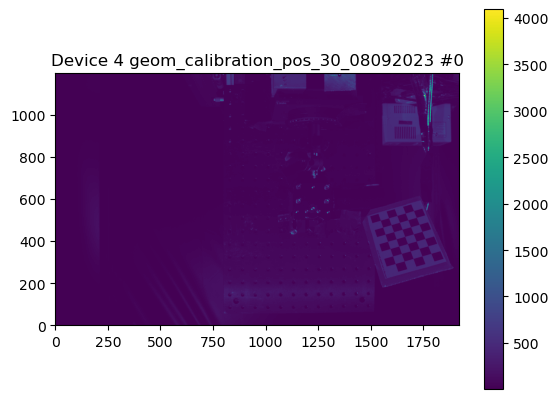

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


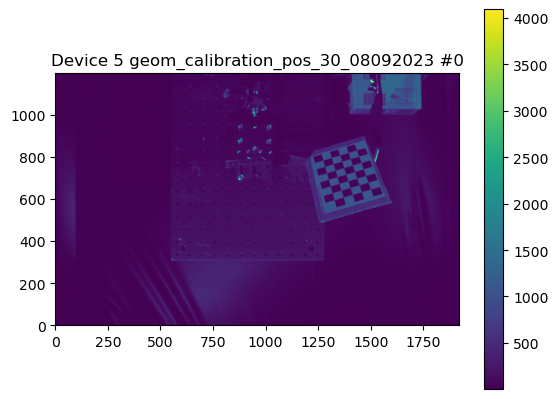

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


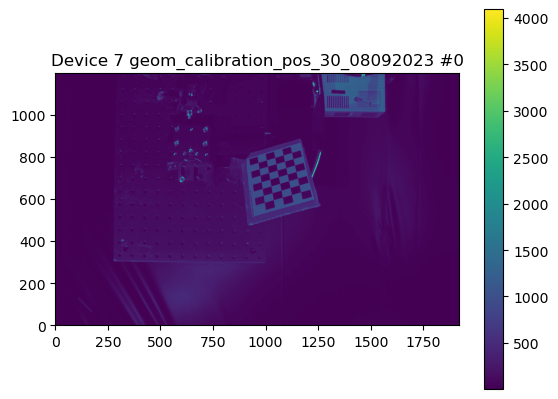

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


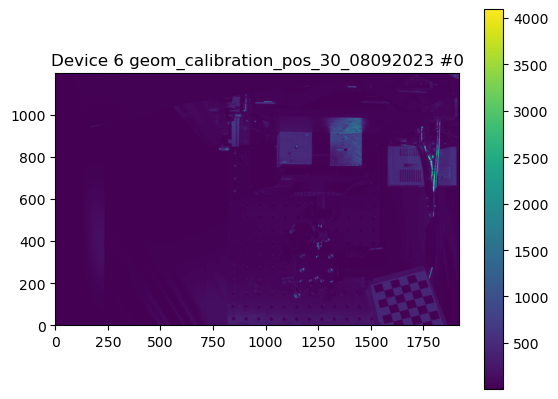

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_30_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_30_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

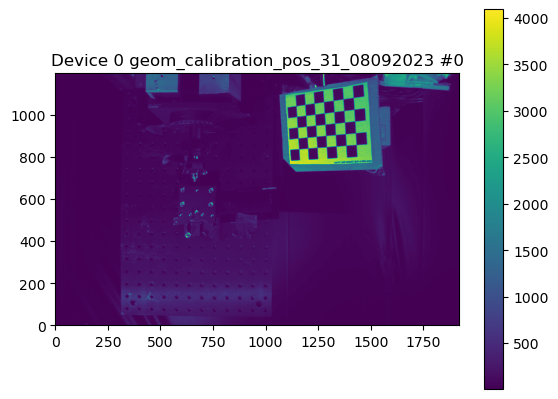

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


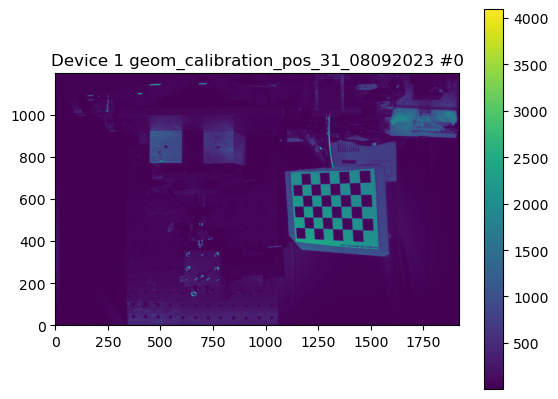

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


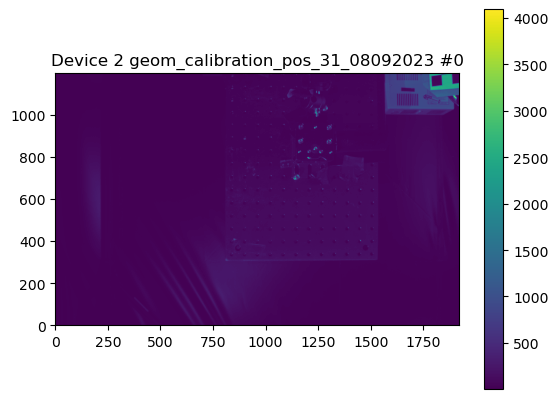

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


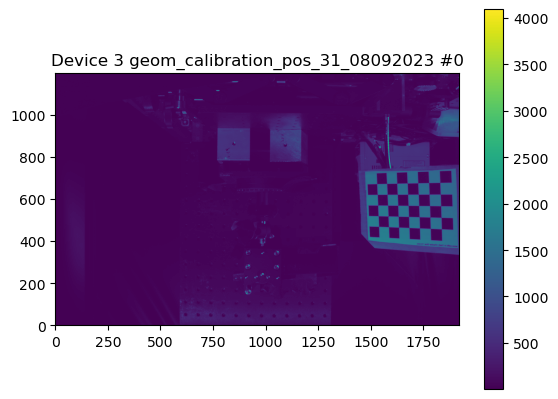

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


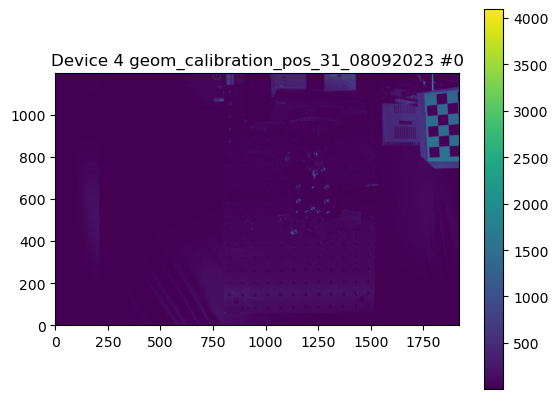

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


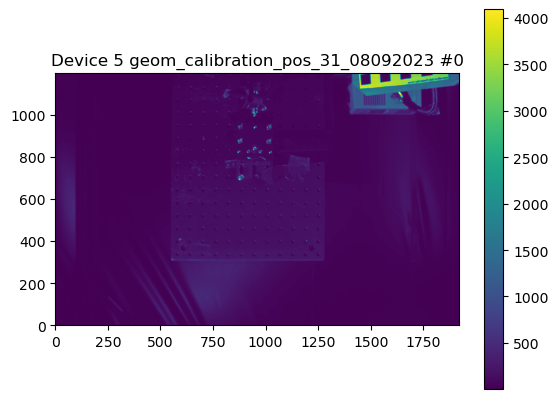

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


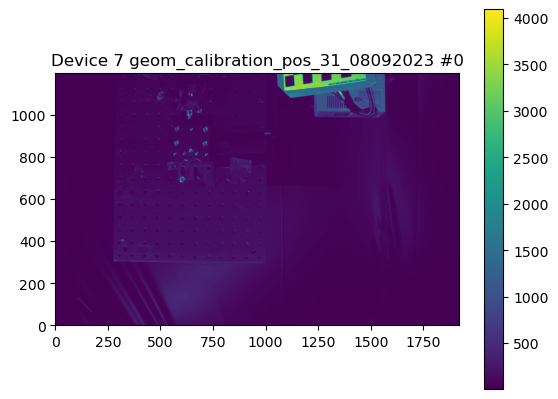

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


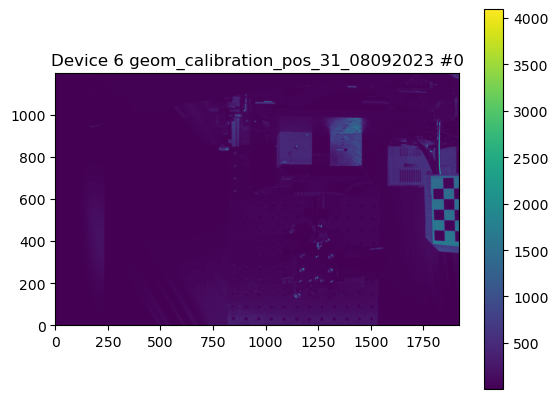

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_31_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_31_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

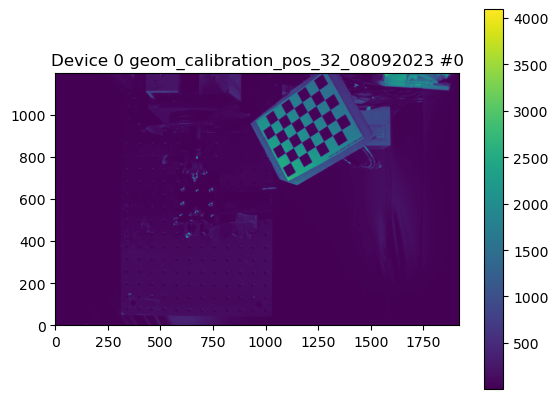

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


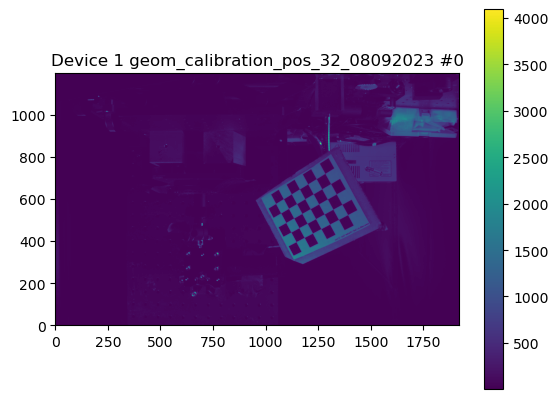

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


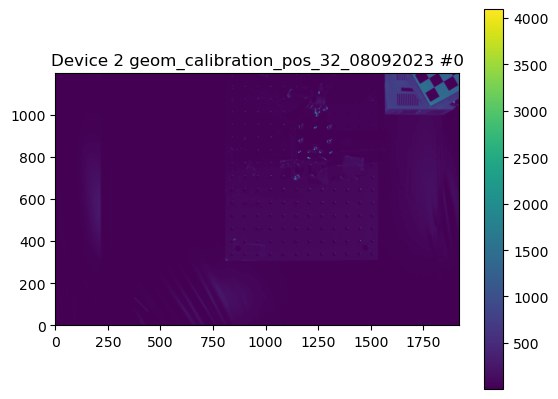

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


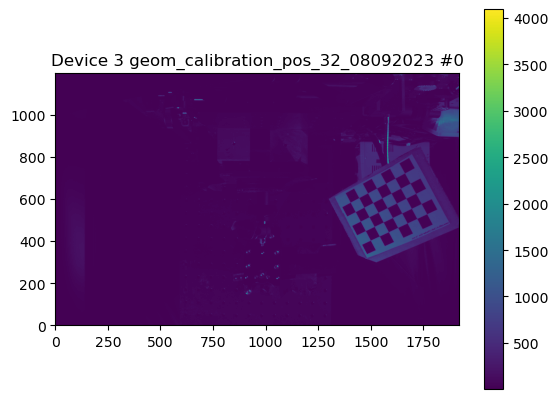

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


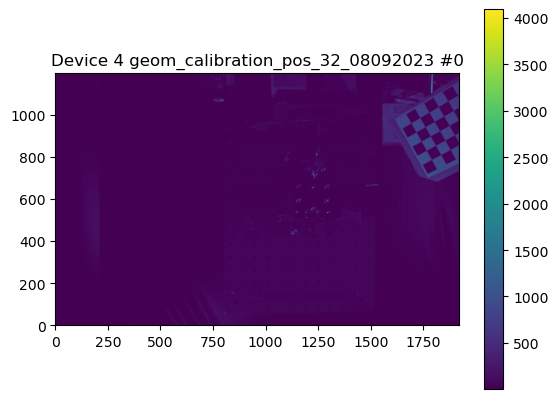

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


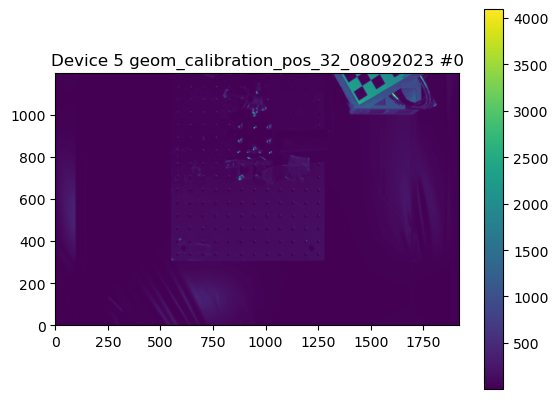

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


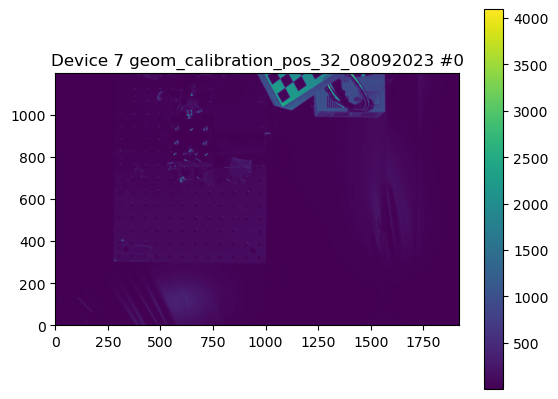

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


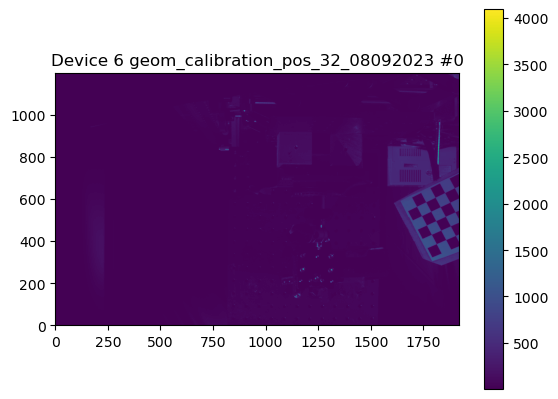

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_32_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_32_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

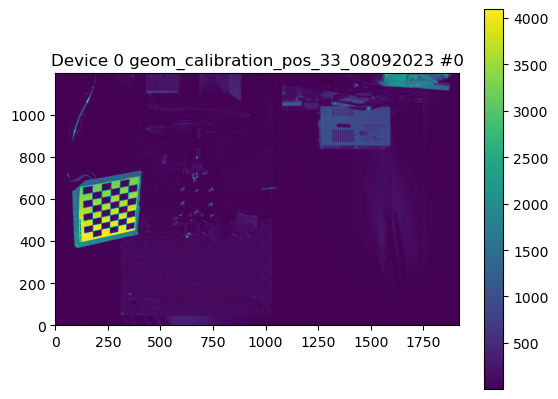

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


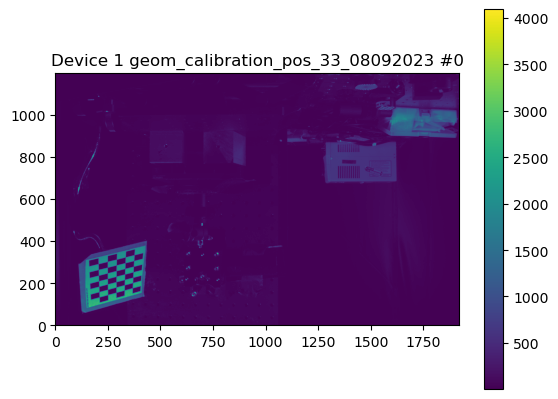

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


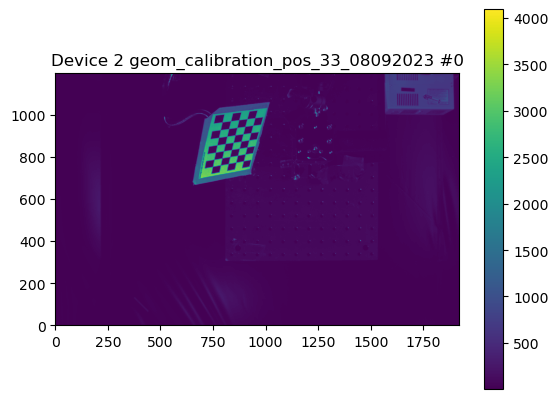

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


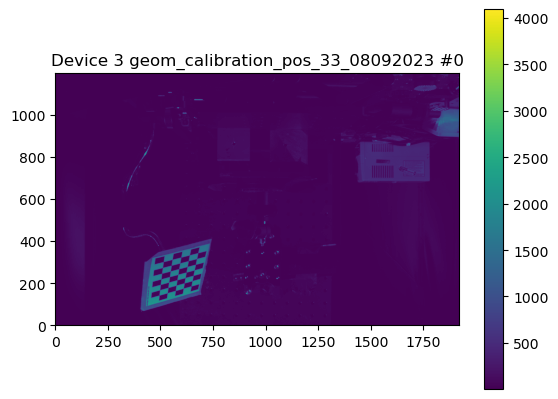

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


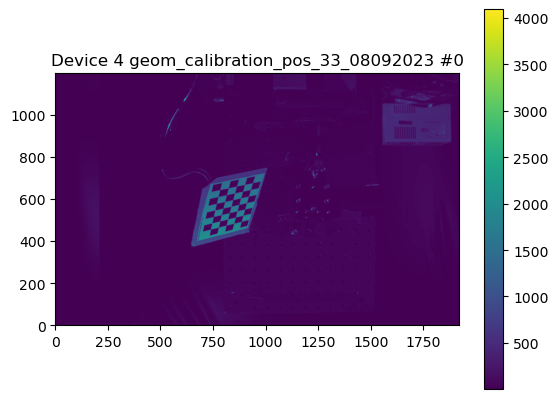

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


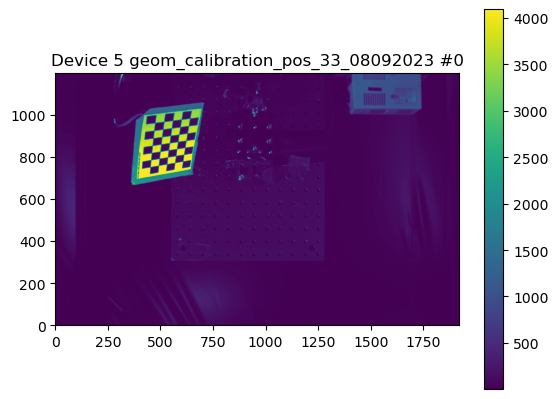

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


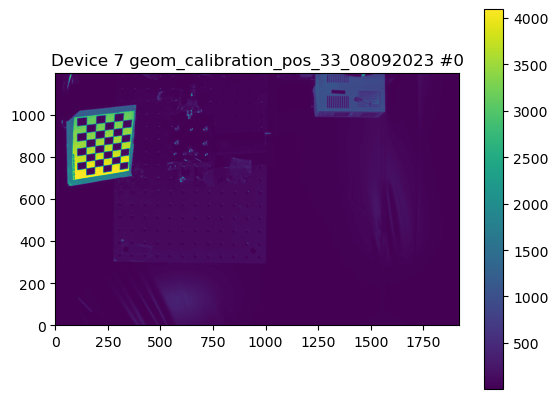

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


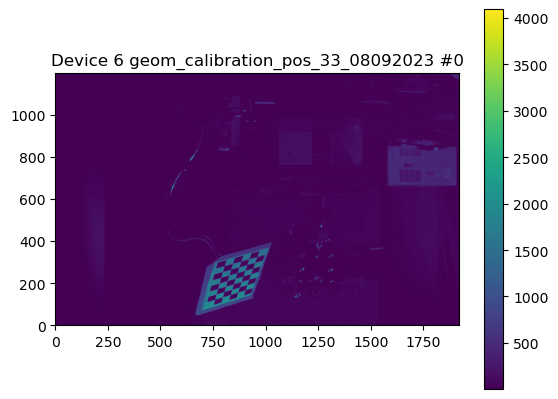

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_33_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_33_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

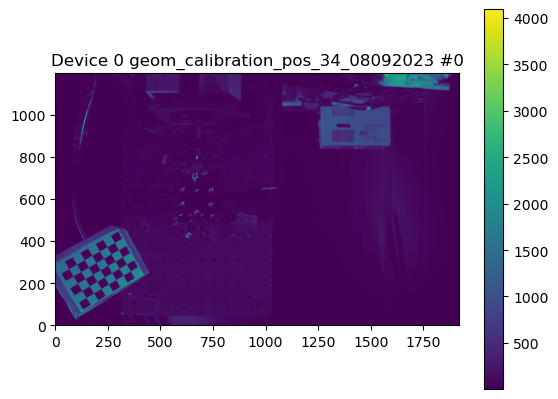

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


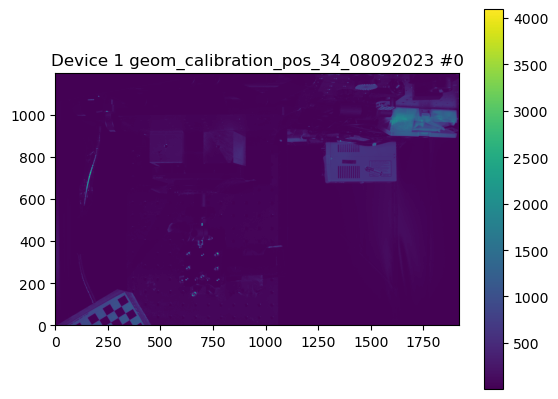

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


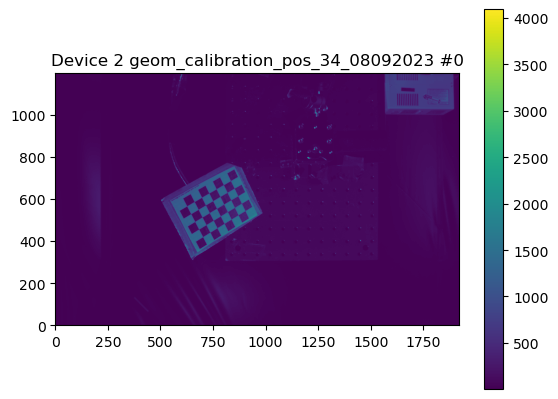

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


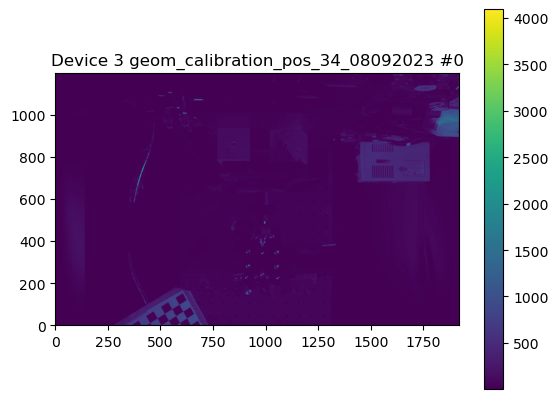

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


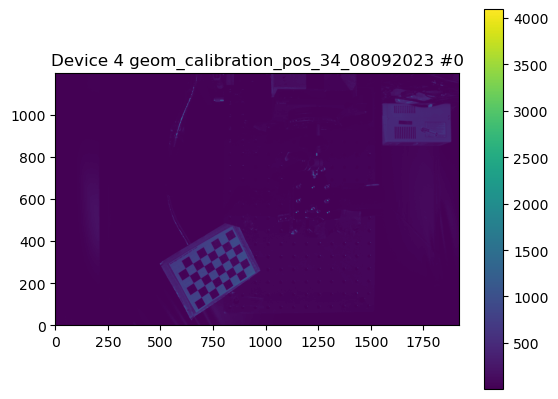

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


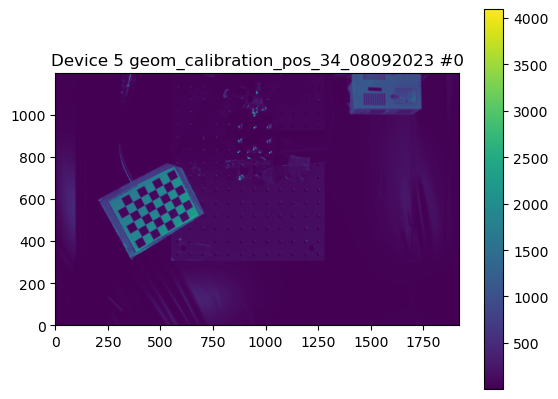

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


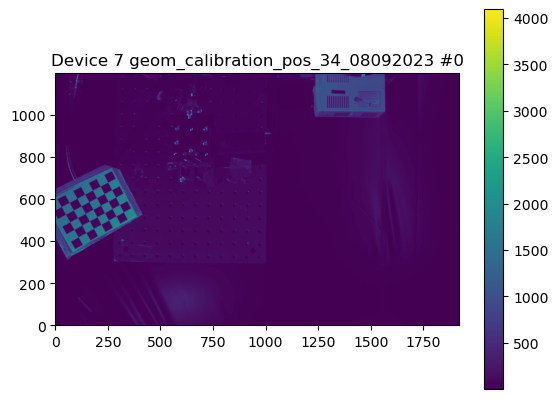

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


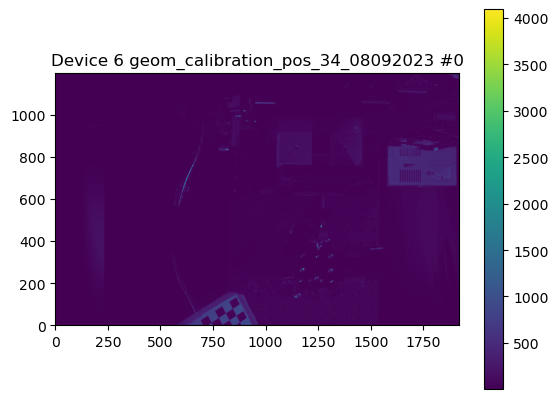

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_34_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_34_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

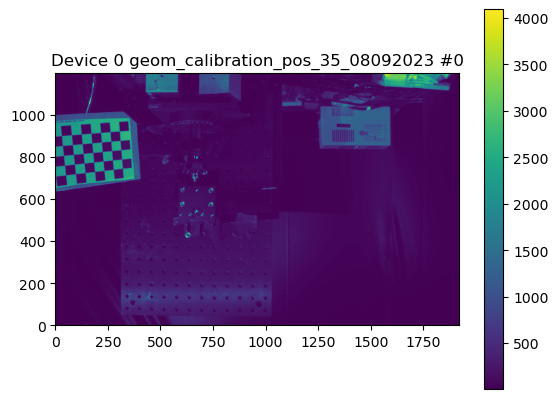

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


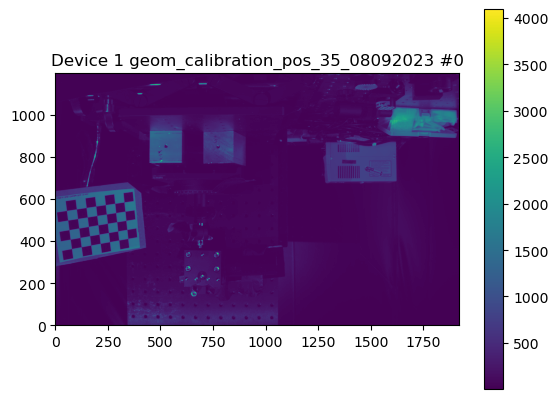

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


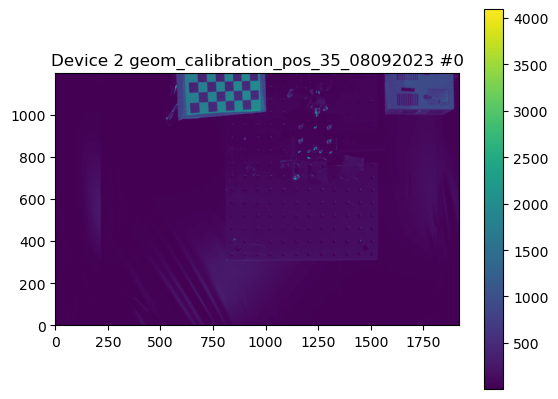

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


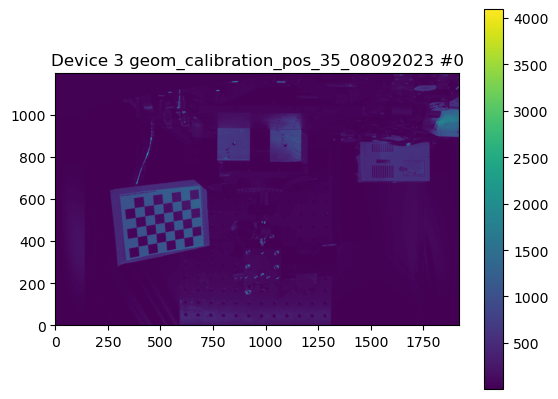

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


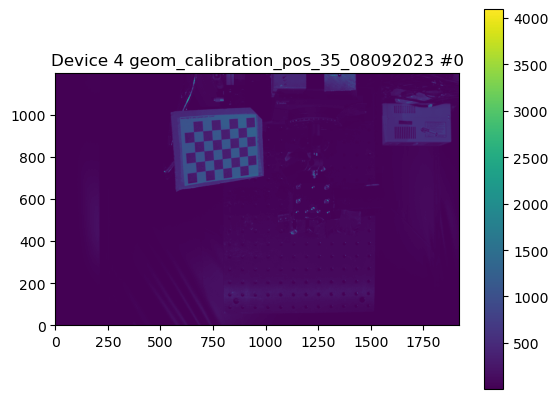

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


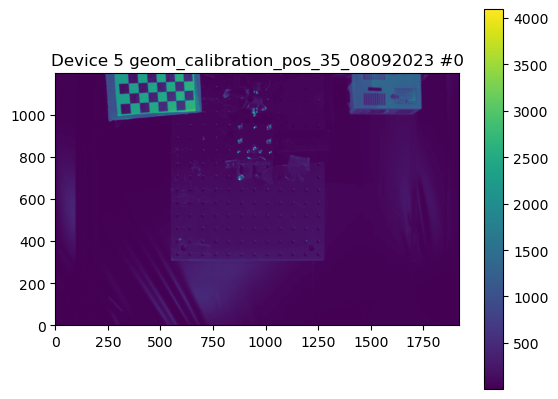

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


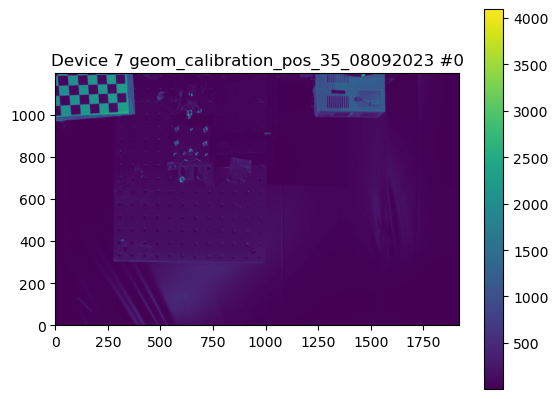

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


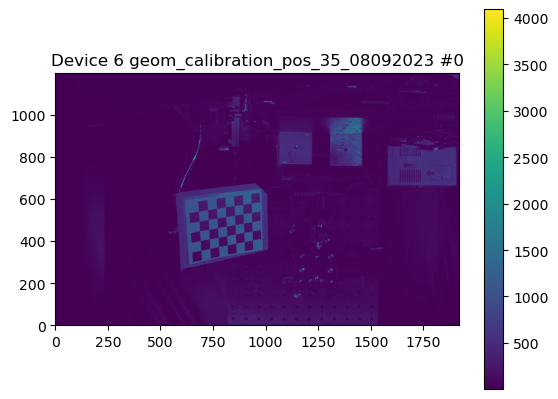

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_pos_35_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_pos_35_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 F

In [6]:
for i in range(n_positions):
    # prompt to set up new position
    osc.prepare_geometric_calibration(cameras[0].ic)
    # check image exposure
    osc.capture_channel_images(
        cameras, 
        chkbd_exposures, 
        subject=f'geom_calibration_pos_{i}_'+date, 
        repeats=1,
        roi=False, 
        show_img=True,
        save_img=False)    
    # pause, prompt to begin repeat image capture
    osc.prepare_geometric_calibration(cameras[0].ic)
    osc.capture_channel_images(
        cameras, 
        chkbd_exposures, 
        subject=f'geom_calibration_pos_{i}_'+date, 
        repeats=n_repeats,
        roi=False, 
        show_img=False,
        save_img=True)

Capture images of a 3D object now.

-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


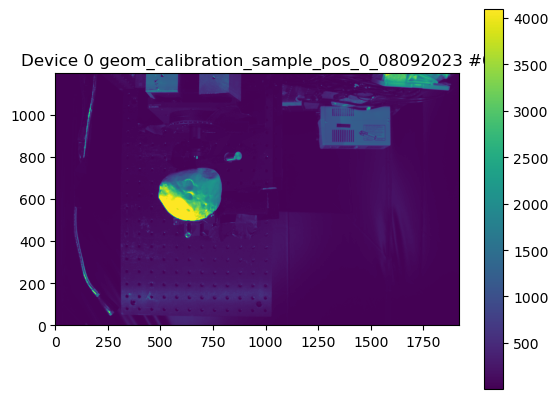

-----------------------------------
-----------------------------------
Device 1
-----------------------------------
Imaging with Exposure: 0.4964990019798279 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.4964990019798279 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


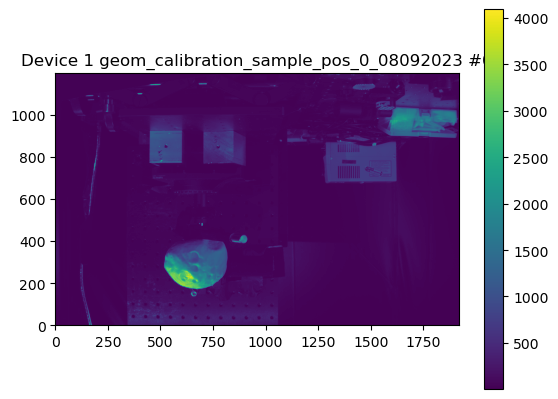

-----------------------------------
-----------------------------------
Device 2
-----------------------------------
Imaging with Exposure: 0.5271170139312744 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.5271170139312744 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


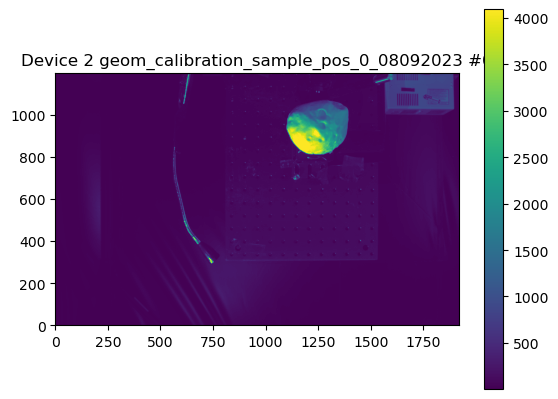

-----------------------------------
-----------------------------------
Device 3
-----------------------------------
Imaging with Exposure: 0.35274600982666016 s
+Good exposure 0.35274600982666016 Image recieved


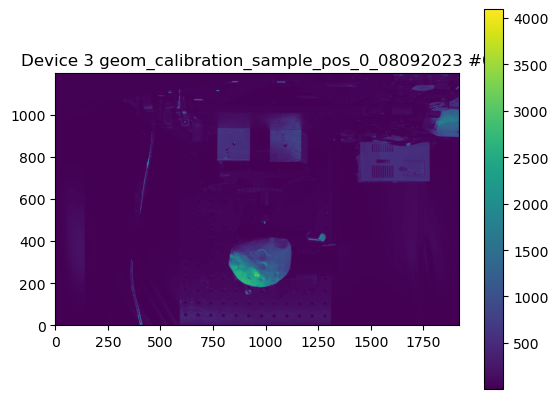

-----------------------------------
-----------------------------------
Device 4
-----------------------------------
Imaging with Exposure: 0.30179300904273987 s
+Good exposure 0.30179300904273987 Image recieved


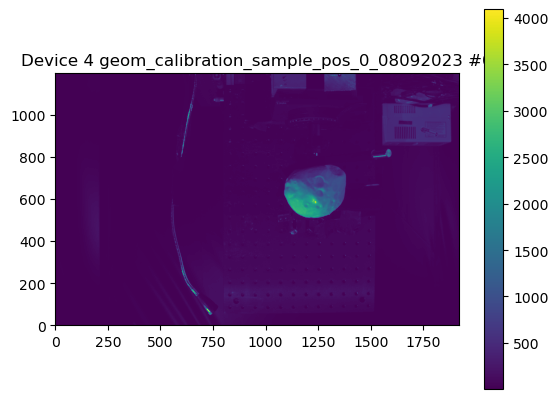

-----------------------------------
-----------------------------------
Device 5
-----------------------------------
Imaging with Exposure: 0.6644120216369629 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6644120216369629 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


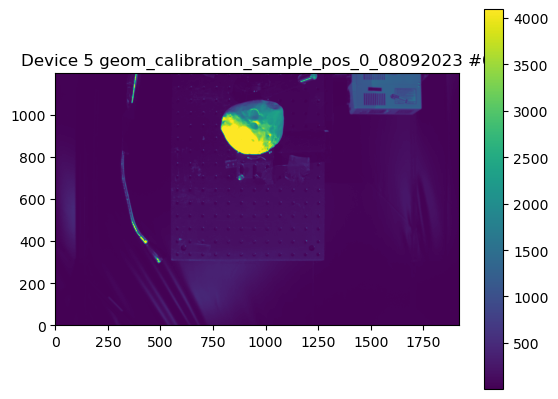

-----------------------------------
-----------------------------------
Device 7
-----------------------------------
Imaging with Exposure: 0.7826510071754456 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.7826510071754456 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS


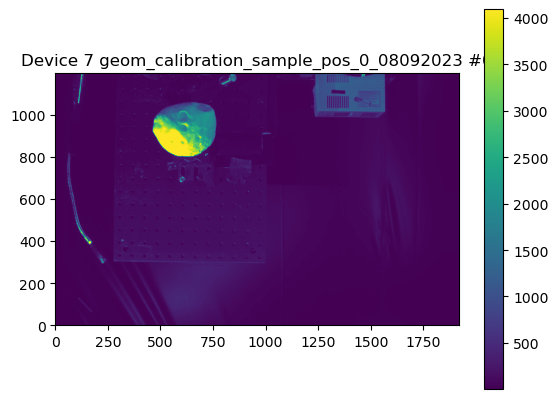

-----------------------------------
-----------------------------------
Device 6
-----------------------------------
Imaging with Exposure: 0.3173240125179291 s
+Good exposure 0.3173240125179291 Image recieved


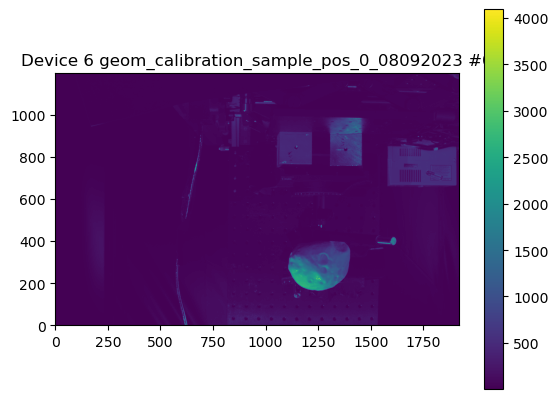

-----------------------------------
-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_sample_pos_0_08092023\0_850\850_0_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_sample_pos_0_08092023\0_850\850_1_img.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate se

KeyboardInterrupt: 

In [7]:
for i in range(n_positions):
    osc.prepare_geometric_calibration(cameras[0].ic)
    osc.capture_channel_images(
        cameras, 
        chkbd_exposures, 
        subject=f'geom_calibration_sample_pos_{i}_'+date, 
        repeats=1,
        roi=False, 
        show_img=True,
        save_img=False)
    osc.prepare_geometric_calibration(cameras[0].ic)
    osc.capture_channel_images(
        cameras, 
        chkbd_exposures, 
        subject=f'geom_calibration_sample_pos_{i}_'+date, 
        repeats=n_repeats,
        roi=False, 
        show_img=False,
        save_img=True)

# Dark Frame Capture


In [8]:
osc.capture_channel_images(
    cameras, 
    chkbd_exposures, 
    subject=f'geom_calibration_dark_'+date, 
    img_type='drk',
    repeats=n_repeats,
    roi=False, 
    show_img=False,
    save_img=True)

-----------------------------------
Device 0
-----------------------------------
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: -3
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 0 written to ..\data\geom_calibration_dark_08092023\0_850\850_0_drk.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Image recieved
Setting Frame Rate to : 30.0 FPS
set frame rate err: 1
Frame Rate set to : 33 FPS
Exposure current Value: 0.6927139759063721
Image 1 written to ..\data\geom_calibration_dark_08092023\0_850\850_1_drk.tif
Imaging with Exposure: 0.6927139759063721 s
Setting Frame Rate to : 1.0 FPS
set frame rate err: 1
Frame Rate set to : 977 FPS
+Good exposure 0.6927139759063721 Im